In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
%config InlineBackend.figure_format='retina'

In [2]:
import numpy as np
import pandas as pd
import time
from datetime import datetime
from pymongo import MongoClient
from tqdm import tqdm_notebook as tqdm

from src.config_tickets import ticket_lst
from src.scraping import WebScraping
from src.settings import HOST
from src.query_data import QueryData
from src.utilities import run_model_with_parameters, run_model_without_parameters
from Models.Lstm_geo_hybrid import GBM

from sklearn.metrics import mean_squared_error, mean_absolute_error

import sys

if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

Using TensorFlow backend.


In [3]:
# Display and Plotting
import matplotlib.pylab as plt
import seaborn as sns

from ipywidgets import interactive, widgets, RadioButtons, ToggleButton, Select, FloatSlider, FloatRangeSlider, IntSlider, fixed

pd.set_option('display.float_format', lambda x: '%.5f' % x) # pandas
np.set_printoptions(precision=5, suppress=True) # numpy

pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 100)

# seaborn plotting style
sns.set(style='ticks', context='poster')

In [4]:
def connect_2_dbServer():
    mongoClient = MongoClient(HOST)
    return mongoClient

In [5]:
client = connect_2_dbServer()
query = QueryData(client)

In [6]:
lst_ticket = query.get_list_ticket(index='VN 30 (VNI30)')
print(lst_ticket)
print(len(lst_ticket))

['Cotec Construction JSC', 'DHG Pharmaceutical JSC', 'Faros Construction Corp', 'FPT Corp', 'Gemadept Corp', 'Ho Chi Minh City Infrastructure Investment JSC', 'Ho Chi Minh City Development Joint Stock Commercial Bank', 'Hoa Phat Group JSC', 'Masan Group Corp', 'Military Commercial Joint Stock Bank', 'Mobile World Investment Corp', 'No Va Land Investment Group Corp', 'PetroVietnam Fertilizer and Chemicals Corp', 'Phu Nhuan Jewelry JSC', 'Refrigeration Electrical Engineering Corp', 'Sai Gon Thuong Tin Commercial Joint Stock Bank', 'Saigon Beer Alcohol Beverage Corp', 'Saigon Securities Incorporation', 'Vietnam Technological And Commercial Joint Stock Bank', 'Thanh Thanh Cong Tay Ninh JSC', 'Joint Stock Commercial Bank for Foreign Trade of Vietnam', 'Vietjet Aviation JSC', 'Vietnam Export Import Commercial Joint Stock Bank', 'Vietnam JSCmmercial Bank for Industry and Trade', 'Vietnam Prosperity Joint Stock Commercial Bank', 'Vietnam Dairy Products JSC', 'Vincom Retail JSC', 'Vingroup JSC'

['Cotec Construction JSC', 'DHG Pharmaceutical JSC', 'Faros Construction Corp', 'FPT Corp', 'Gemadept Corp']


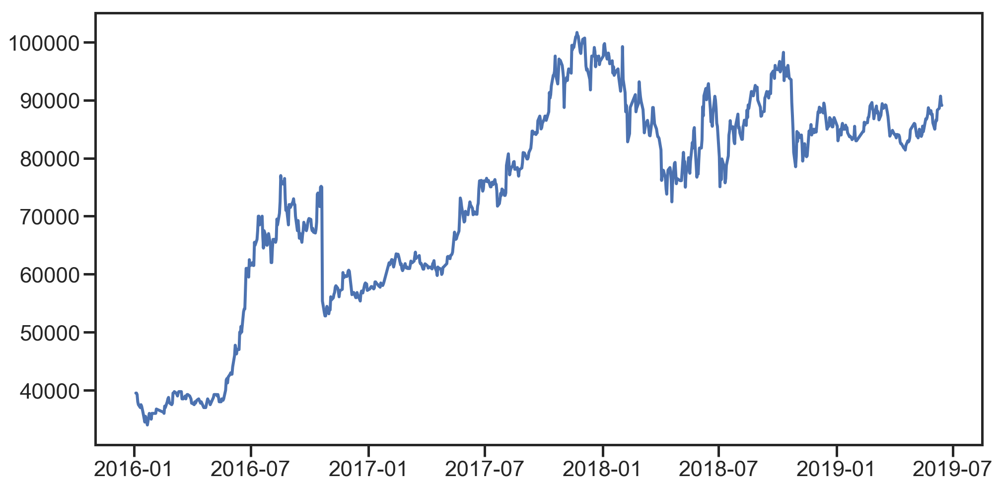

In [7]:
start = datetime(2016,1,1)
end = datetime(2019,6,14)

print(lst_ticket[:5])

df = query.get_historical_data(lst_ticket, start=start, end=end)
closed_price = dict()
for ticket in lst_ticket[3:10]:
    closed_price[ticket] = df[df.name == ticket]['close']

    
df.to_csv('historical_data.csv')
    
series = df[df.name == 'Mobile World Investment Corp']['close']
plt.figure(figsize=(16,8))
plt.plot(series)
plt.show()

In [9]:
print(len(lst_ticket))
for ticket in lst_ticket:
    closed_price[ticket] = df[df.name == ticket]['close']
    print(ticket,':',len(closed_price[ticket]))

30
Cotec Construction JSC : 858
DHG Pharmaceutical JSC : 858
Faros Construction Corp : 692
FPT Corp : 858
Gemadept Corp : 858
Ho Chi Minh City Infrastructure Investment JSC : 858
Ho Chi Minh City Development Joint Stock Commercial Bank : 353
Hoa Phat Group JSC : 858
Masan Group Corp : 858
Military Commercial Joint Stock Bank : 858
Mobile World Investment Corp : 858
No Va Land Investment Group Corp : 609
PetroVietnam Fertilizer and Chemicals Corp : 858
Phu Nhuan Jewelry JSC : 858
Refrigeration Electrical Engineering Corp : 858
Sai Gon Thuong Tin Commercial Joint Stock Bank : 858
Saigon Beer Alcohol Beverage Corp : 625
Saigon Securities Incorporation : 858
Vietnam Technological And Commercial Joint Stock Bank : 257
Thanh Thanh Cong Tay Ninh JSC : 858
Joint Stock Commercial Bank for Foreign Trade of Vietnam : 858
Vietjet Aviation JSC : 571
Vietnam Export Import Commercial Joint Stock Bank : 858
Vietnam JSCmmercial Bank for Industry and Trade : 858
Vietnam Prosperity Joint Stock Commercial

## Plot ACF and PACF

In [8]:
from statsmodels.tsa.stattools import pacf, acf

def calculate_acf(time_series, lag=20, alpha=0.01):
    x = time_series.values
    acf_value, confint = acf(x, nlags=lag, alpha=alpha)
    confint_lower = confint[:, 0] - acf_value
    confint_upper = confint[:, 1] - acf_value
    return acf_value, confint_upper, confint_lower


def calculate_pacf(time_series, lag=20, alpha=0.01):
    x = time_series.values
    pacf_value, confint = pacf(x, nlags=lag, alpha=alpha)
    confint_lower = confint[:, 0] - pacf_value
    confint_upper = confint[:, 1] - pacf_value
    return pacf_value, confint_upper, confint_lower

def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


def root_mean_squared_error(y_true, y_pred):
    return np.sqrt(np.mean((y_true - y_pred) ** 2))

def evaluation(validation):
    mse = mean_squared_error(validation['y'], validation['yhat'])
    rmse = root_mean_squared_error(validation['y'], validation['yhat'])
    mae = mean_absolute_error(validation['y'], validation['yhat'])
    mape = mean_absolute_percentage_error(validation['y'], validation['yhat'])
    result = {
        'mse': mse,
        'rmse': rmse,
        'mae': mae,
        'mape': mape,
    }
    return result

start_train = 0.8
end_train = 0.95

## Run model

### ARIMA model

In [9]:
# for ticket in lst_ticket[5:6]:
#     time_series = df[df.name == ticket]['close']
#     # split data
#     time_series = time_series.sort_index()
#     size = len(time_series)
#     train_start = int(start_train * size)
#     train_end = int(end_train * size)
#     train, test = time_series[train_start:train_end], time_series[train_end:]
    
#     result = run_model_with_parameters(train, test, model_selection='ARIMA', order=(1, 1, 2))
#     if result['status']:
#         validation = result['model'].validate(test)
#         time.sleep(1)
#         print(ticket)
#         print('Training result:', result['train_evaluation'])
#         print('Testing result:', result['test_evaluation'])
#         fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
#         ax1.plot(train, label='in-sample', color='r', linestyle='-')
#         ax1.plot(test, label='held-out', color='g', linestyle='--')
#         ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
#     #     ax1.plot(df_ann_validation['yhat'], label='validation held-out', color='purple', linestyle='--')
#         plt.show()
#     else:
#         print('None')

### ANN model

In [10]:
# for ticket in lst_ticket[3:4]:
#     time_series = df[df.name == ticket]['close']
    
#     # split data
#     time_series = time_series.sort_index()
#     size = len(time_series)
#     train_start = int(start_train * size)
#     train_end = int(end_train * size)
#     train, test = time_series[train_start:train_end], time_series[train_end:]
    
#     result = run_model_with_parameters(train, test, model_selection='ANN', lag=1, hidden_layers=(3,1))
#     if result['status']:
#         validation = result['model'].validate(test)
#         time.sleep(1)
#         print(ticket)
#         print('Training result:', result['train_evaluation'])
#         print('Testing result:', result['test_evaluation'])
#         fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
#         ax1.plot(train, label='in-sample', color='r', linestyle='-')
#         ax1.plot(test, label='held-out', color='g', linestyle='--')
#         ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
#     #     ax1.plot(df_ann_validation['yhat'], label='validation held-out', color='purple', linestyle='--')
#         plt.show()
#     else:
#         print('None')

### Hybrid model

In [11]:
# for ticket in lst_ticket[3:4]:
#     time_series = df[df.name == ticket]['close']
    
#     # split data
#     time_series = time_series.sort_index()
#     size = len(time_series)
#     train_start = int(start_train * size)
#     train_end = int(end_train * size)
#     train, test = time_series[train_start:train_end], time_series[train_end:]
    
#     result = run_model_with_parameters(train, test, model_selection='Hybrid', order=(1, 1, 0), lag=2, hidden_layers=(6, 3))
#     if result['status']:
#         validation = result['model'].validate(test)
#         time.sleep(1)
#         print(ticket)
#         print('Training result:', result['train_evaluation'])
#         print('Testing result:', result['test_evaluation'])
#         fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
#         ax1.plot(train, label='in-sample', color='r', linestyle='-')
#         ax1.plot(test, label='held-out', color='g', linestyle='--')
#         ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
#     #     ax1.plot(df_ann_validation['yhat'], label='validation held-out', color='purple', linestyle='--')
#         plt.show()
#     else:
#         print('None')

### Run model without parameters

Cotec Construction JSC
Testing result: {'mse': 8805182.40780914, 'rmse': 2967.3527609317266, 'mae': 2059.315153033299, 'mape': 1.5795388003092665}


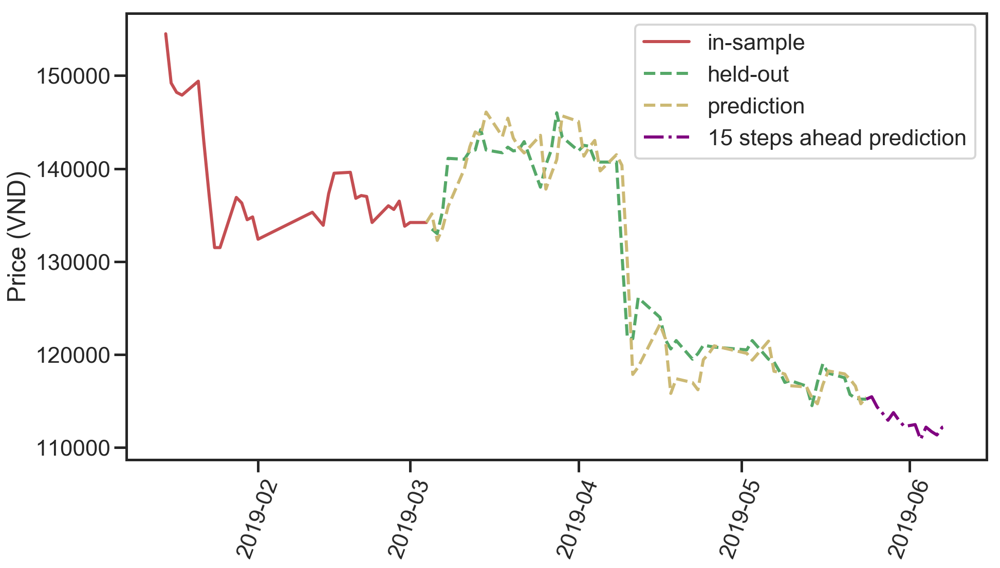

DHG Pharmaceutical JSC
Testing result: {'mse': 2303928.728833214, 'rmse': 1517.8697996973303, 'mae': 1168.4615788030871, 'mape': 1.0050105539575476}


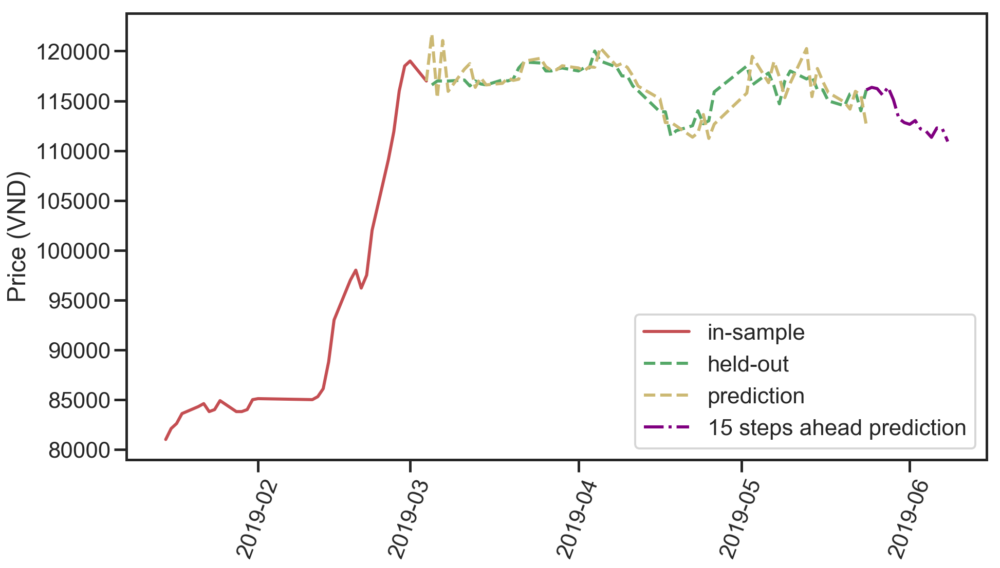

Faros Construction Corp
Testing result: {'mse': 972797.4794383076, 'rmse': 986.3049626957717, 'mae': 634.2940931019926, 'mape': 1.9808429263422804}


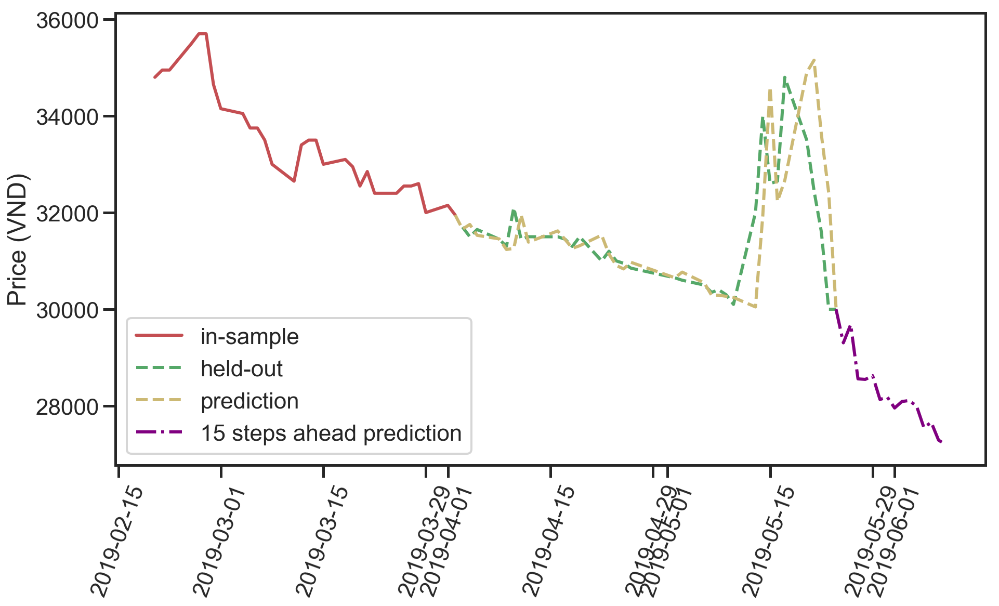

FPT Corp
Testing result: {'mse': 324412.861430839, 'rmse': 569.5725251720268, 'mae': 441.69471253003854, 'mape': 1.0358103027029815}


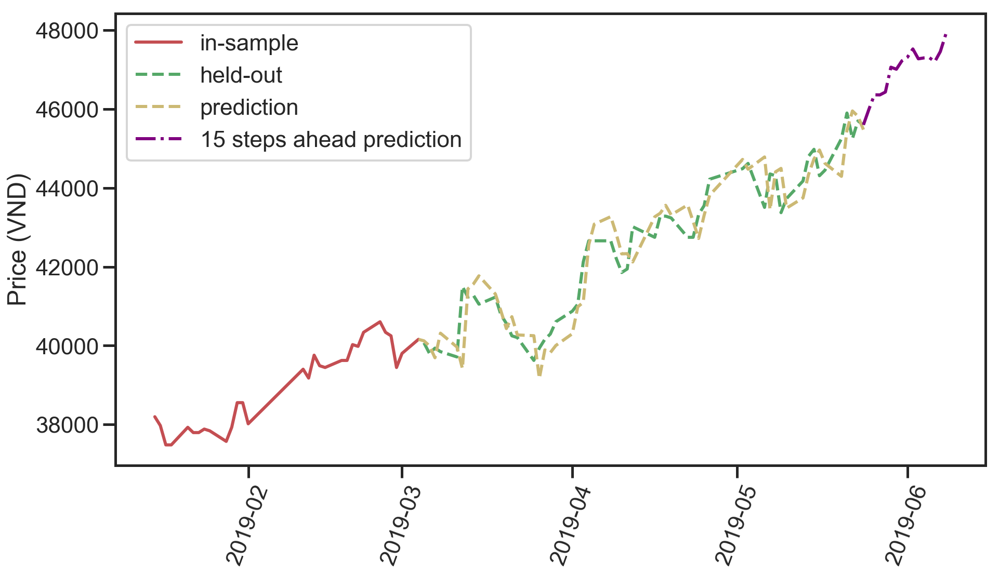

Gemadept Corp
Testing result: {'mse': 132836.52596631987, 'rmse': 364.46745529103123, 'mae': 292.39436384311796, 'mape': 1.0948578425684152}


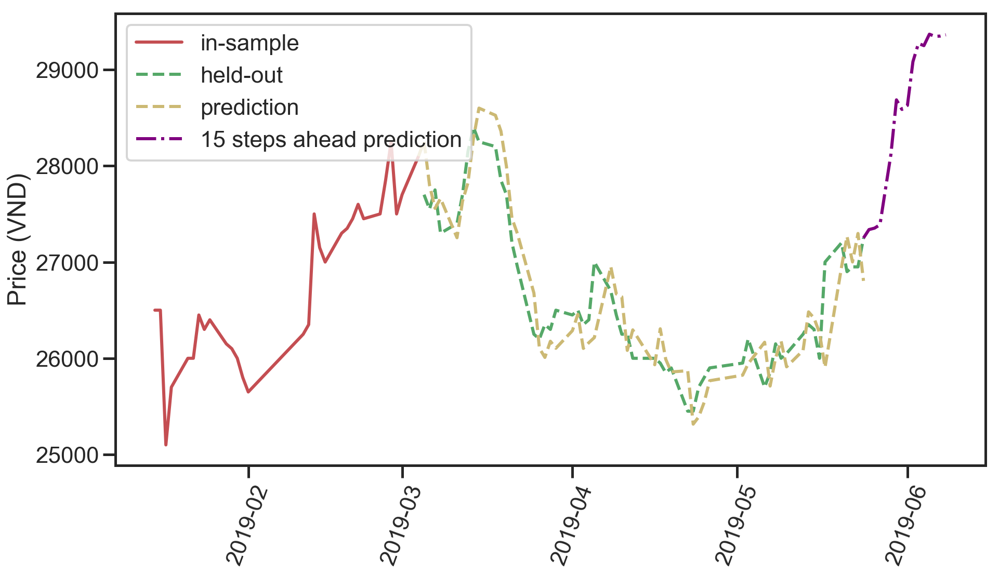

Ho Chi Minh City Infrastructure Investment JSC
Testing result: {'mse': 243535.19724009745, 'rmse': 493.49285429486963, 'mae': 367.3053799701589, 'mape': 1.537407355066074}


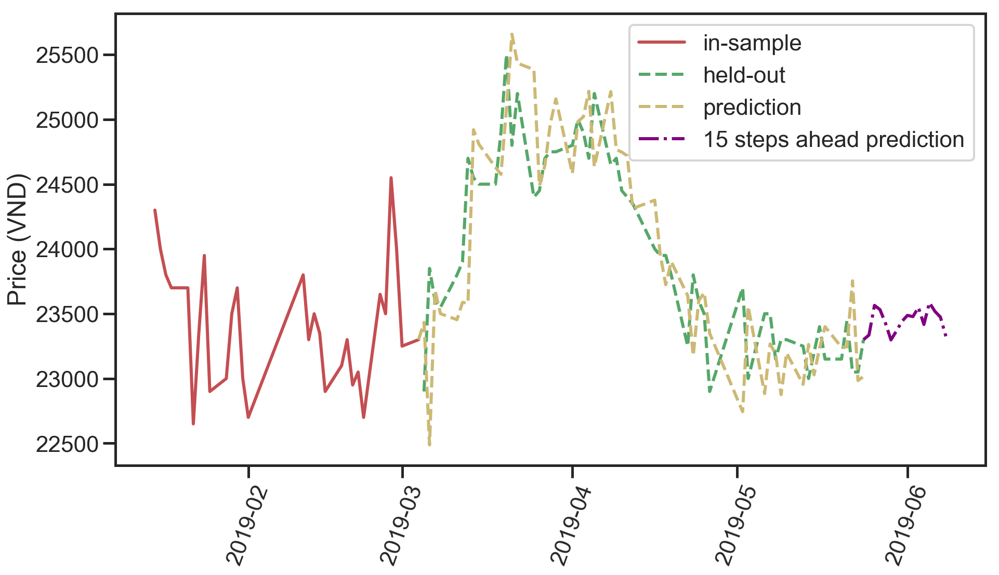

Ho Chi Minh City Development Joint Stock Commercial Bank
Testing result: {'mse': 199599.72348802566, 'rmse': 446.7658486142665, 'mae': 344.8609493289116, 'mape': 1.2806845598772458}


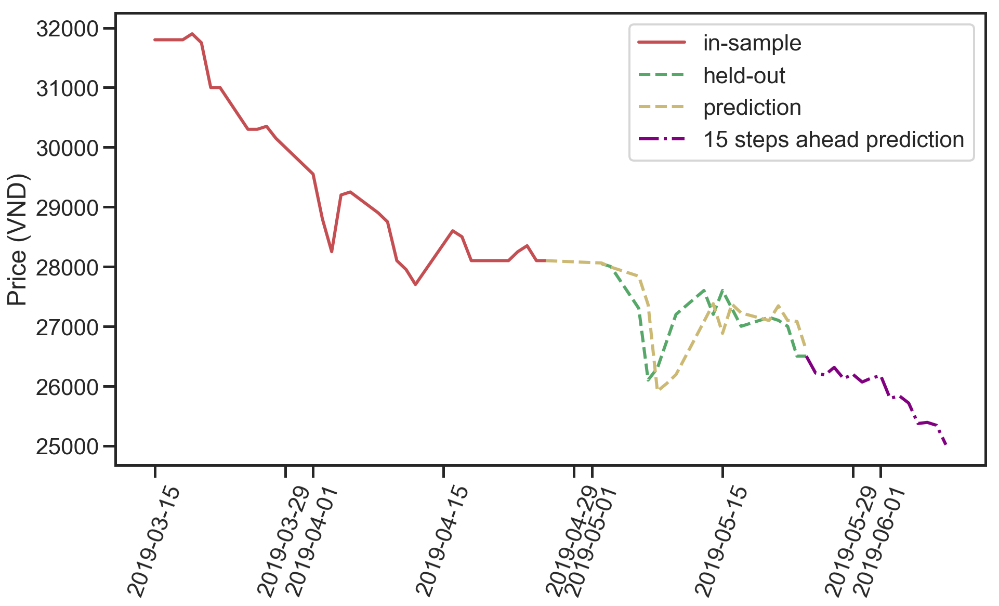

Hoa Phat Group JSC
Testing result: {'mse': 429540.40538575815, 'rmse': 655.393321133011, 'mae': 455.5620415422672, 'mape': 1.3859320625909661}


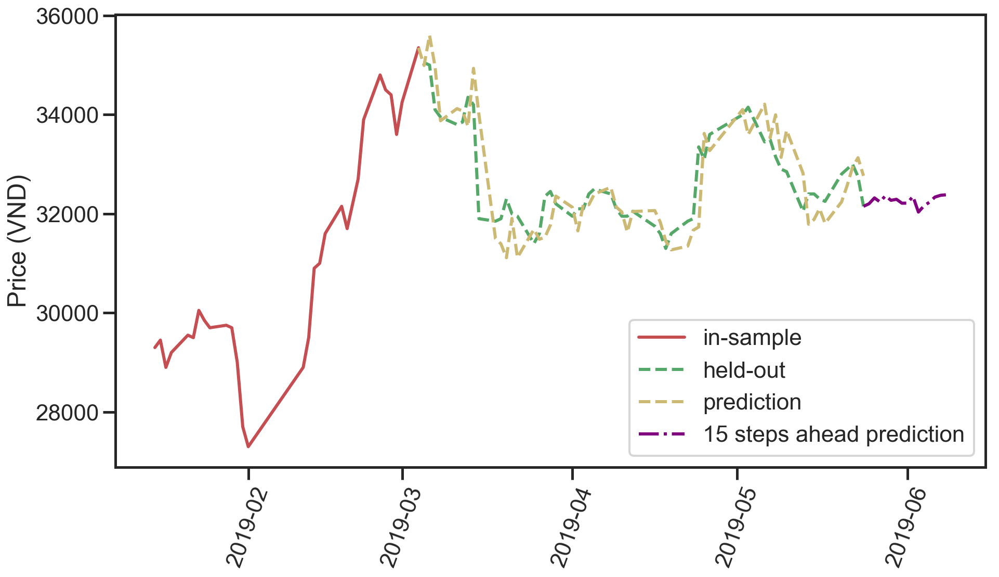

Masan Group Corp
Testing result: {'mse': 1690936.4616039074, 'rmse': 1300.3601276584527, 'mae': 940.4274551892495, 'mape': 1.0766804855862997}


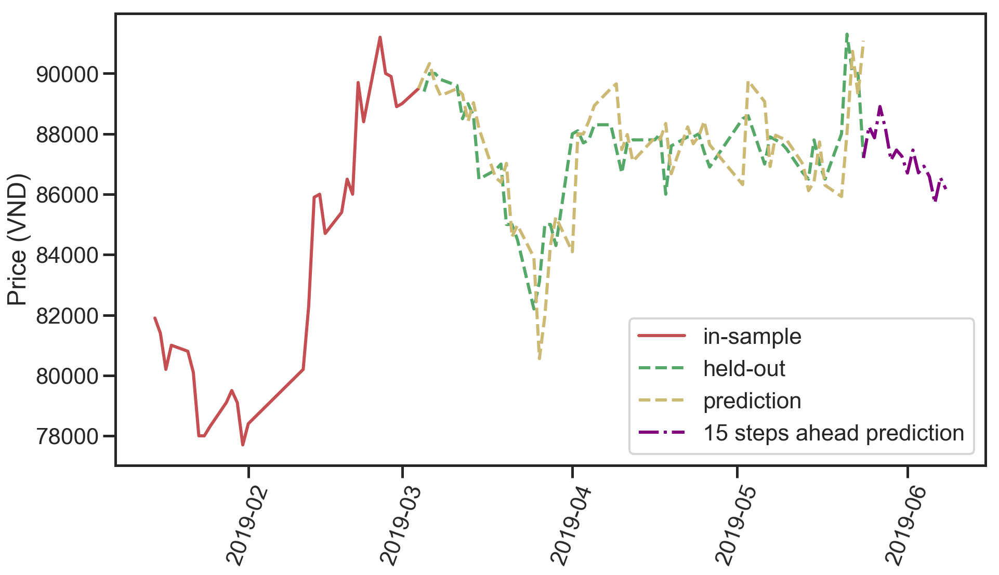

Military Commercial Joint Stock Bank
Testing result: {'mse': 124187.66107696493, 'rmse': 352.4026973179475, 'mae': 249.38127745977036, 'mape': 1.140803138447577}


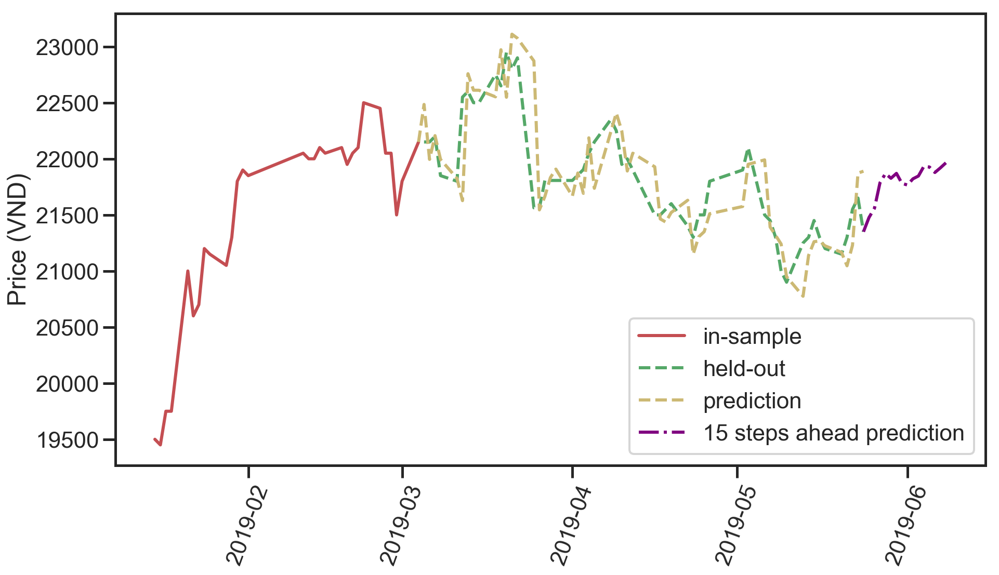

Mobile World Investment Corp
Testing result: {'mse': 1239979.8999607475, 'rmse': 1113.5438473453785, 'mae': 853.2940261836952, 'mape': 1.0037851658548624}


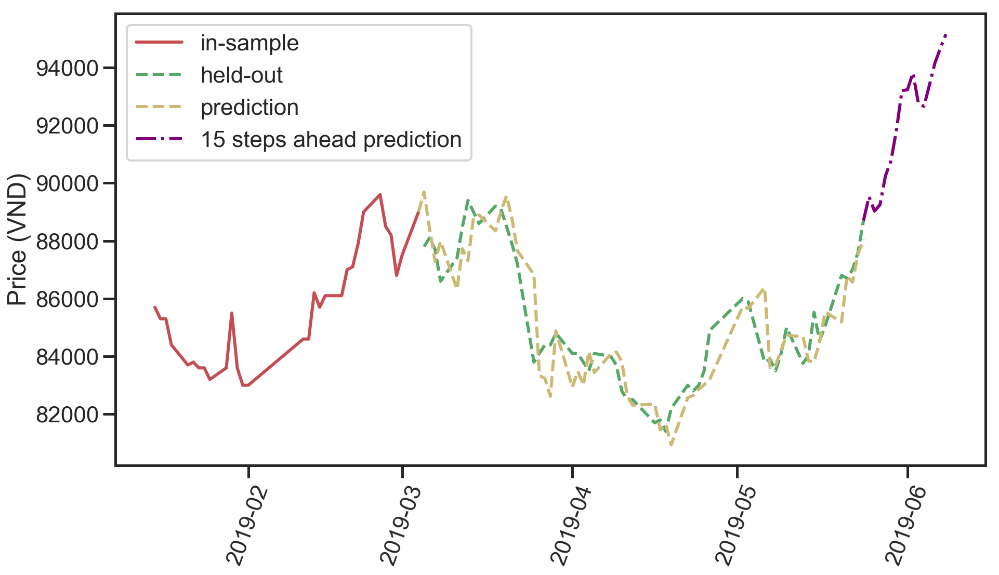

No Va Land Investment Group Corp
Testing result: {'mse': 548072.0558181, 'rmse': 740.318887924724, 'mae': 588.2227630913978, 'mape': 1.0141740298028283}


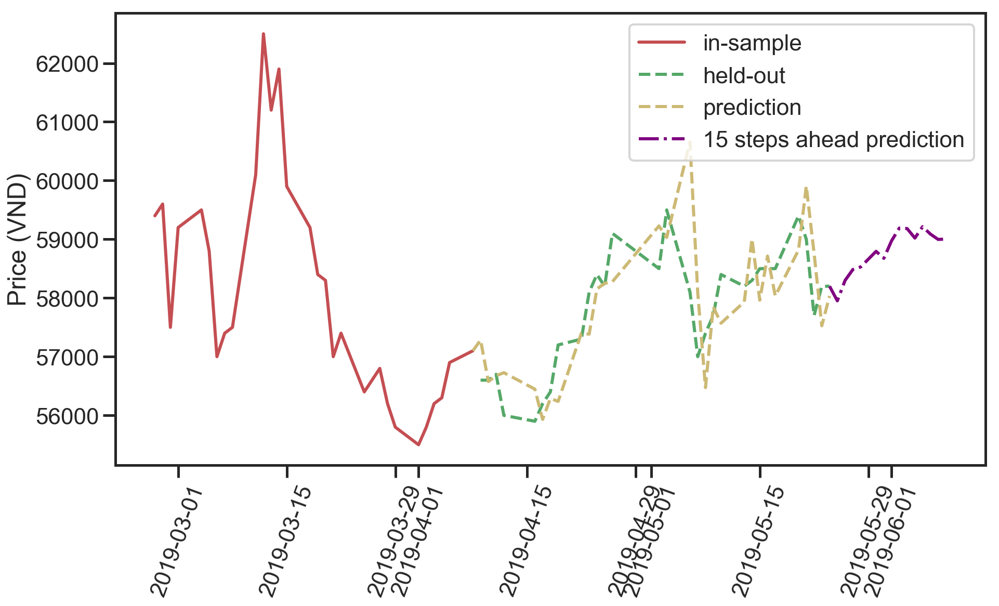

PetroVietnam Fertilizer and Chemicals Corp
Testing result: {'mse': 110923.11836483286, 'rmse': 333.05122483610967, 'mae': 271.48177674934766, 'mape': 1.450735697087859}


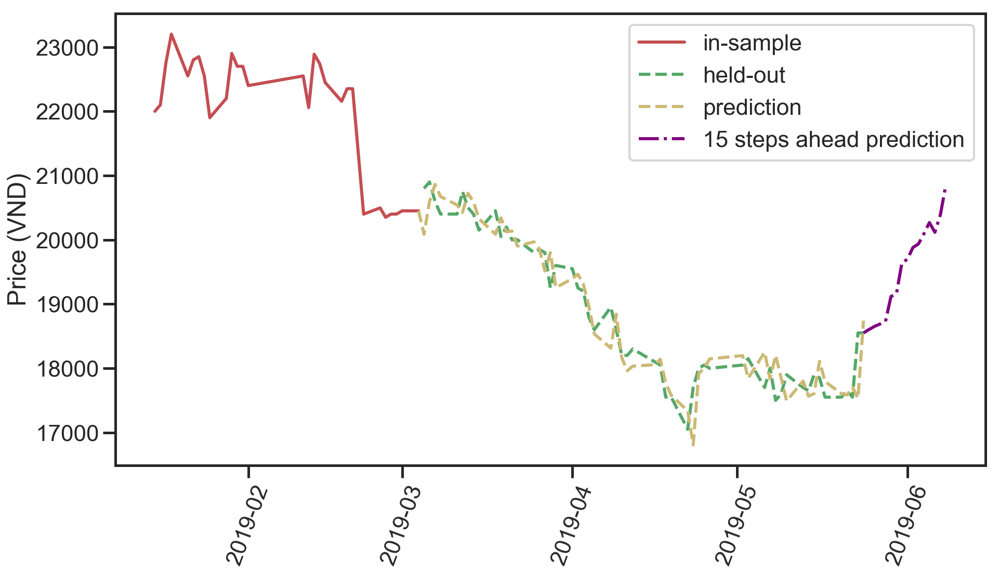

Phu Nhuan Jewelry JSC
Testing result: {'mse': 2924190.4419665216, 'rmse': 1710.0264448149687, 'mae': 1223.6600364572582, 'mape': 1.19645736174305}


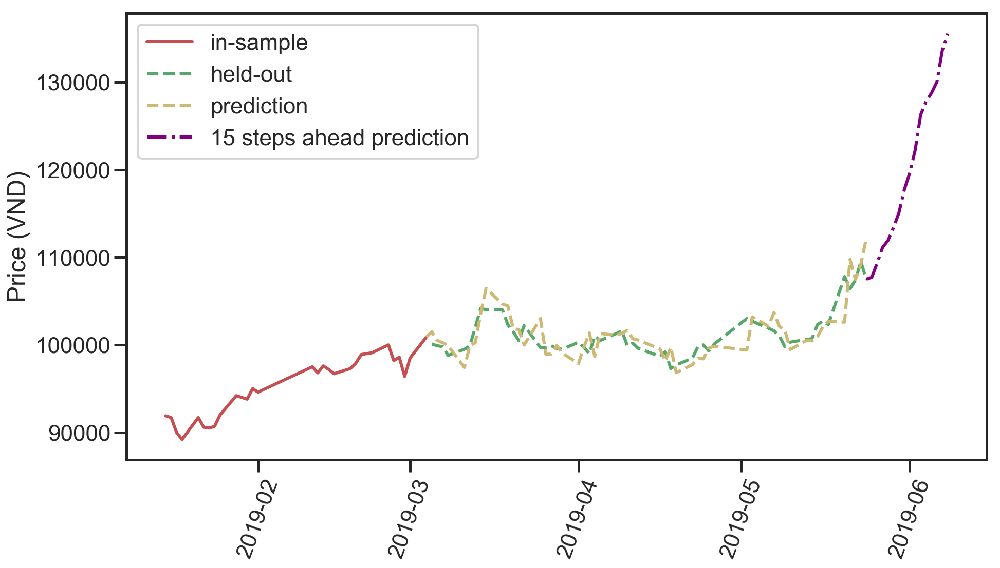

Refrigeration Electrical Engineering Corp
Testing result: {'mse': 265064.3046532499, 'rmse': 514.843961461383, 'mae': 410.14126716532894, 'mape': 1.2589385987802708}


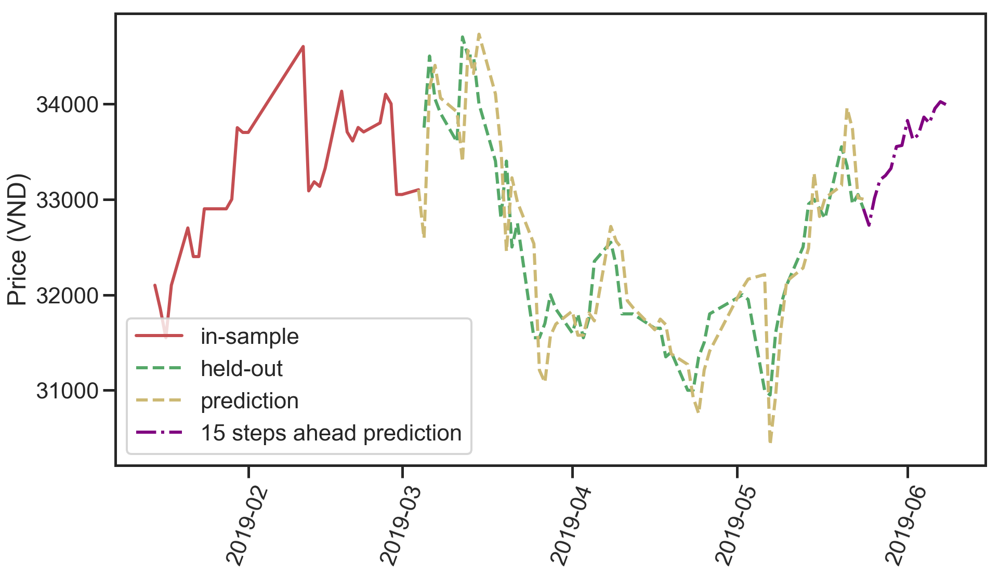

Sai Gon Thuong Tin Commercial Joint Stock Bank
Testing result: {'mse': 31317.456979940078, 'rmse': 176.96738959463713, 'mae': 138.5588699843294, 'mape': 1.1324054982117746}


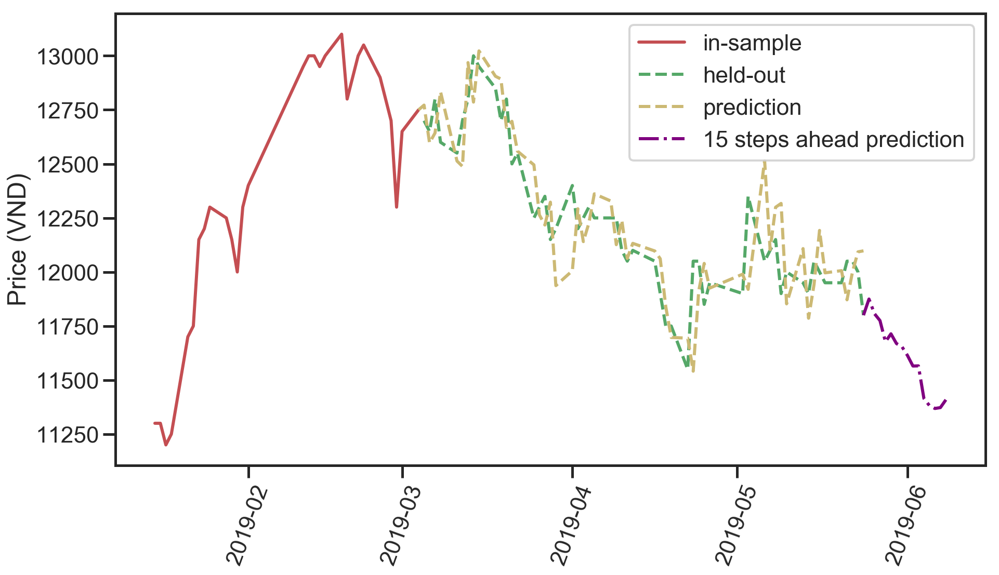

Saigon Beer Alcohol Beverage Corp
Testing result: {'mse': 31410867.88117474, 'rmse': 5604.539934836288, 'mae': 4117.323392624493, 'mape': 1.676242566286446}


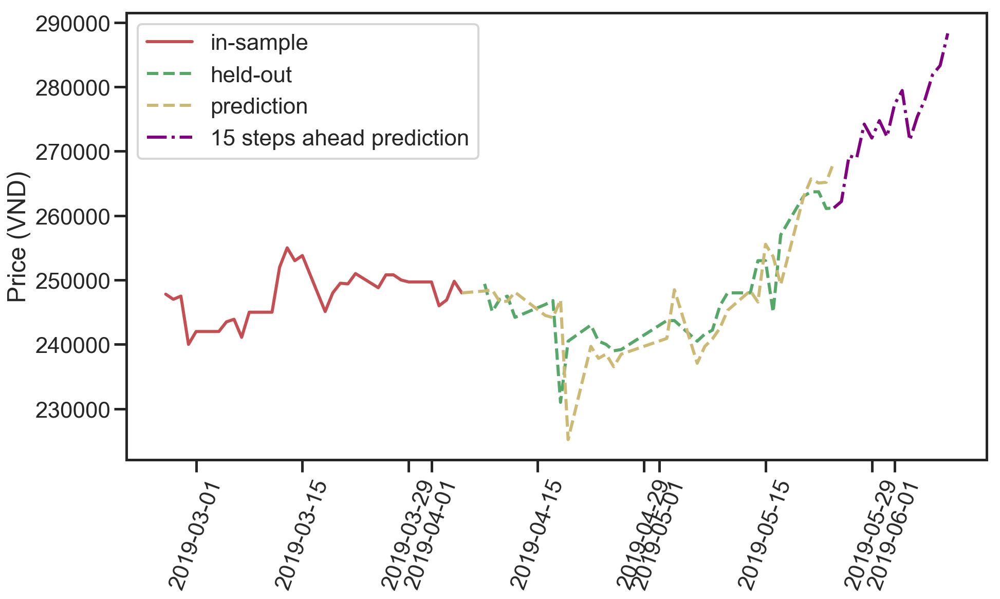

Saigon Securities Incorporation
Testing result: {'mse': 176928.54259595758, 'rmse': 420.628746754139, 'mae': 339.706790180629, 'mape': 1.2719472151875315}


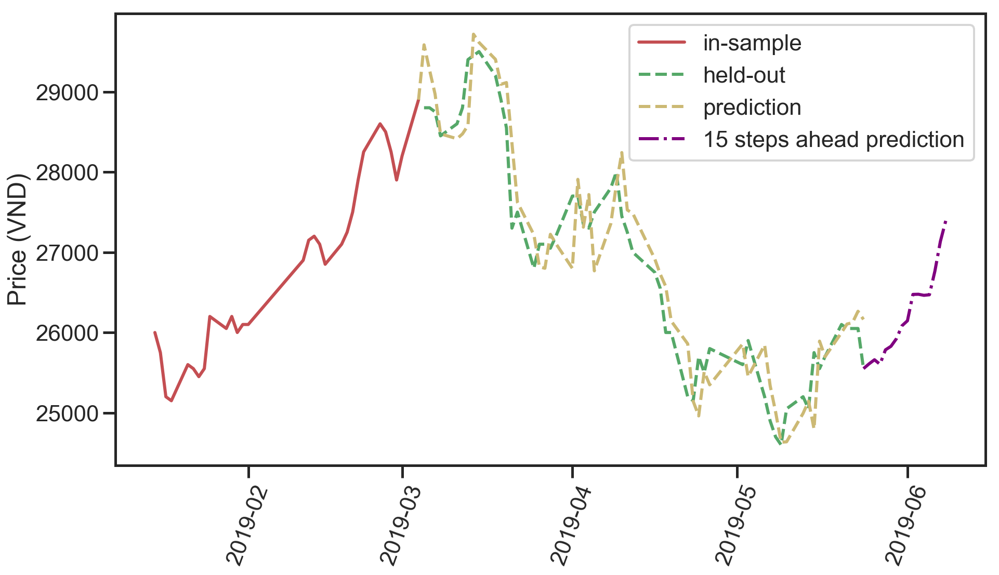

Vietnam Technological And Commercial Joint Stock Bank
Testing result: {'mse': 228220.4487239523, 'rmse': 477.7242392049542, 'mae': 377.6174432379328, 'mape': 1.6078339307269354}


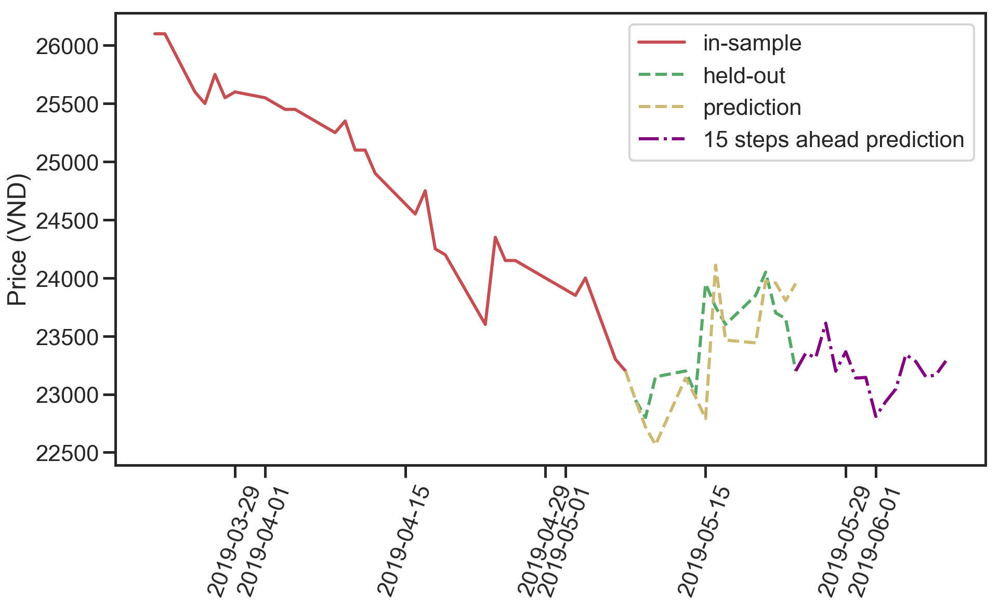

Thanh Thanh Cong Tay Ninh JSC
Testing result: {'mse': 49825.20202974698, 'rmse': 223.21559539993387, 'mae': 167.5745902375664, 'mape': 0.9099494565649935}


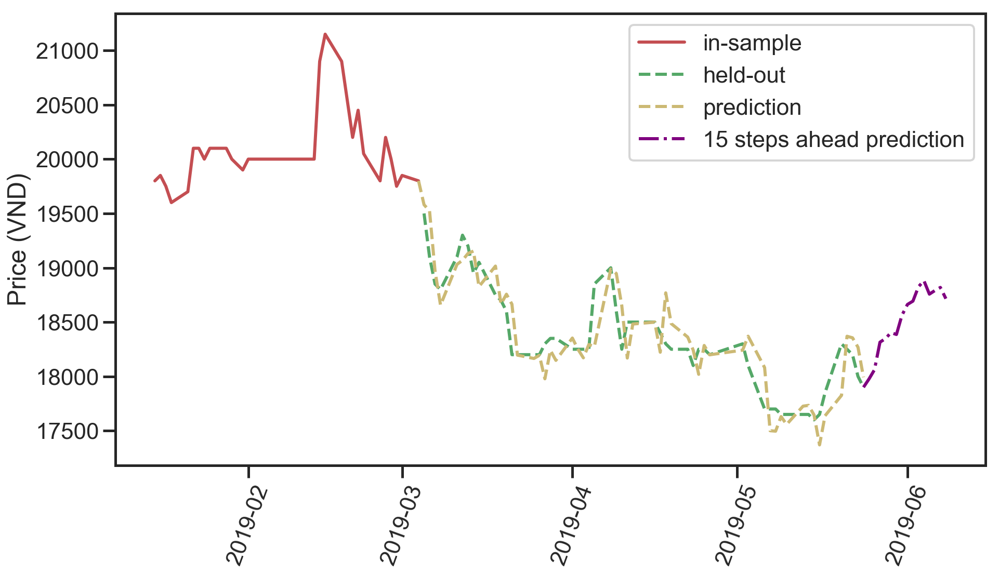

Joint Stock Commercial Bank for Foreign Trade of Vietnam
Testing result: {'mse': 678711.0010891008, 'rmse': 823.8391839971566, 'mae': 606.5177271406344, 'mape': 0.9124751878931839}


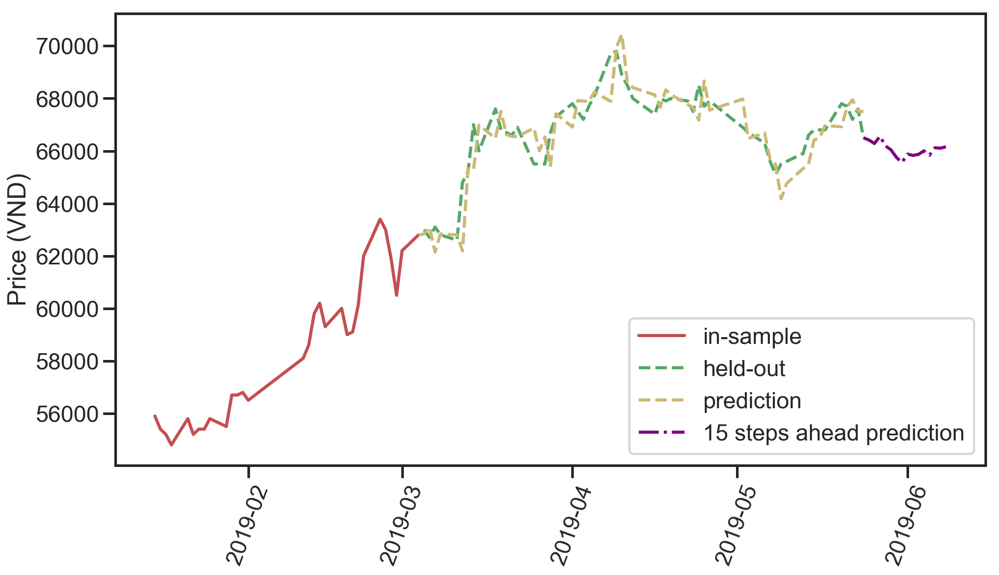

Vietjet Aviation JSC
Testing result: {'mse': 832822.8479927591, 'rmse': 912.5912820056737, 'mae': 763.3310787120162, 'mape': 0.6577258576892572}


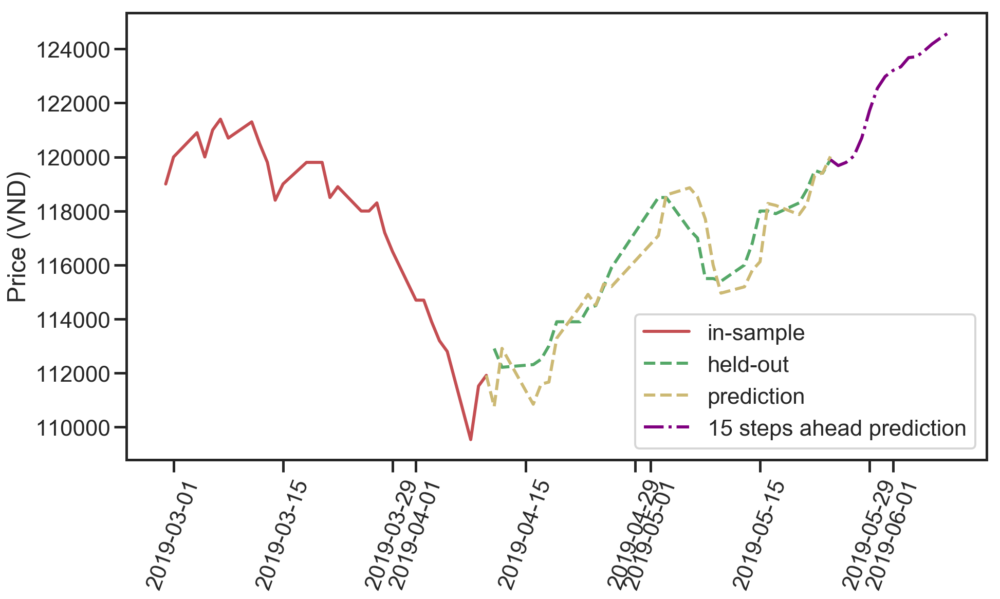

Vietnam Export Import Commercial Joint Stock Bank
Testing result: {'mse': 132848.16513930794, 'rmse': 364.48342231068335, 'mae': 277.1559840657841, 'mape': 1.5759362975904752}


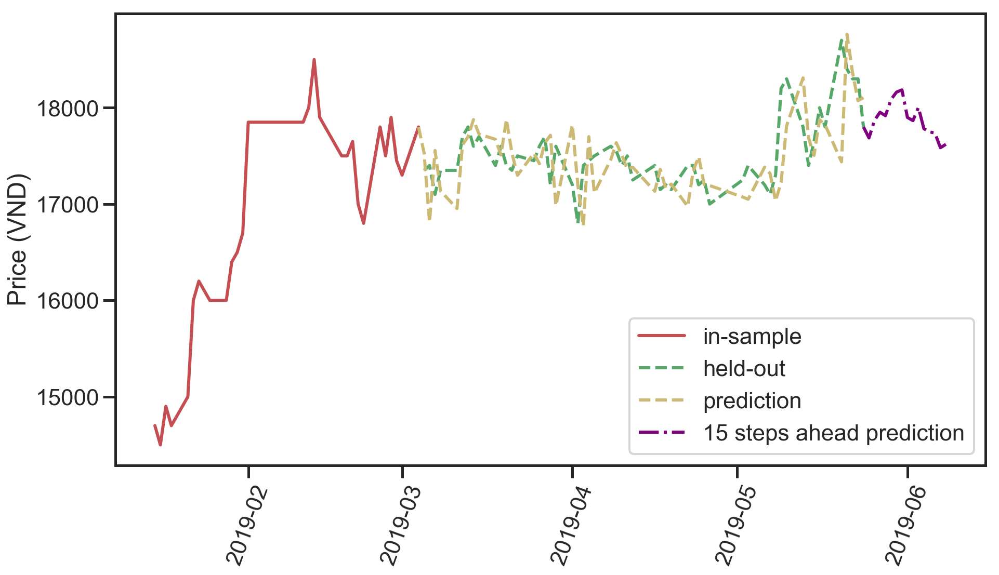

Vietnam JSCmmercial Bank for Industry and Trade
Testing result: {'mse': 158243.334008006, 'rmse': 397.79810709454864, 'mae': 300.67618531732023, 'mape': 1.3893685599807613}


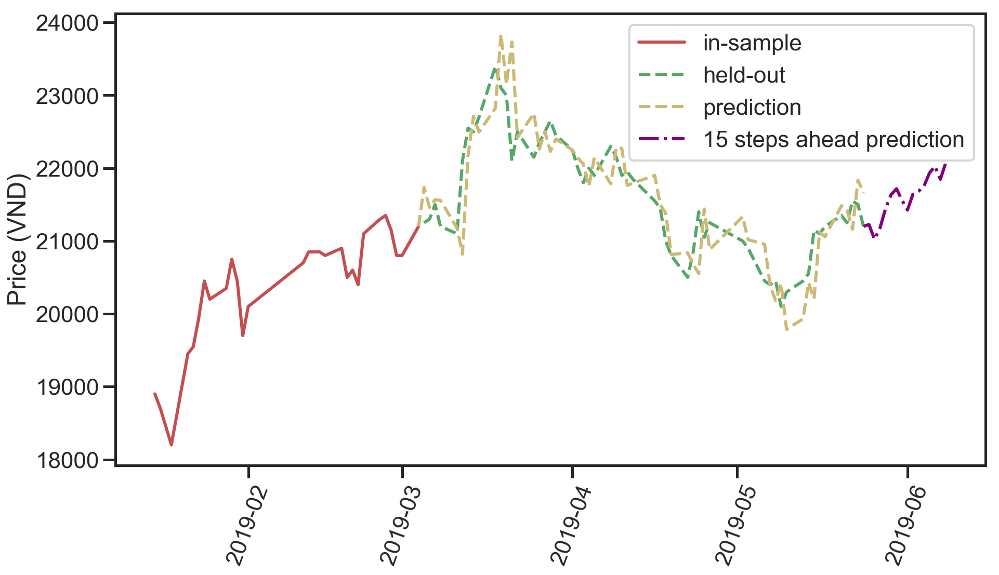

Vietnam Prosperity Joint Stock Commercial Bank
Testing result: {'mse': 45126.506096719226, 'rmse': 212.43000281673778, 'mae': 163.82605466843017, 'mape': 0.8729916885924907}


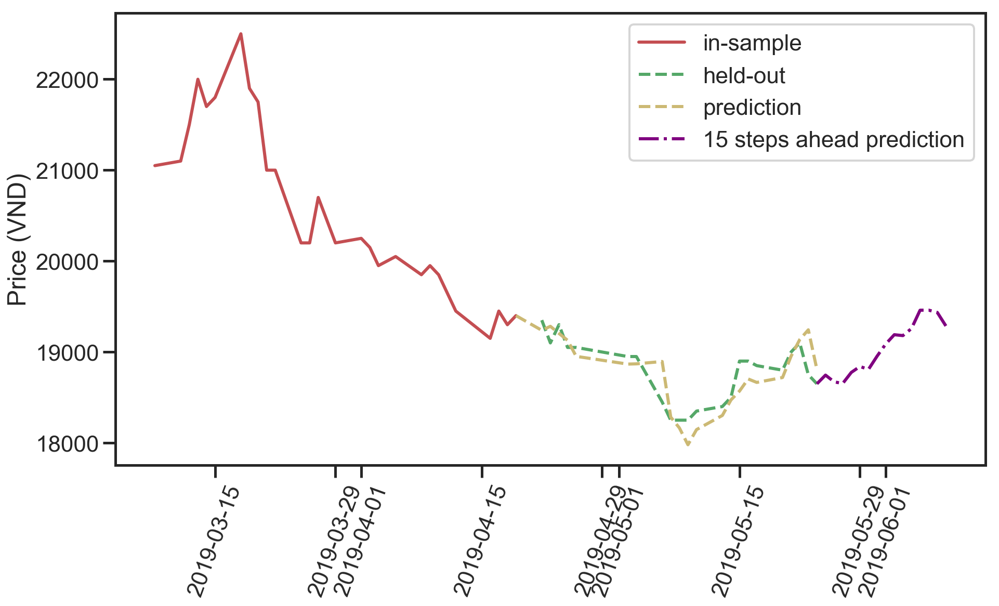

Vietnam Dairy Products JSC
Testing result: {'mse': 4648247.375128934, 'rmse': 2155.9794468243276, 'mae': 1632.4815657026322, 'mape': 1.211943398556741}


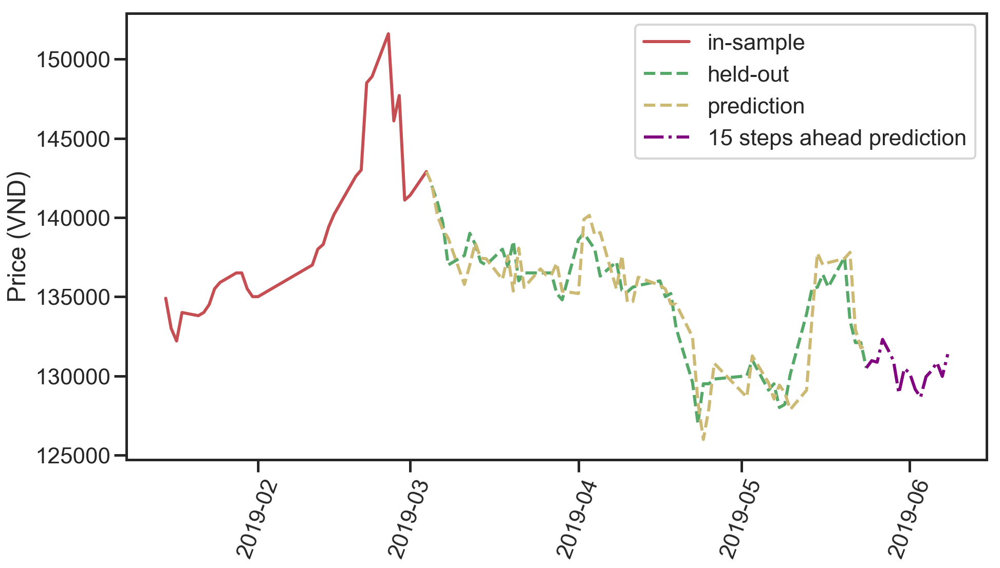

Vincom Retail JSC
Testing result: {'mse': 539293.0026648503, 'rmse': 734.3657145216206, 'mae': 482.8140631069687, 'mape': 1.3799432900914506}


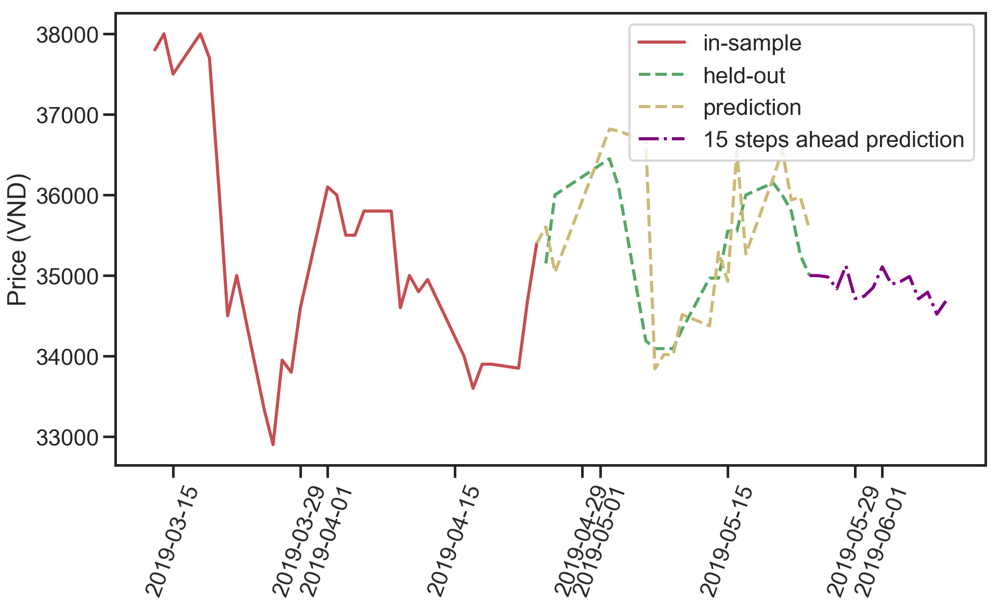

Vingroup JSC
Testing result: {'mse': 2024586.3630451101, 'rmse': 1422.8796024418616, 'mae': 1132.2489302046256, 'mape': 0.9845878950647171}


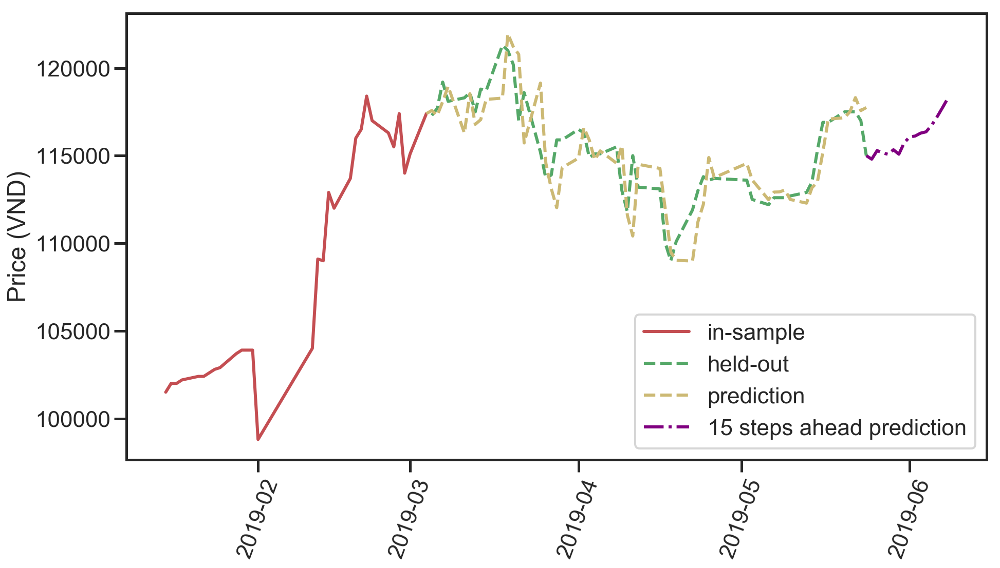

Vinhomes JSC
Testing result: {'mse': 2072567.7597948671, 'rmse': 1439.6415386459462, 'mae': 1125.0492780341715, 'mape': 1.3159835814073846}


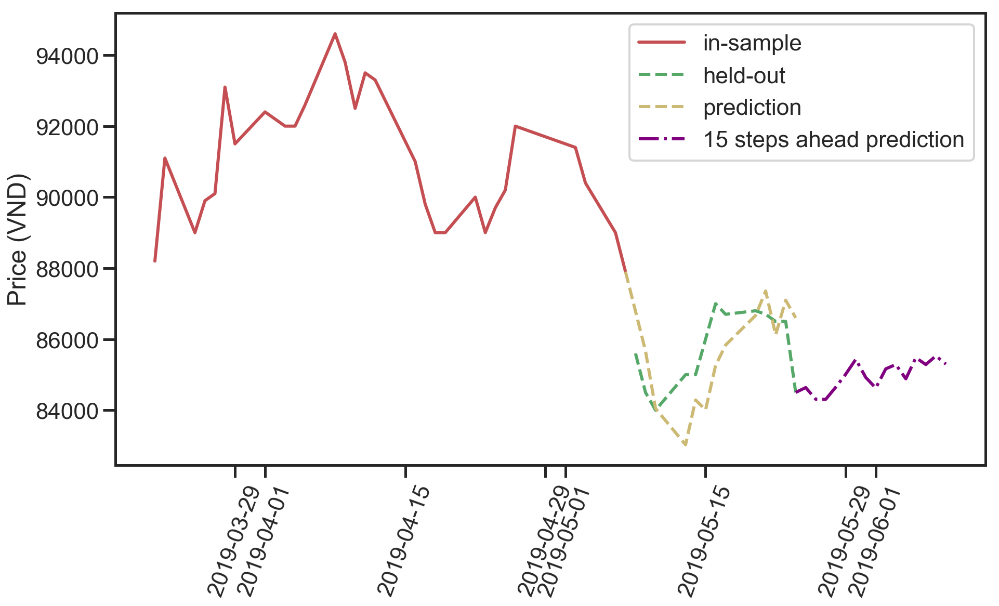

Petrovietnam Gas JSC
Testing result: {'mse': 3796642.507658081, 'rmse': 1948.497500038961, 'mae': 1539.3040436687522, 'mape': 1.4607652582472181}


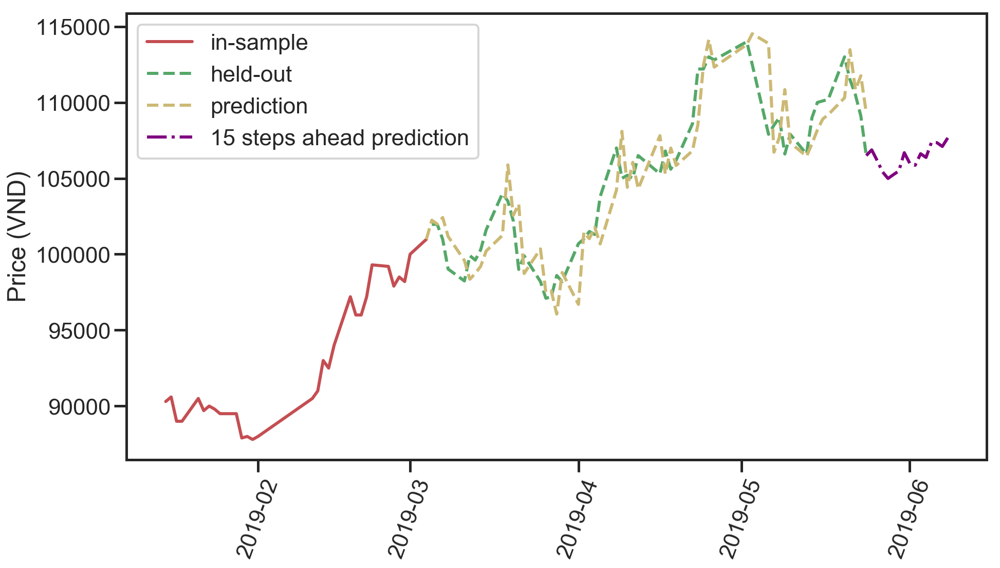

In [22]:
def run_gbm(train, test, window_size):
    result = {}
    gbm = GBM(train, window_size=10)
    prediction = gbm.validate(test)

    df_validation = pd.DataFrame()
    df_validation['y'] = test
    df_validation['yhat'] = prediction

    result_test = evaluation(df_validation)
    prediction = gbm.predict_multi_step_ahead(start=test.index[-1], steps=10)
    result['model_name'] = 'GBM'
    result['model'] = gbm
    result['status'] = True
    result['test_evaluation'] = result_test
    return result

lst_gbm = []
for ticket in lst_ticket:
    time_series = df[df.name == ticket]['close']
    print(ticket)
    # split data
    time_series = time_series.sort_index()
    size = len(time_series)
    train_start = int(start_train * size)
    train_end = int(end_train * size)
    train, test = time_series[train_start:train_end], time_series[train_end:]
    
    result = run_gbm(train, test, window_size=10)
#     print(ticket, ':', result['lag'], result['hidden_layers'])
#     print('Training result:', result['train_evaluation'])
    print('Testing result:', result['test_evaluation'])
    lst_gbm.append({
        'name': ticket,
#         'order': result['order'],
#         'lags': result['lag'],
#         'hidden_layers': result['hidden_layers'],
        'result': result['test_evaluation']
    })
    validation = result['model'].validate(test)
    predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
    fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
    ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
    ax1.plot(test, label='held-out', color='g', linestyle='--')
    ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
    ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
    plt.xticks(rotation=70)
    plt.ylabel('Price (VND)')
    plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
#     plt.title('Model evaluation of ' + ticket)
    plt.show()

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Cotec Construction JSC : (1, 0, 0)
Testing result: {'mse': 6395202.0603238605, 'rmse': 2528.873674251812, 'mae': 1566.1077127752467, 'mape': 1.2080799375706572}


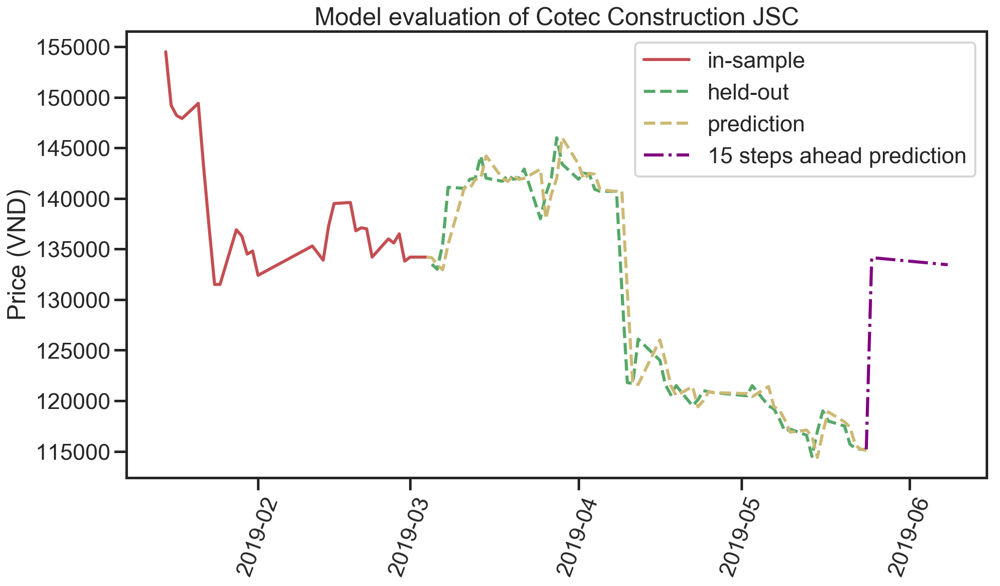

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

DHG Pharmaceutical JSC : (1, 0, 0)
Testing result: {'mse': 1289595.5250877007, 'rmse': 1135.6035950487744, 'mae': 842.904775450108, 'mape': 0.7263148680311045}


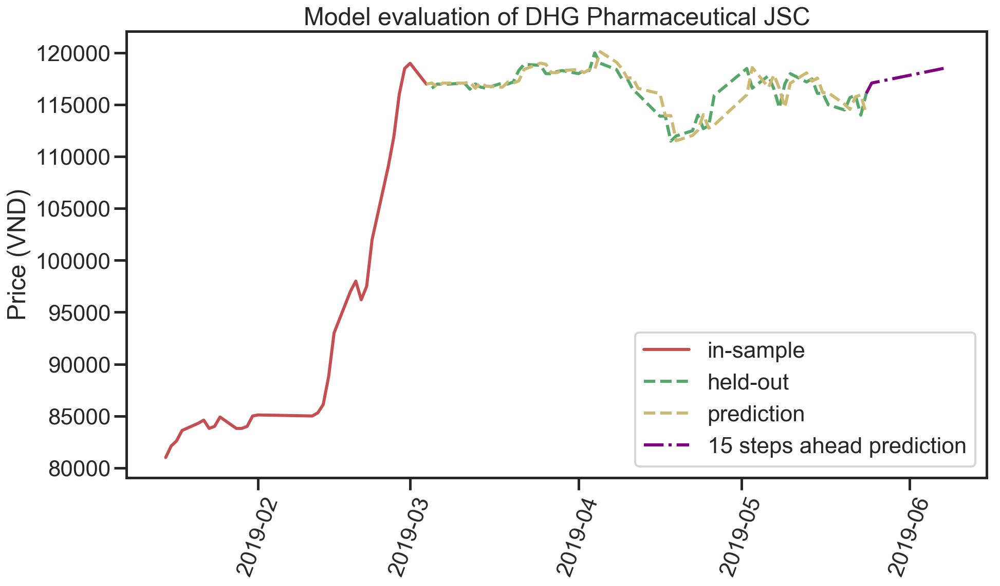

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Faros Construction Corp : (1, 0, 0)
Testing result: {'mse': 648763.153553003, 'rmse': 805.4583499803097, 'mae': 487.3924809166333, 'mape': 1.505438151078277}


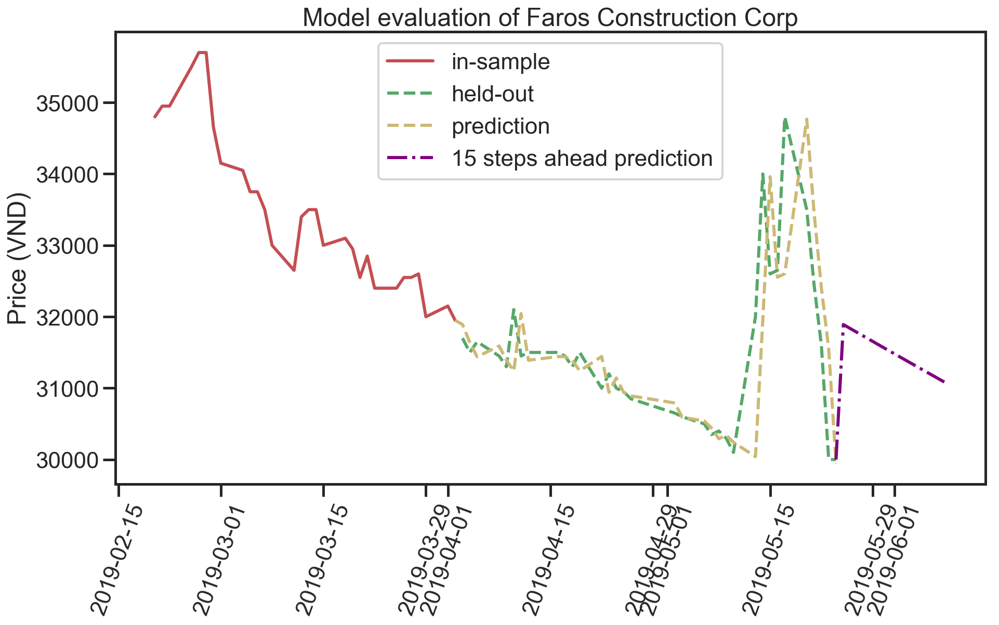

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

FPT Corp : (2, 1, 3)
Testing result: {'mse': 273203.309184337, 'rmse': 522.6885393657842, 'mae': 374.88085852510704, 'mape': 0.8745982916112265}


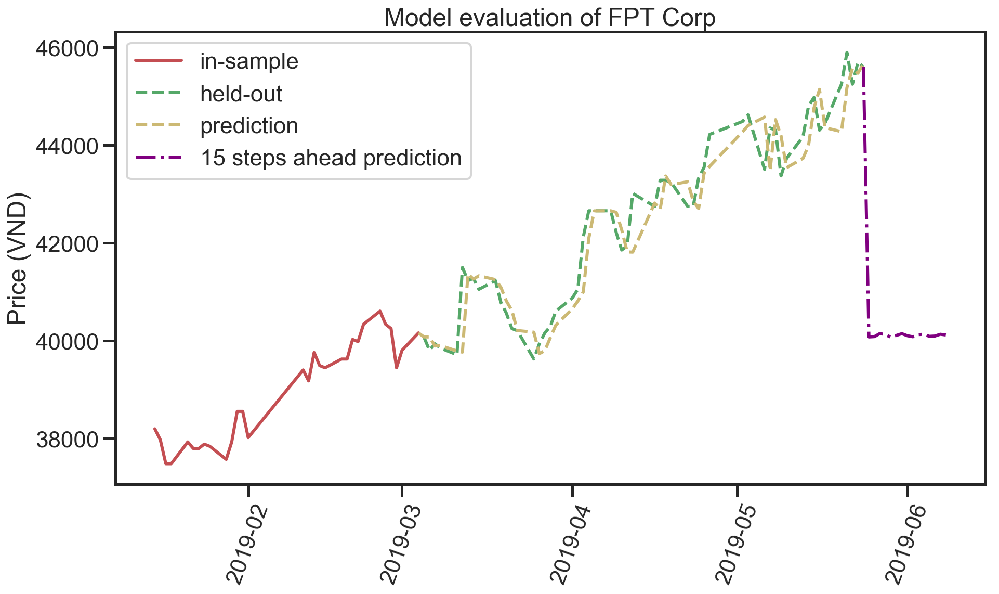

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Gemadept Corp : (3, 0, 1)
Testing result: {'mse': 84067.36489346073, 'rmse': 289.94372711521237, 'mae': 213.70671595602366, 'mape': 0.7991263354824024}


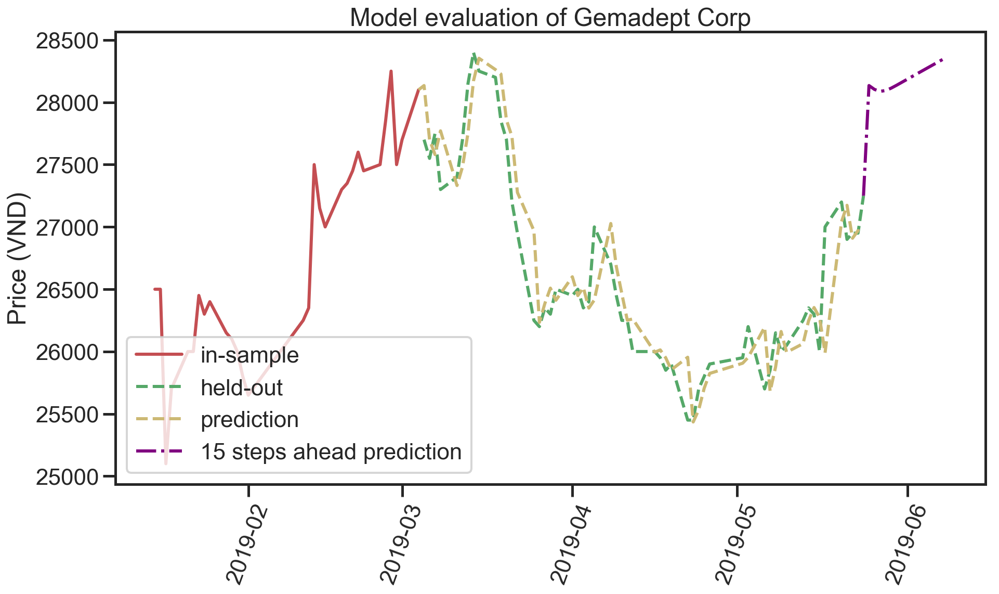

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Ho Chi Minh City Infrastructure Investment JSC : (3, 1, 1)
Testing result: {'mse': 129686.90061869449, 'rmse': 360.12067507808337, 'mae': 264.89354661351973, 'mape': 1.1047801368213963}


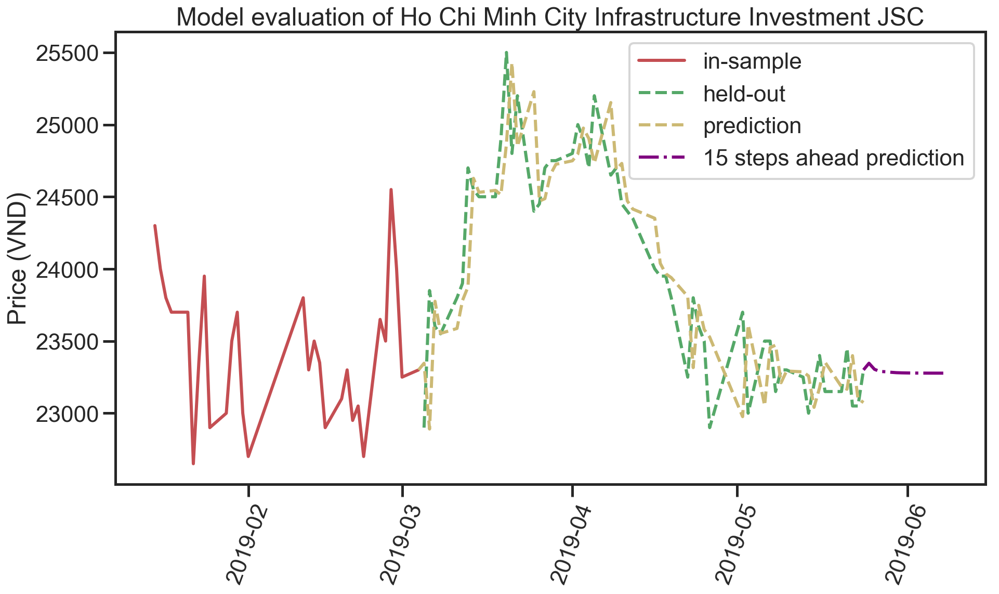

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Ho Chi Minh City Development Joint Stock Commercial Bank : (3, 0, 3)
Testing result: {'mse': 183045.987674096, 'rmse': 427.8387402679846, 'mae': 323.150485172049, 'mape': 1.2018866052441297}


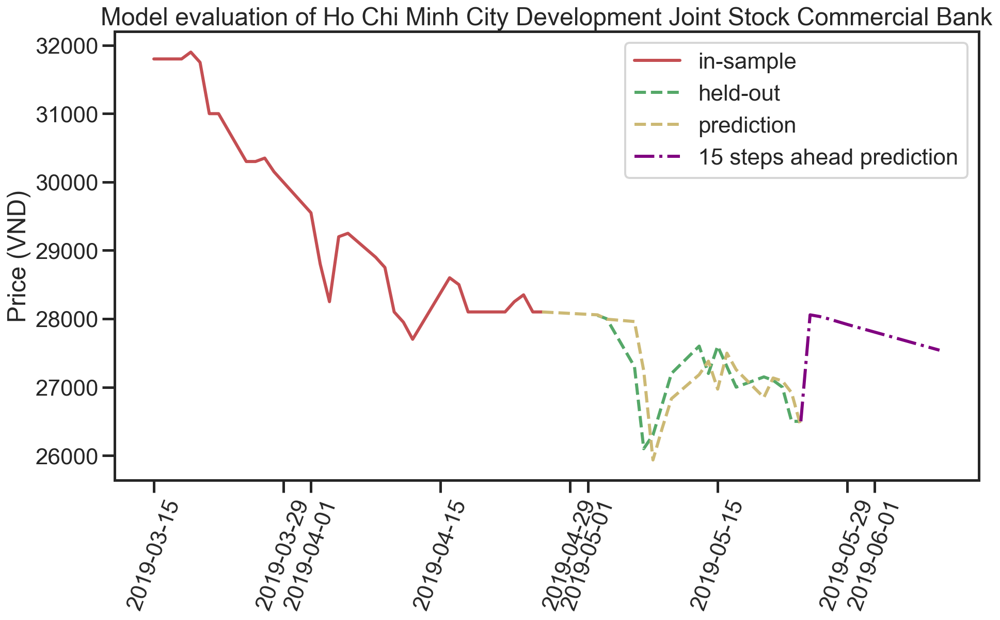

non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Hoa Phat Group JSC : (2, 0, 3)
Testing result: {'mse': 239921.24014412204, 'rmse': 489.81755801943444, 'mae': 306.05784700174854, 'mape': 0.9366745574046295}


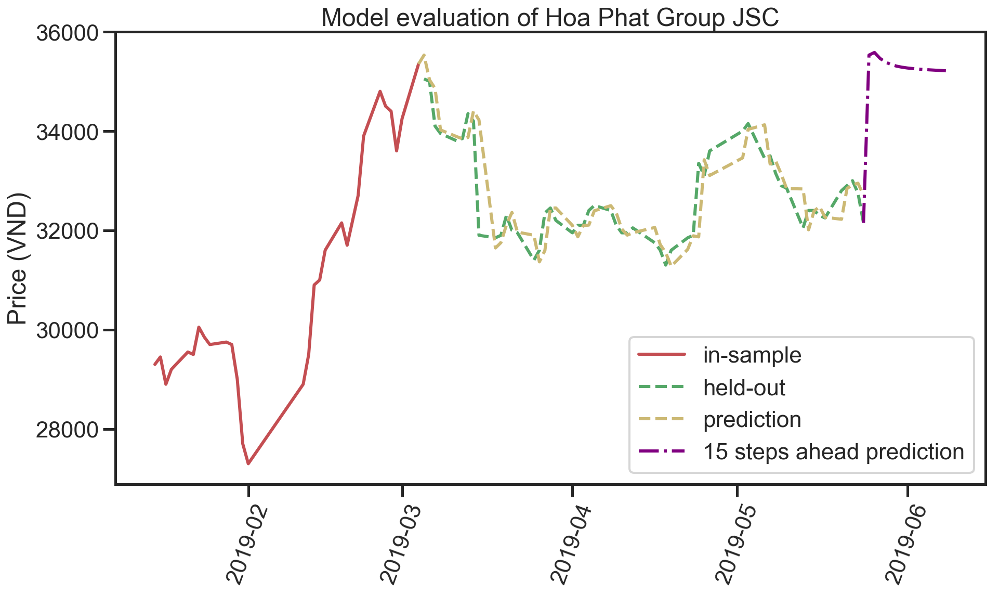

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Masan Group Corp : (1, 1, 0)
Testing result: {'mse': 1396678.993452315, 'rmse': 1181.8117419675245, 'mae': 799.7915776099298, 'mape': 0.9175457950631988}


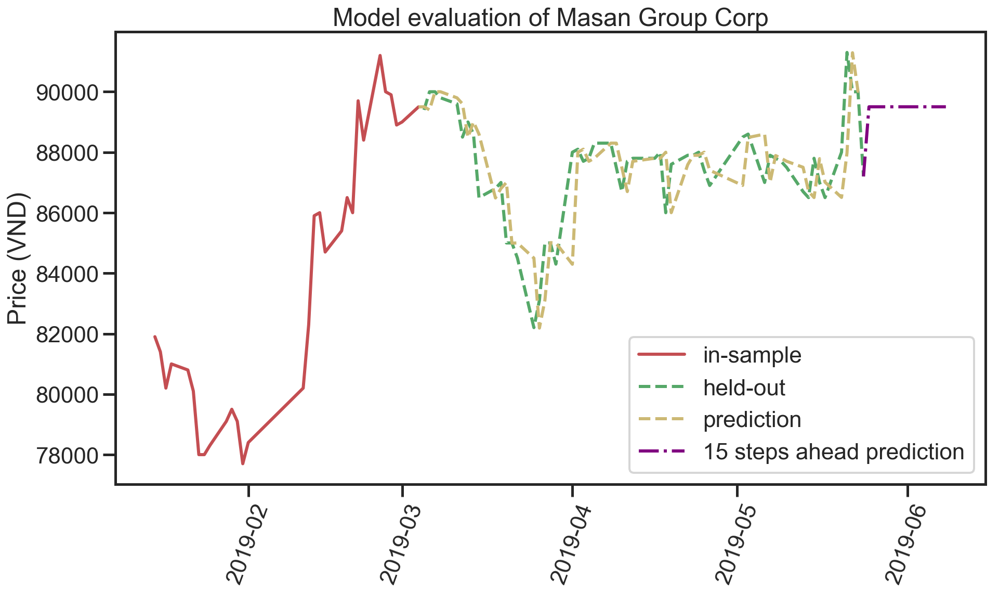

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Military Commercial Joint Stock Bank : (1, 0, 0)
Testing result: {'mse': 76606.49697995561, 'rmse': 276.77878708447946, 'mae': 171.18170903425377, 'mape': 0.785649075055361}


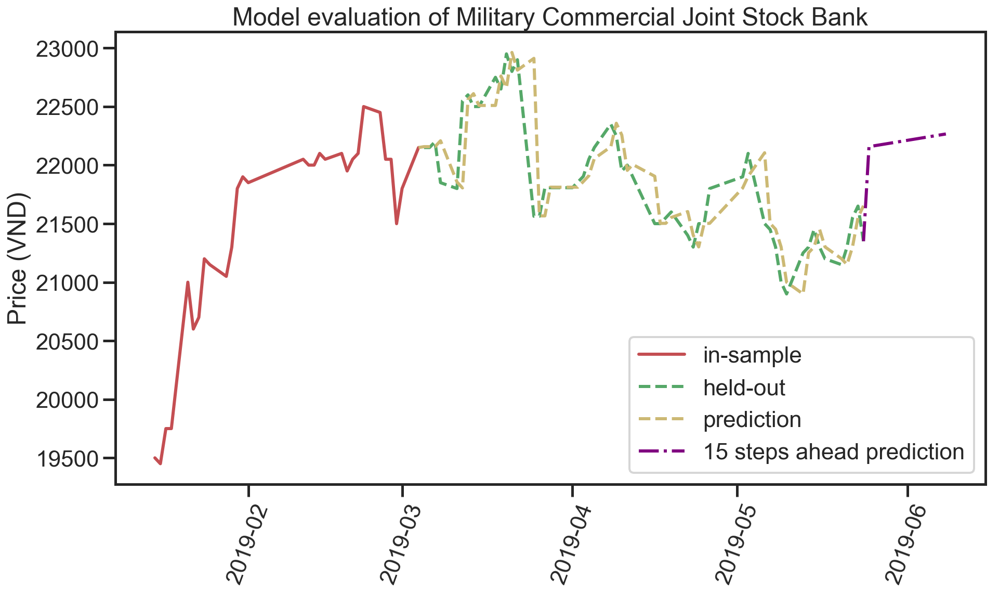

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Mobile World Investment Corp : (1, 1, 1)
Testing result: {'mse': 783603.6494885384, 'rmse': 885.2139004153394, 'mae': 649.5965895412503, 'mape': 0.7611586272146372}


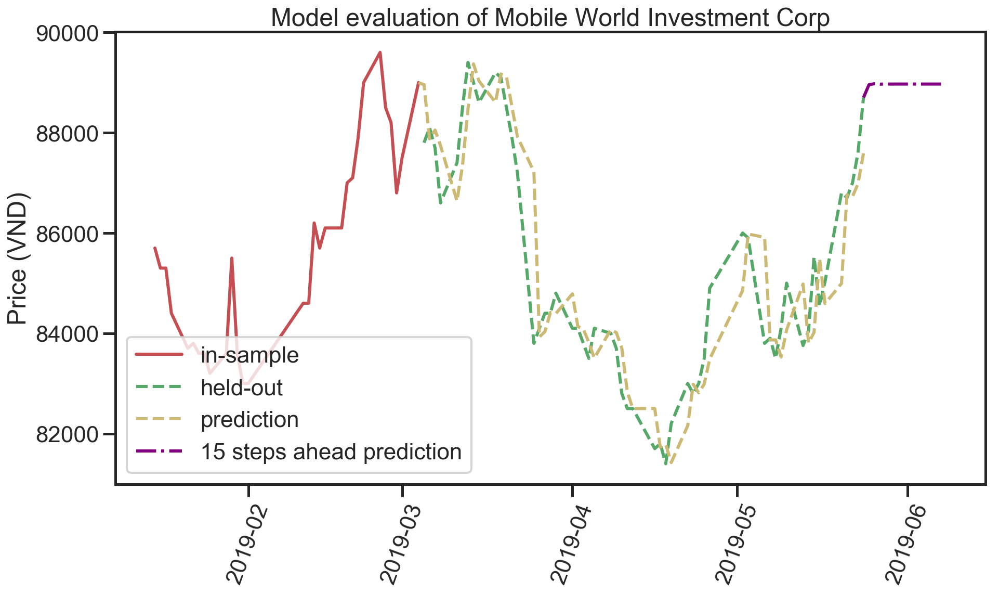

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

No Va Land Investment Group Corp : (1, 1, 0)
Testing result: {'mse': 377682.0117844315, 'rmse': 614.5583876121385, 'mae': 469.2857573675055, 'mape': 0.8101473346198522}


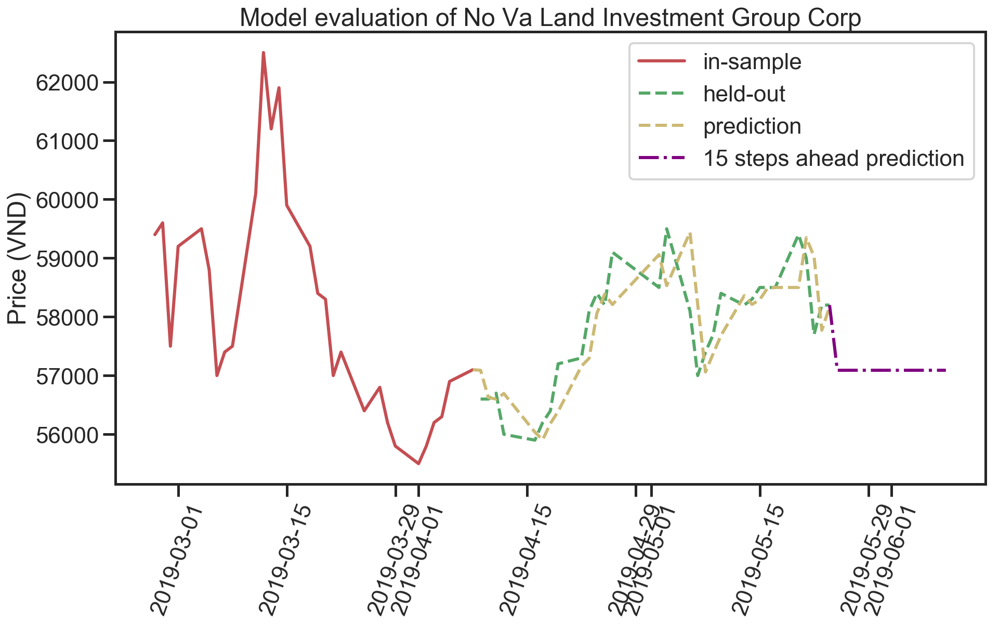

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

PetroVietnam Fertilizer and Chemicals Corp : (3, 1, 3)
Testing result: {'mse': 83812.6683469451, 'rmse': 289.5041767348877, 'mae': 220.15257059913327, 'mape': 1.1741336902083712}


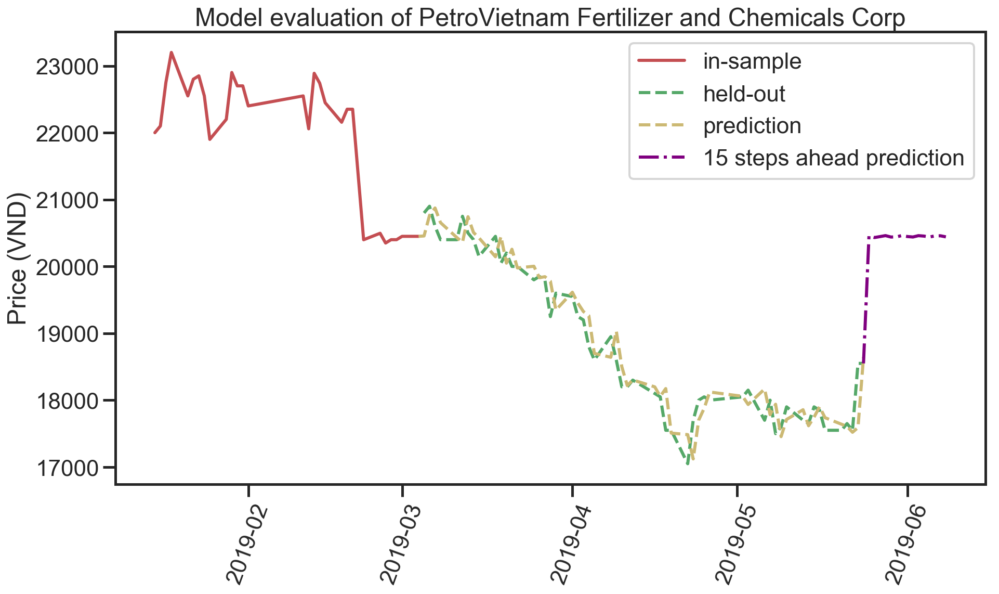

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Phu Nhuan Jewelry JSC : (3, 1, 3)
Testing result: {'mse': 1735462.415204134, 'rmse': 1317.3695059489323, 'mae': 919.1059214900428, 'mape': 0.8987942402464372}


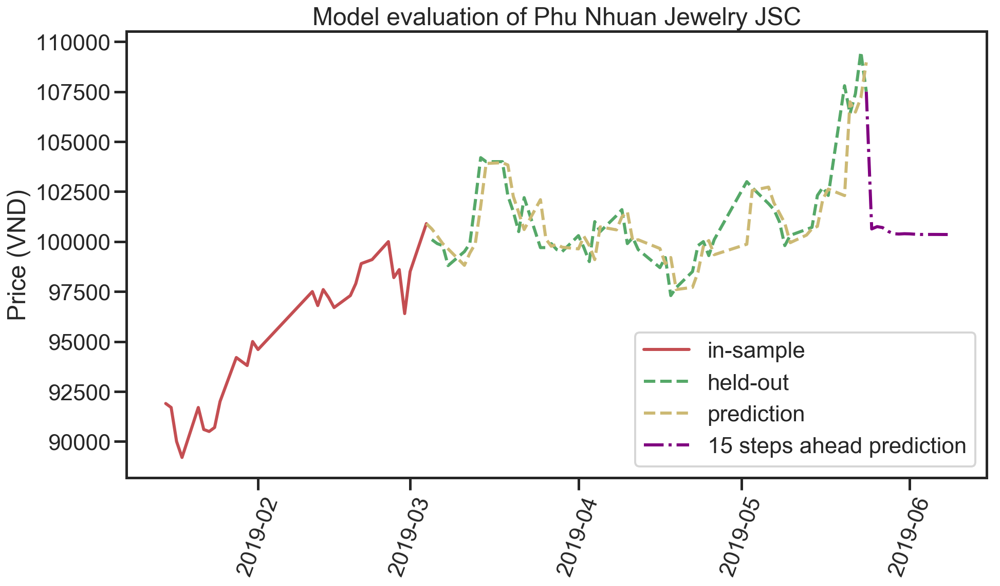

non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Refrigeration Electrical Engineering Corp : (1, 0, 0)
Testing result: {'mse': 190880.45840198477, 'rmse': 436.89868207856244, 'mae': 331.41875708933776, 'mape': 1.015815217006456}


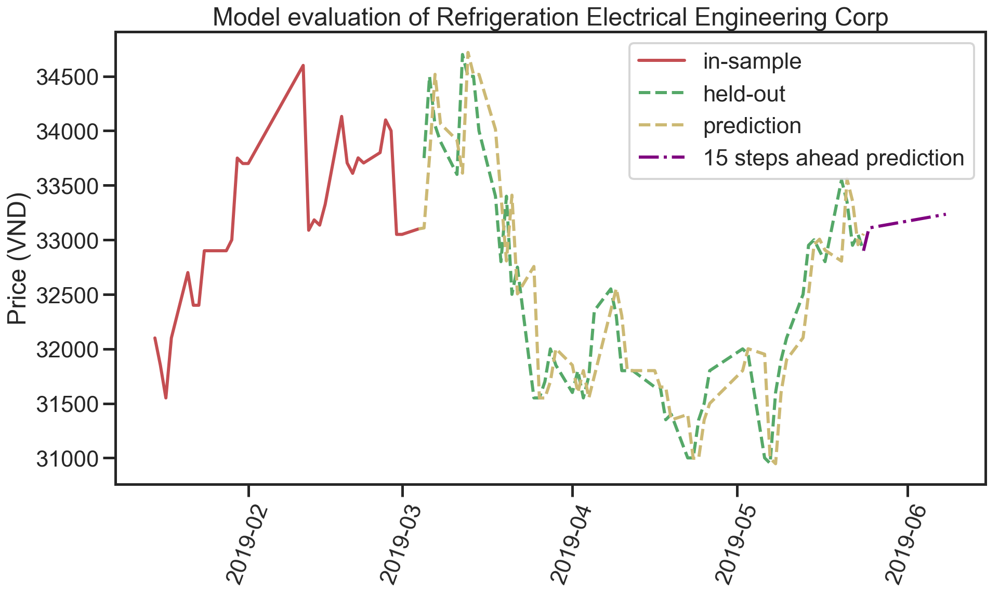

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Sai Gon Thuong Tin Commercial Joint Stock Bank : (2, 1, 3)
Testing result: {'mse': 24099.324799651153, 'rmse': 155.23957227347398, 'mae': 113.14499822740638, 'mape': 0.9257867407999493}


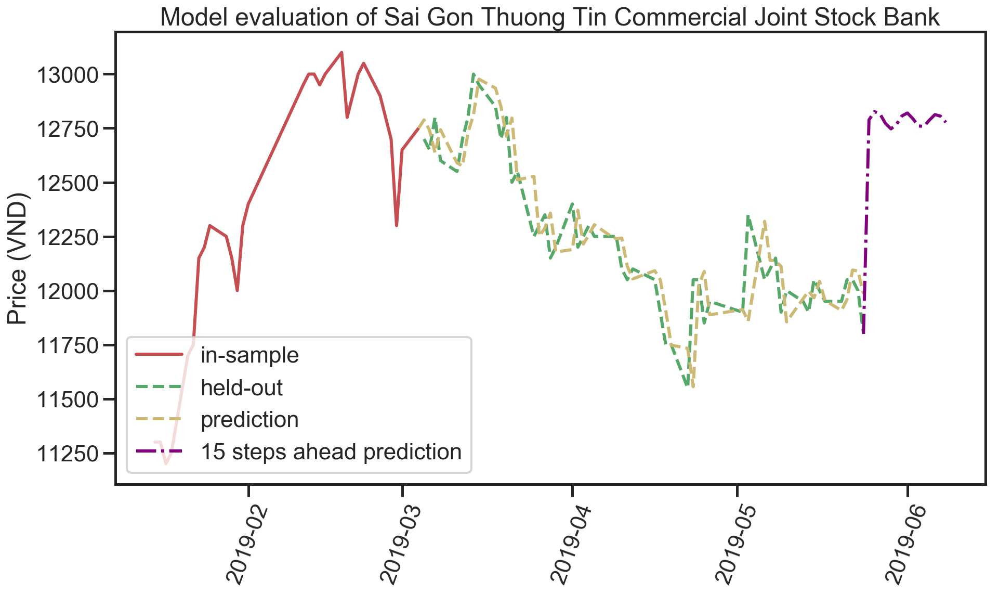

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Saigon Beer Alcohol Beverage Corp : (1, 0, 0)
Testing result: {'mse': 23376745.06922139, 'rmse': 4834.950368847791, 'mae': 3095.554433573637, 'mape': 1.262440204041986}


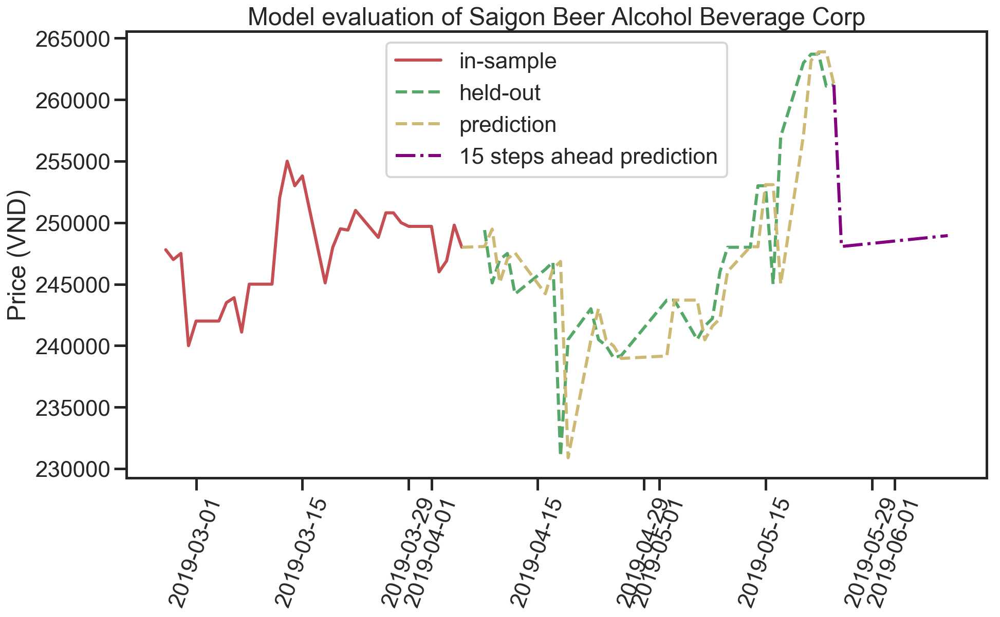

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Saigon Securities Incorporation : (3, 0, 3)
Testing result: {'mse': 131961.99246270803, 'rmse': 363.26573257425207, 'mae': 268.0512679575849, 'mape': 1.005782198873489}


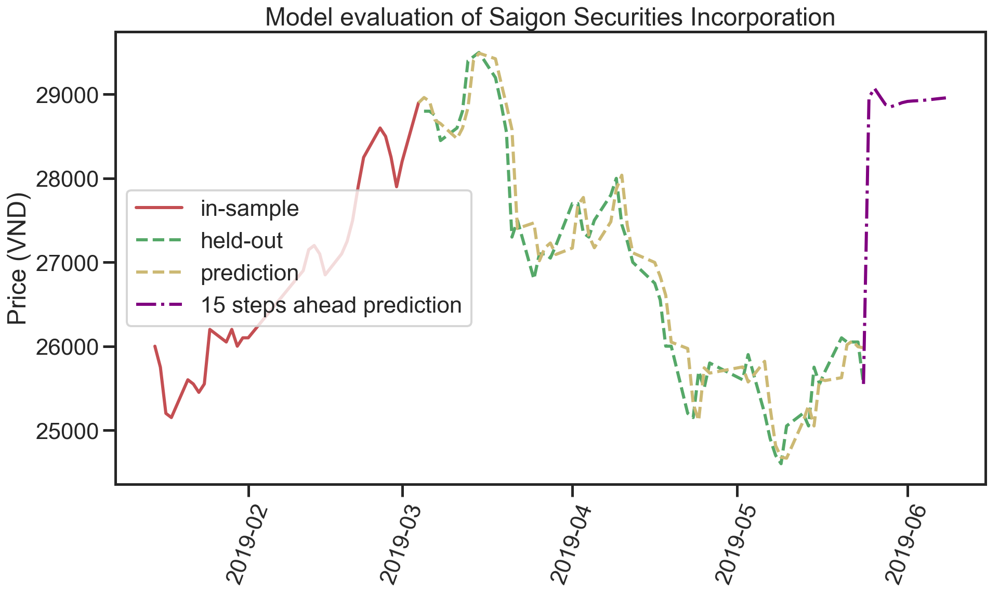

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Vietnam Technological And Commercial Joint Stock Bank : (1, 0, 0)
Testing result: {'mse': 137448.12395327628, 'rmse': 370.73996810874905, 'mae': 263.36885887833284, 'mape': 1.1160799500619432}


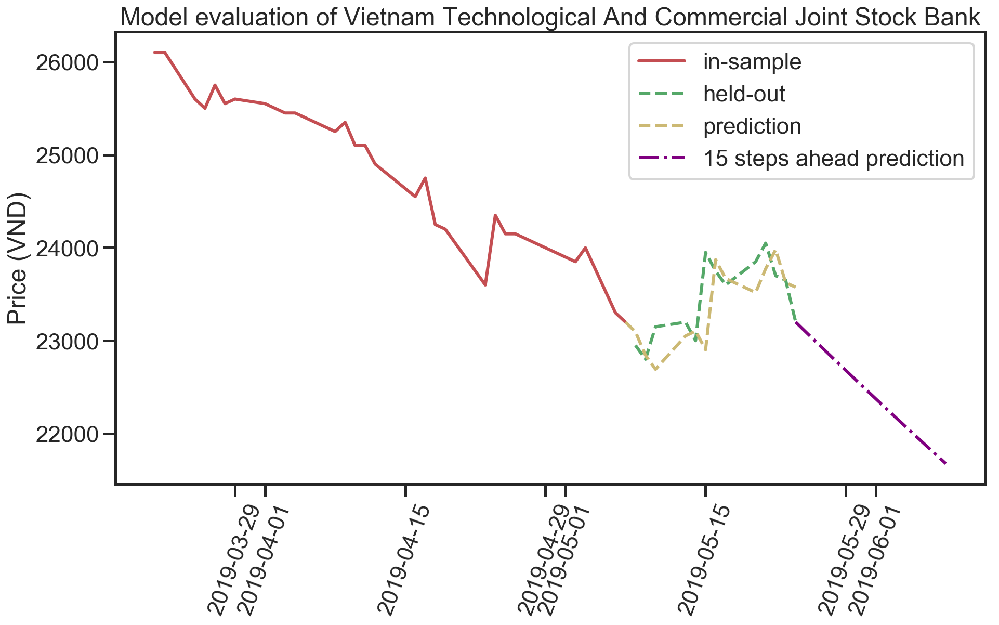

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Thanh Thanh Cong Tay Ninh JSC : (1, 1, 0)
Testing result: {'mse': 37794.93554897971, 'rmse': 194.40919615331913, 'mae': 132.5316586022574, 'mape': 0.7157117177020882}


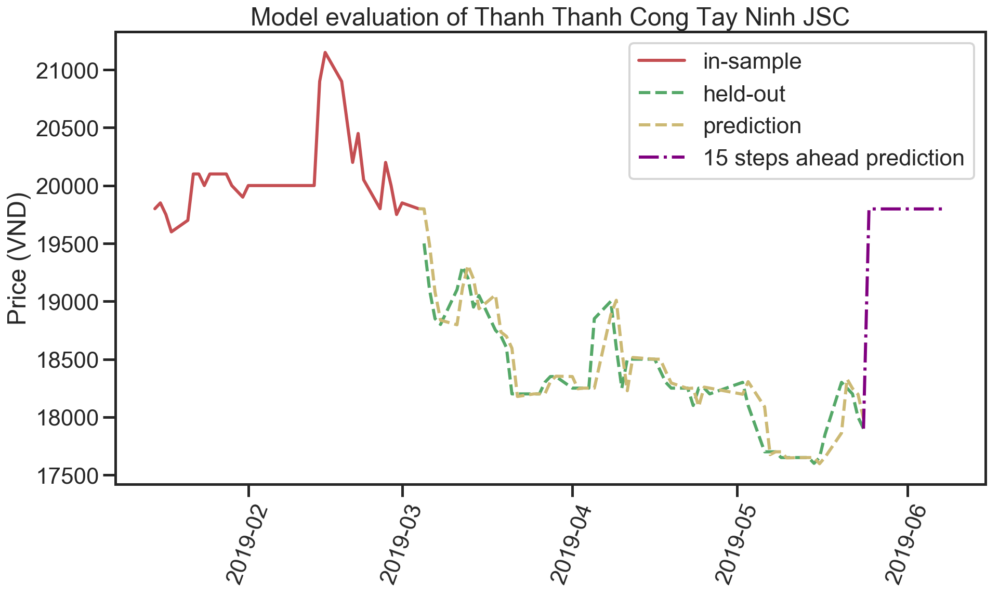

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Joint Stock Commercial Bank for Foreign Trade of Vietnam : (2, 1, 1)
Testing result: {'mse': 513100.5757050756, 'rmse': 716.3103906164391, 'mae': 539.1887600781804, 'mape': 0.8071220052376515}


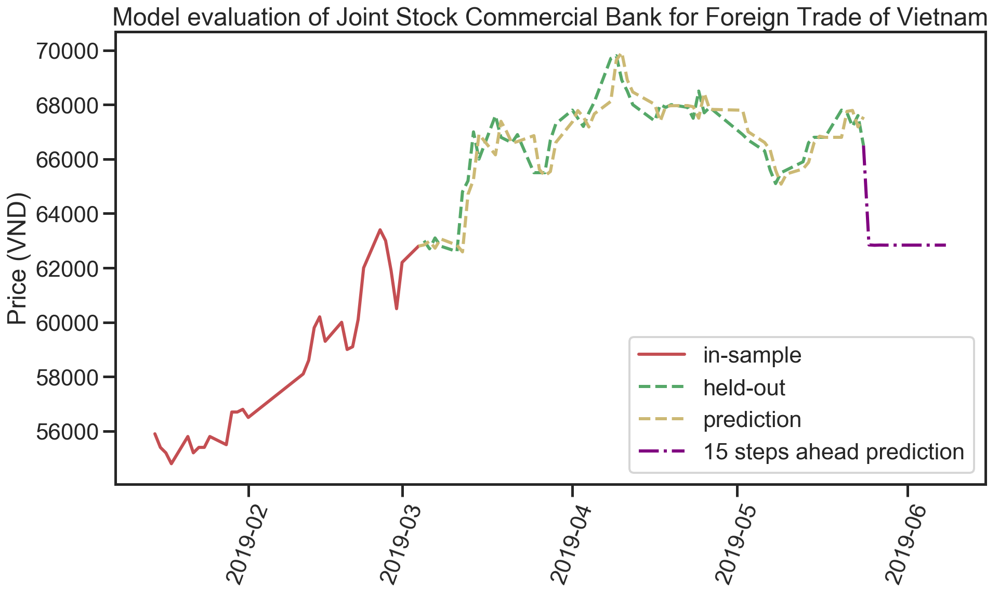

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Vietjet Aviation JSC : (1, 1, 2)
Testing result: {'mse': 544046.4302487224, 'rmse': 737.59503133408, 'mae': 547.8394773610968, 'mape': 0.4697565098722988}


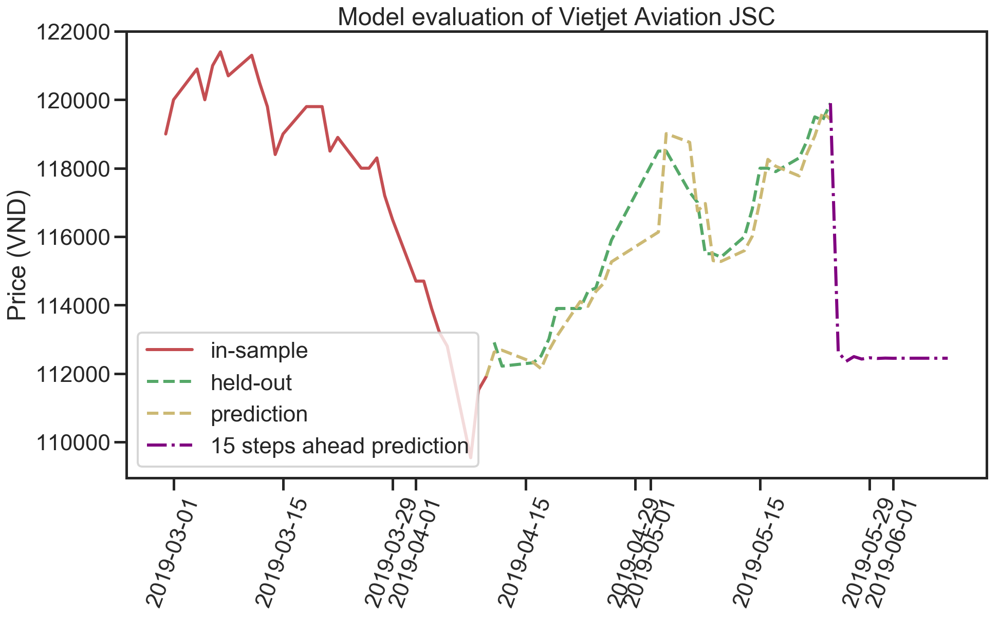

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Vietnam Export Import Commercial Joint Stock Bank : (3, 1, 1)
Testing result: {'mse': 82648.56980540777, 'rmse': 287.4866428295544, 'mae': 

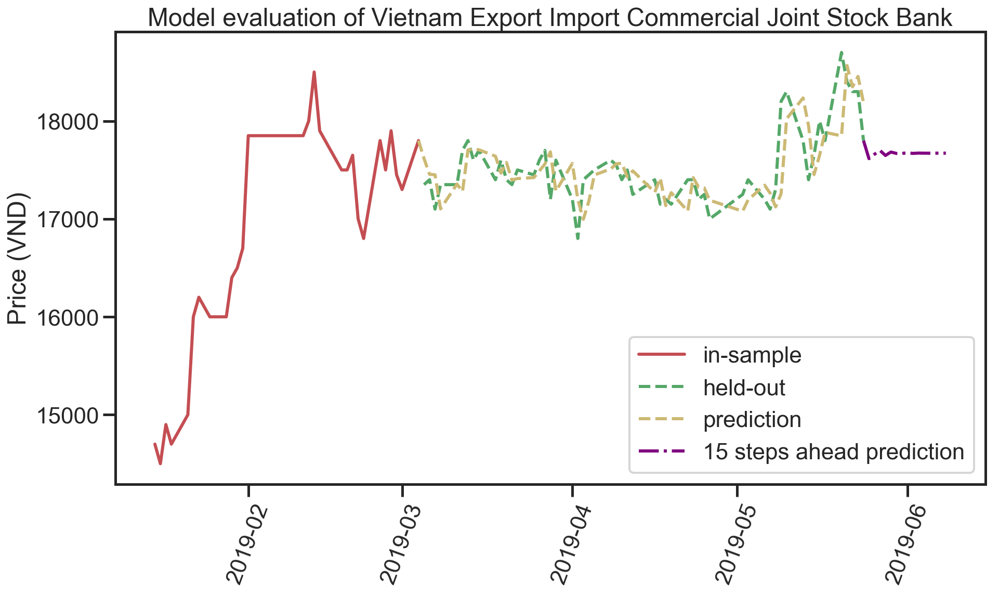

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Vietnam JSCmmercial Bank for Industry and Trade : (3, 0, 3)
Testing result: {'mse': 108270.06602159177, 'rmse': 329.0441703200222, 'mae': 243.0853010550194, 'mape': 1.1211602588215728}


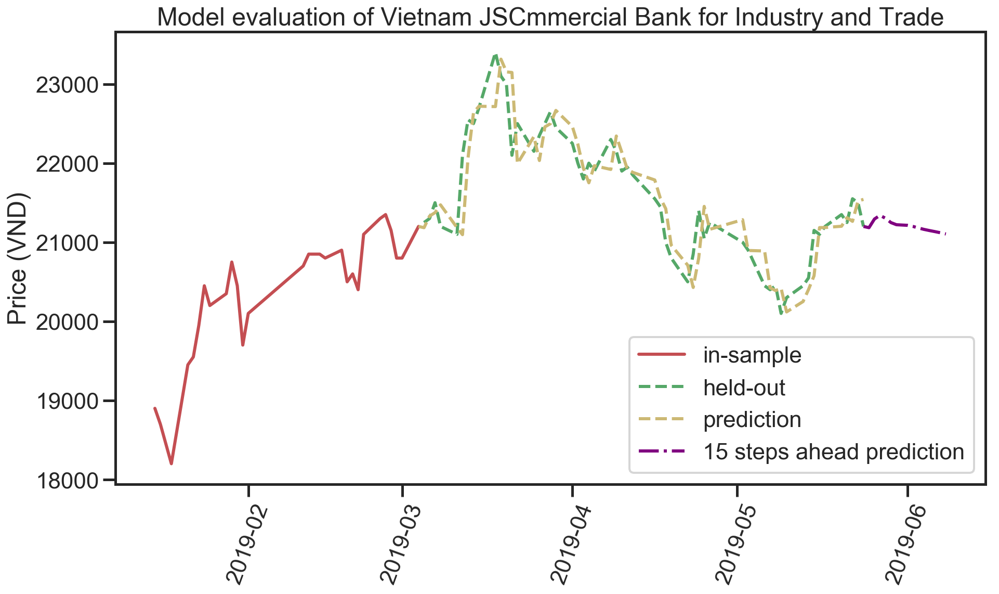

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Vietnam Prosperity Joint Stock Commercial Bank : (1, 0, 0)
Testing result: {'mse': 38218.35491468737, 'rmse': 195.49515317441345, 'mae': 141.2231909850535, 'mape': 0.7518065847416459}


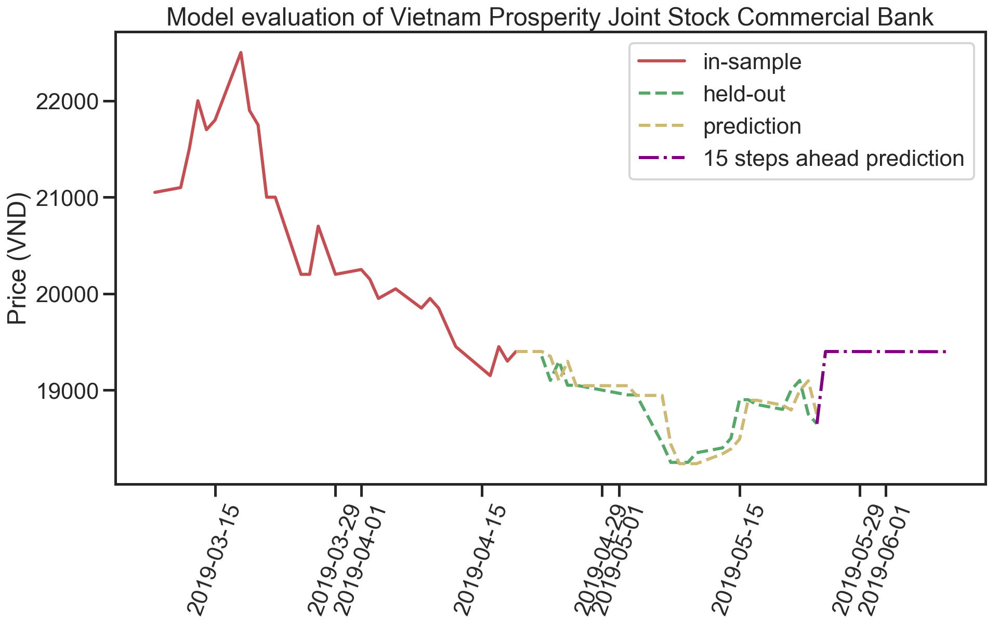

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Vietnam Dairy Products JSC : (1, 1, 0)
Testing result: {'mse': 2438928.7354088086, 'rmse': 1561.7069940961424, 'mae': 1165.6092854172502, 'mape': 0.8679743465474778}


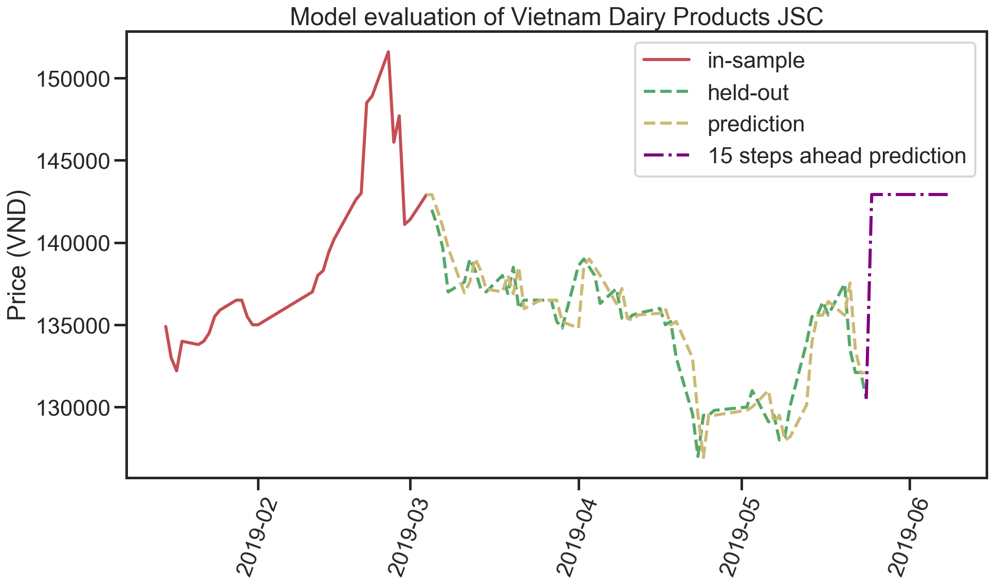

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Vincom Retail JSC : (3, 1, 3)
Testing result: {'mse': 355786.8758821601, 'rmse': 596.4787304524447, 'mae': 377.0959570345616, 'mape': 1.0780652076921193}


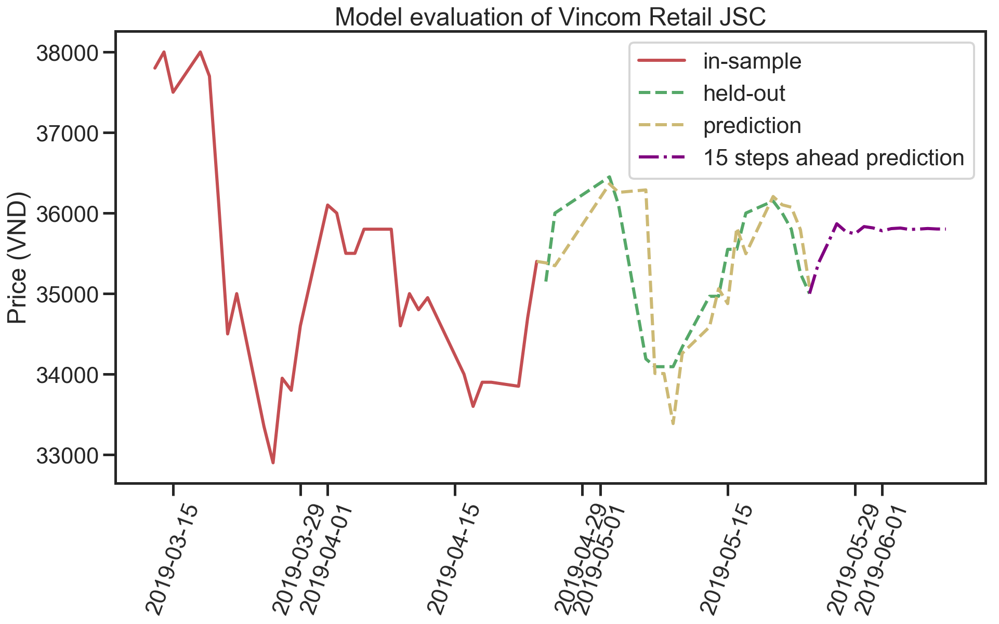

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Vingroup JSC : (1, 0, 1)
Testing result: {'mse': 1820504.9130818576, 'rmse': 1349.2608765846053, 'mae': 949.6175683587612, 'mape': 0.8263196126575987}


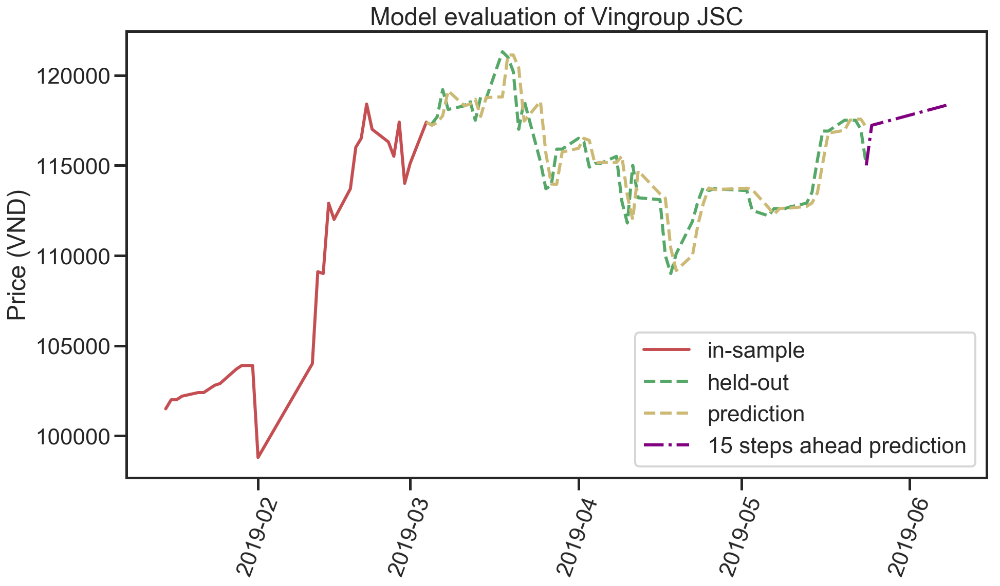

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Vinhomes JSC : (1, 0, 0)
Testing result: {'mse': 1052027.1710364998, 'rmse': 1025.6837578106129, 'mae': 739.709711252198, 'mape': 0.8662237105144062}


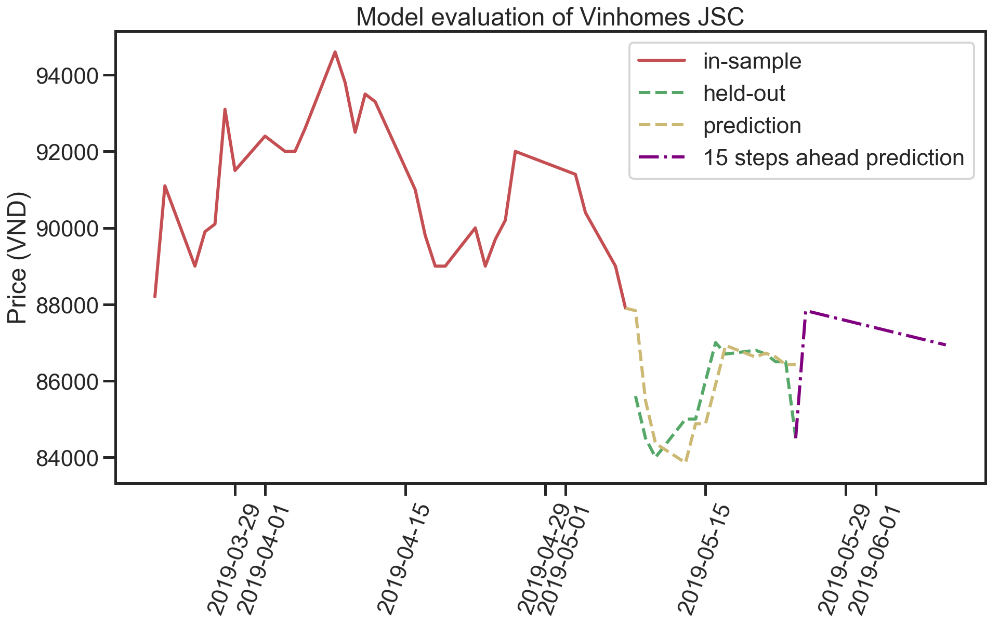

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.

Petrovietnam Gas JSC : (2, 0, 0)
Testing result: {'mse': 2806959.522260586, 'rmse': 1675.3983174936598, 'mae': 1308.6954639715193, 'mape': 1.242229336541879}


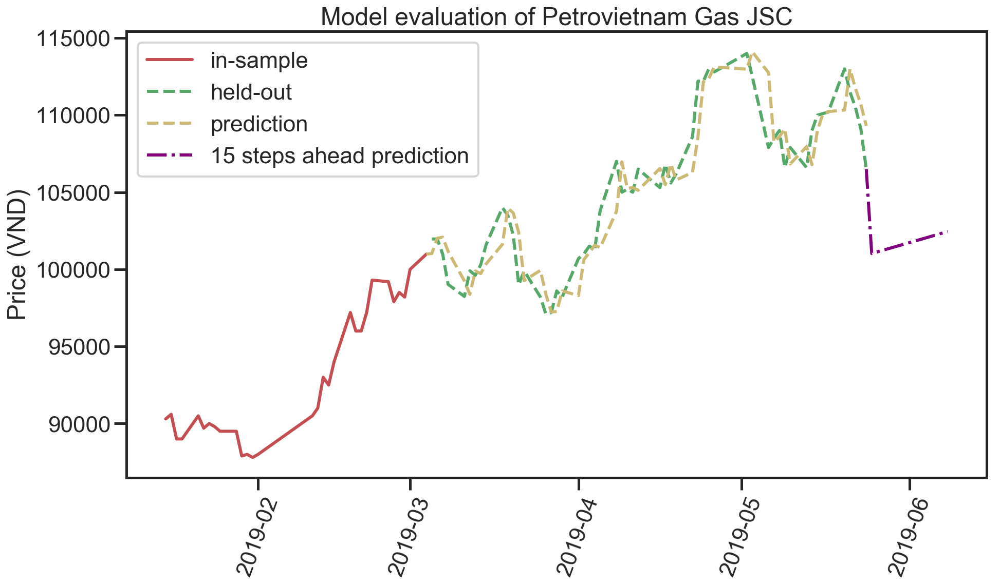

In [13]:
lst_arima = []
for ticket in lst_ticket:
    time_series = df[df.name == ticket]['close']
    
    # split data
    time_series = time_series.sort_index()
    size = len(time_series)
    train_start = int(start_train * size)
    train_end = int(end_train * size)
    train, test = time_series[train_start:train_end], time_series[train_end:]
    
    result, lst_result = run_model_without_parameters(train, test, model_selection='ARIMA', q=range(0, 4))
    print(ticket, ':', result['order'])
#     print('Training result:', result['train_evaluation'])
    print('Testing result:', result['test_evaluation'])
    lst_arima.append({
        'name': ticket,
        'order': result['order'],
#         'lags': result['lag'],
#         'hidden_layers': result['hidden_layers'],
        'result': result['test_evaluation']
    })
    validation = result['model'].validate(test)
    predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
    fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
    ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
    ax1.plot(test, label='held-out', color='g', linestyle='--')
    ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
    ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
    plt.xticks(rotation=70)
    plt.ylabel('Price (VND)')
    plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
    plt.title('Model evaluation of ' + ticket)
    plt.show()

In [25]:
lst_ann = []
for ticket in lst_ticket:
    time_series = df[df.name == ticket]['close']
    # split data
    time_series = time_series.sort_index()
    size = len(time_series)
    train_start = int(start_train * size)
    train_end = int(end_train * size)
    train, test = time_series[train_start:train_end], time_series[train_end:]
    
    result, lst_result = run_model_without_parameters(train, test, model_selection='ANN', q=range(0, 4))
    print(ticket, ':', result['lag'], result['hidden_layers'])
#     print('Training result:', result['train_evaluation'])
    print('Testing result:', result['test_evaluation'])
    lst_ann.append({
        'name': ticket,
#         'order': result['order'],
        'lags': result['lag'],
        'hidden_layers': result['hidden_layers'],
        'result': result['test_evaluation']
    })
#     validation = result['model'].validate(test)
#     predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
#     fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
#     ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
#     ax1.plot(test, label='held-out', color='g', linestyle='--')
#     ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
#     ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
#     plt.xticks(rotation=70)
#     plt.ylabel('Price (VND)')
#     plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
#     plt.title('Model evaluation of ' + ticket)
#     plt.show()


Cotec Construction JSC : 2 (5, 1)
Testing result: {'mse': 2731541.268071526, 'rmse': 1652.7375073106818, 'mae': 1210.4296968869771, 'mape': 1.0522743934081427}


In [15]:
df_result = pd.DataFrame(data=lst_ann)
df_result.to_csv('model_selection_ann.csv')
df_result.head(30)

,hidden_layers,lags,name,result
0,"(5, 1)",2,Cotec Construction JSC,"{'mse': 2731541.268071526, 'rmse': 1652.737507..."


In [24]:
lst_ann_summary = []
for ticket in lst_ticket[:1]:
    time_series = df[df.name == ticket]['close']
    print(ticket)
    # split data
    time_series = time_series.sort_index()
    size = len(time_series)
    train_start = int(start_train * size)
    train_end = int(end_train * size)
    train, test = time_series[train_start:train_end], time_series[train_end:]
    
    lag = df_result[df_result['name'] == ticket].lags.values[0]
    hl = df_result[df_result['name'] == ticket].hidden_layers.values[0]
    
    lst_result = []
    for i in tqdm(range(10)):
        result = run_model_with_parameters(train, test, model_selection='ANN',
                                           lag=lag, hidden_layers=hl)
        lst_result.append({
            'mse': result['test_evaluation']['mse'],
            'rmse': result['test_evaluation']['rmse'],
            'mae': result['test_evaluation']['mae'],
            'mape': result['test_evaluation']['mape'],
        })
        print(result['test_evaluation']['mape'])
    df_ = pd.DataFrame(data=lst_result)
    lst_ann_summary.append({
        'name': ticket,
        'lag': lag,
        'hl': hl,
        'mean_mse': df_['mse'].mean(),
        'std_mse': df_['mse'].std(),
        'mean_rmse': df_['rmse'].mean(),
        'std_rmse': df_['rmse'].std(),
        'mean_mae': df_['mae'].mean(),
        'std_mae': df_['mae'].std(),
        'mean_mape': df_['mape'].mean(),
        'std_mape': df_['mape'].std(),
    })

Cotec Construction JSC


1.0522743934081427
1.0522743934081427
1.0522743934081427
1.0522743934081427
1.0522743934081427
1.0522743934081427
1.0522743934081427
1.0522743934081427
1.0522743934081427
1.0522743934081427



In [22]:
df_ann_summary = pd.DataFrame(data=lst_ann_summary)
df_ann_summary = df_ann_summary.set_index('name')
df_ann_summary.head(30)

,hl,lag,mean_mae,mean_mape,mean_mse,mean_rmse,std_mae,std_mape,std_mse,std_rmse
name,,,,,,,,,,
Cotec Construction JSC,"(5, 1)",2,1210.42970,1.05227,2731541.26807,1652.73751,0.00000,0.00000,0.00000,0.00000


In [ ]:
df_ann_summary.to_csv('ann_summary.csv')

Cotec Construction JSC
Run model LSTM
Instructions for updating:
Colocations handled automatically by placer.
Training drift...
Instructions for updating:
Use tf.cast instead.
Done.
Training volatility...
Done.
Testing result: {'mse': 8826232.4707861, 'rmse': 2970.897586721242, 'mae': 1993.153580755529, 'mape': 1.5468414986263856}


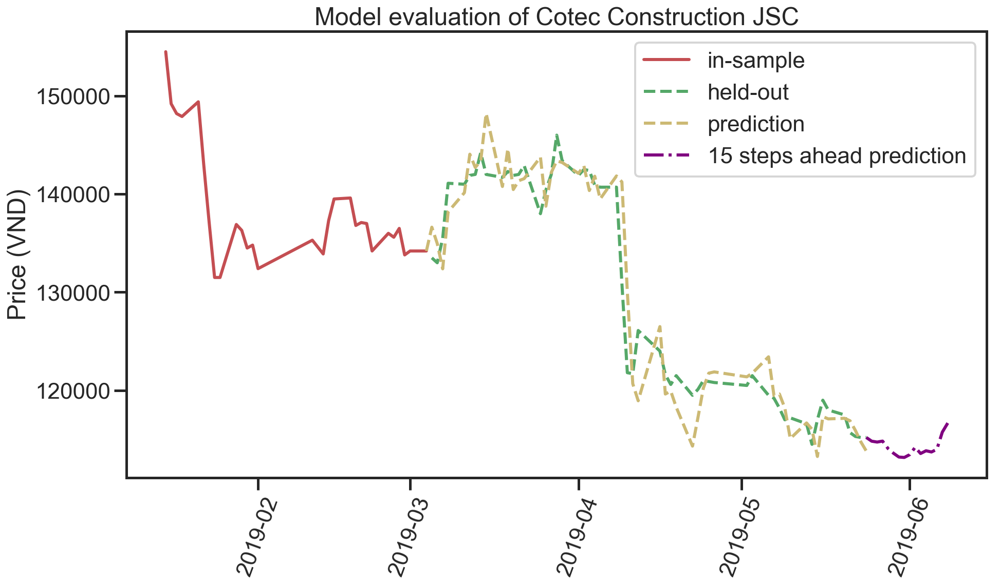

DHG Pharmaceutical JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 2530209.3008961747, 'rmse': 1590.6631638710235, 'mae': 1247.9409546039128, 'mape': 1.0735708073320371}


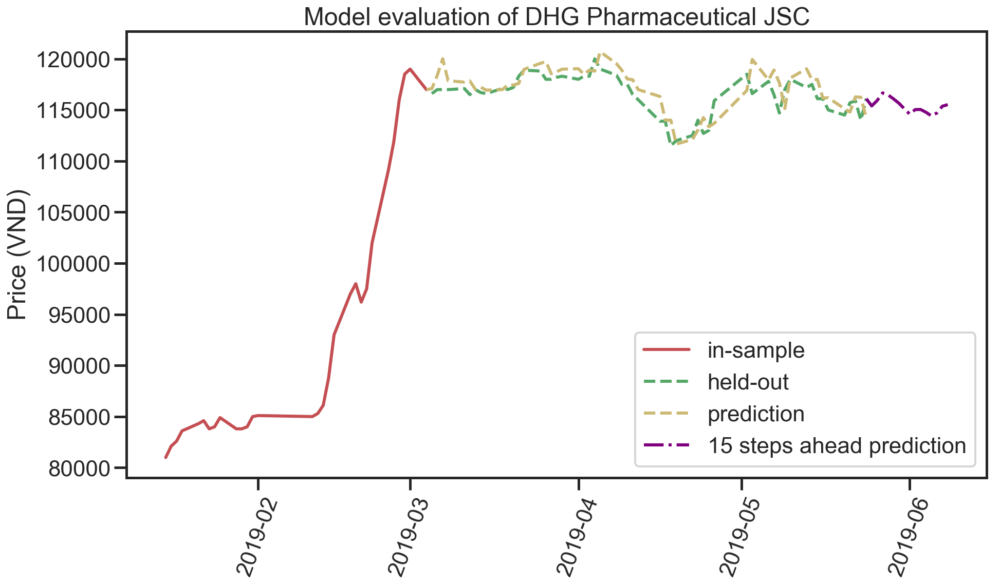

Faros Construction Corp
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 755066.2505743003, 'rmse': 868.9454819344538, 'mae': 548.4199184916424, 'mape': 1.7016052362814758}


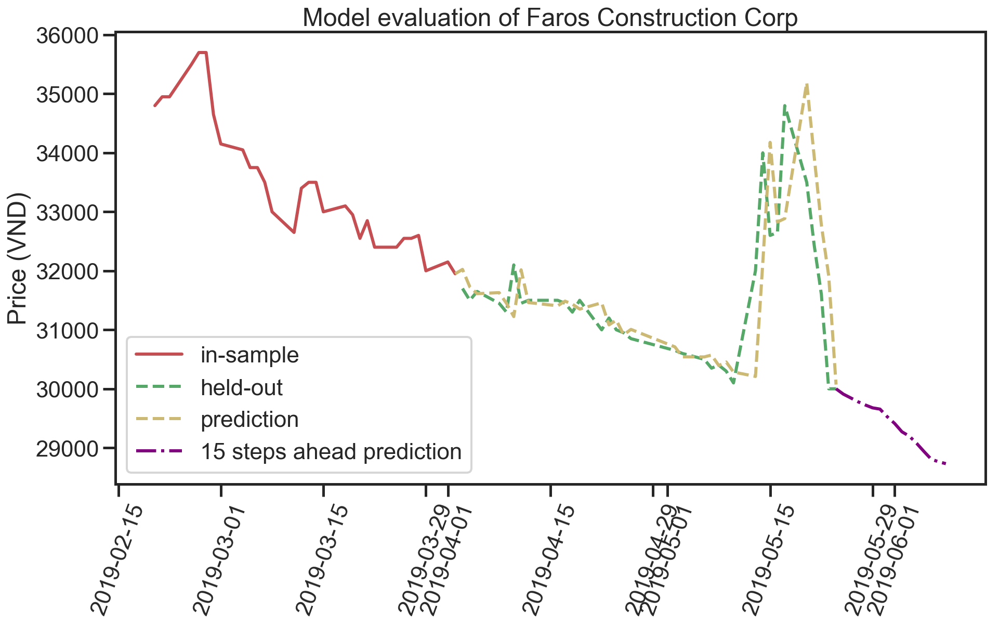

FPT Corp
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 375835.52727486676, 'rmse': 613.0542612810605, 'mae': 495.3059845284296, 'mape': 1.1572399933737028}


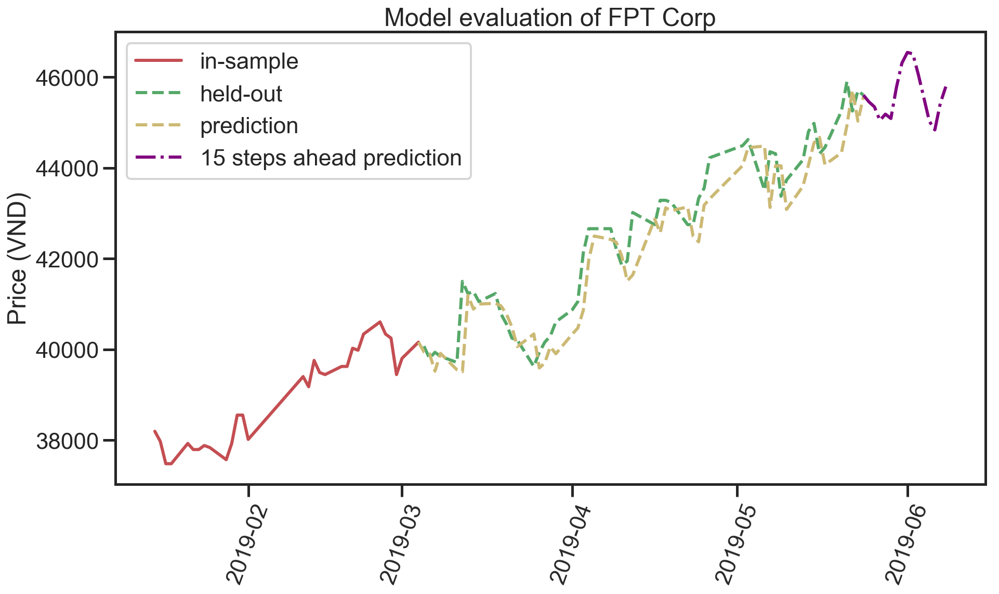

Gemadept Corp
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 102746.39857632824, 'rmse': 320.54079081503534, 'mae': 255.0112129332546, 'mape': 0.9526933303890487}


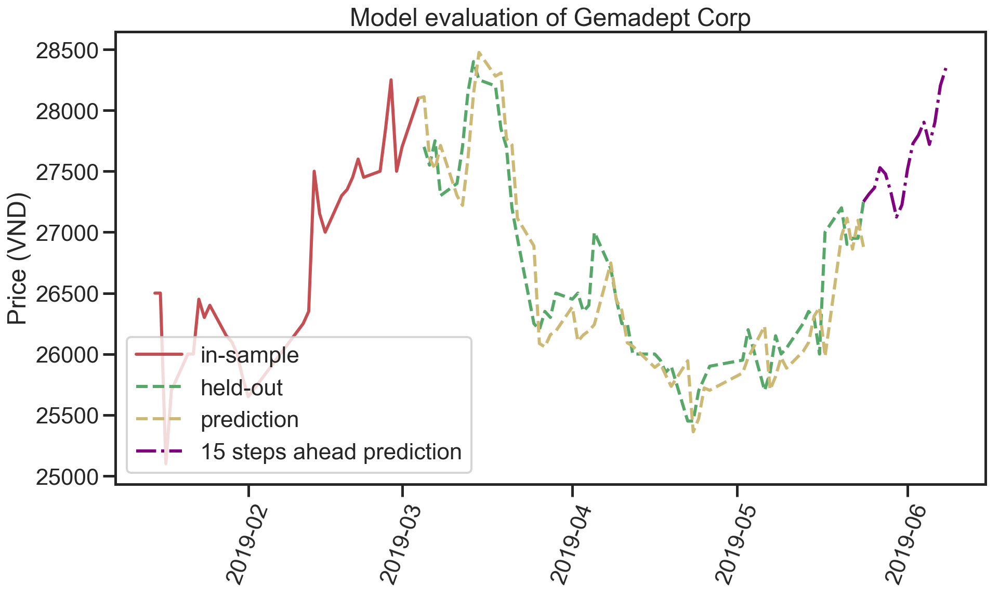

Ho Chi Minh City Infrastructure Investment JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 145071.33138358622, 'rmse': 380.8823064722044, 'mae': 298.9908811192599, 'mape': 1.2475605077309797}


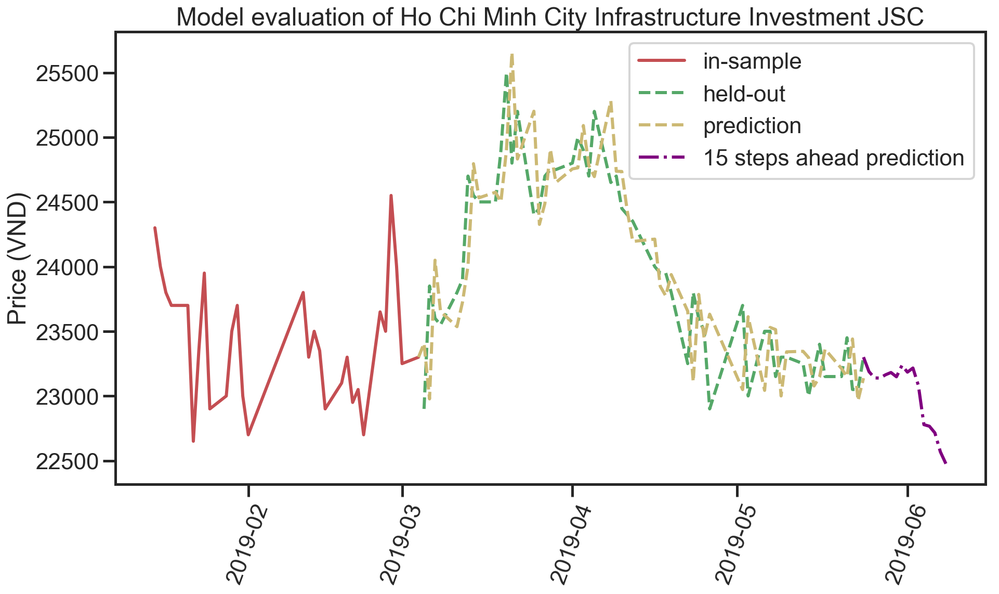

Ho Chi Minh City Development Joint Stock Commercial Bank
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 238822.54430607497, 'rmse': 488.6947352960486, 'mae': 399.5717123712213, 'mape': 1.4832740886786087}


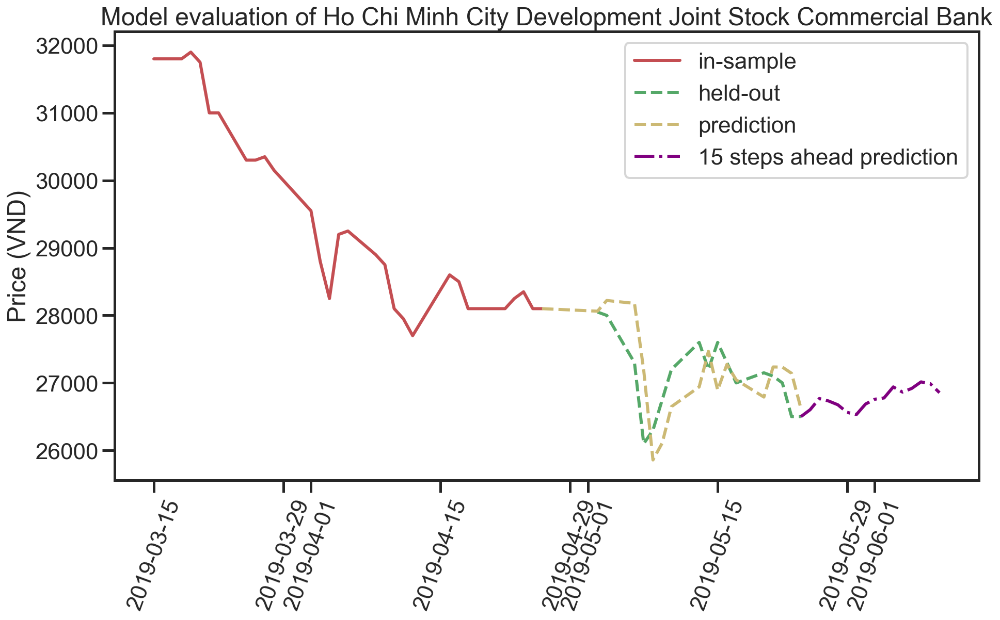

Hoa Phat Group JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 394850.3928832729, 'rmse': 628.371222195346, 'mae': 446.0447314315089, 'mape': 1.3658471478765597}


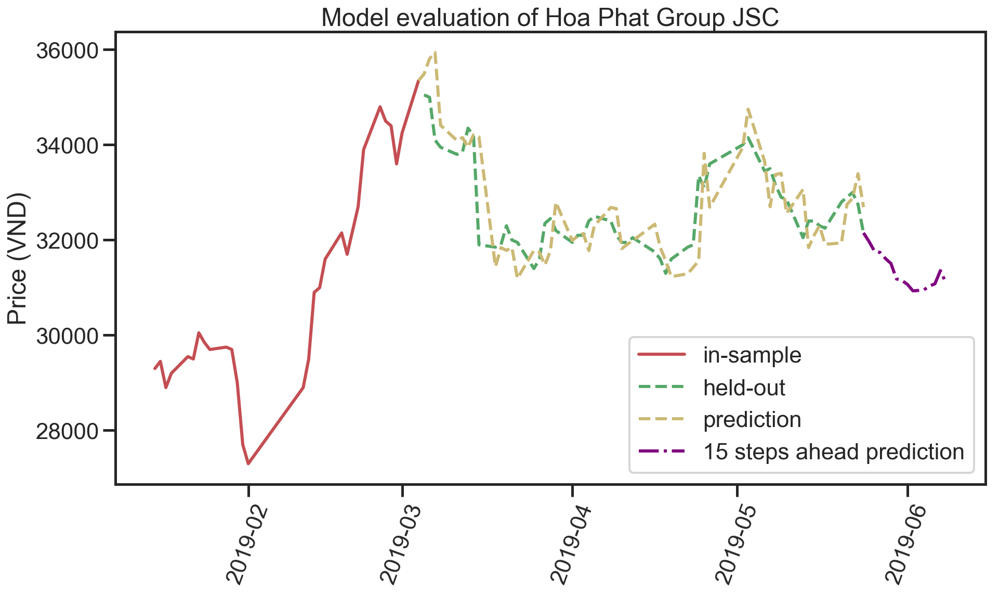

Masan Group Corp
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 1627801.6116473502, 'rmse': 1275.8532876656902, 'mae': 955.4892839640991, 'mape': 1.095410972816699}


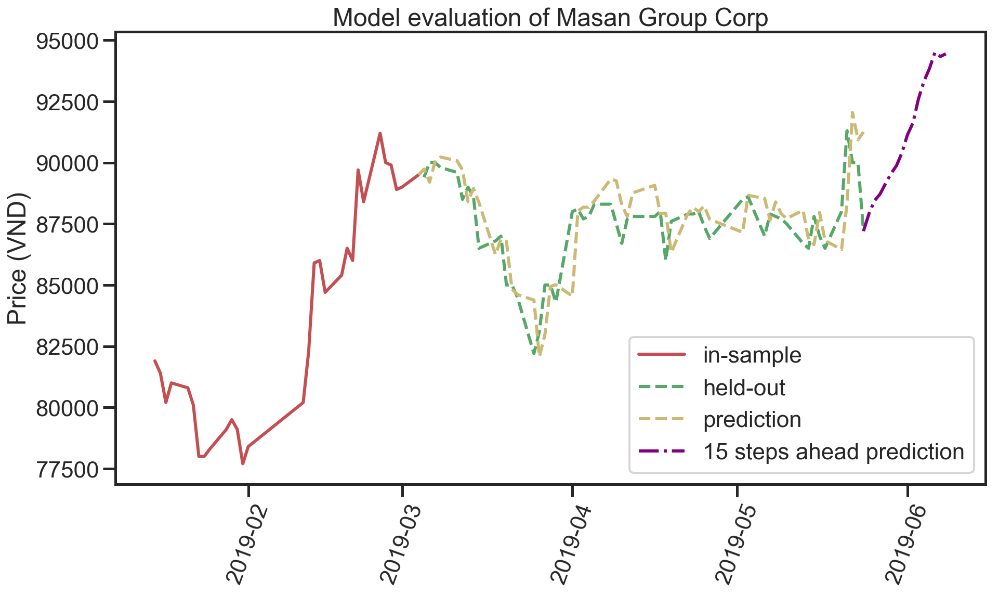

Military Commercial Joint Stock Bank
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 146612.16848812855, 'rmse': 382.8996846278782, 'mae': 270.600992169762, 'mape': 1.241403334126832}


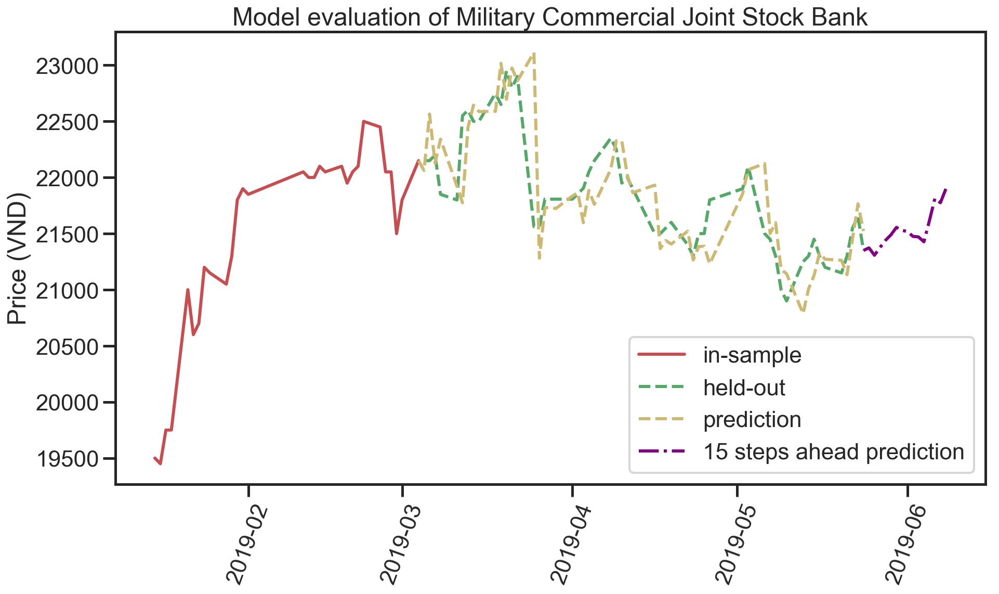

Mobile World Investment Corp
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 1072823.5202024502, 'rmse': 1035.7719441085717, 'mae': 729.839826183146, 'mape': 0.8581562133266751}


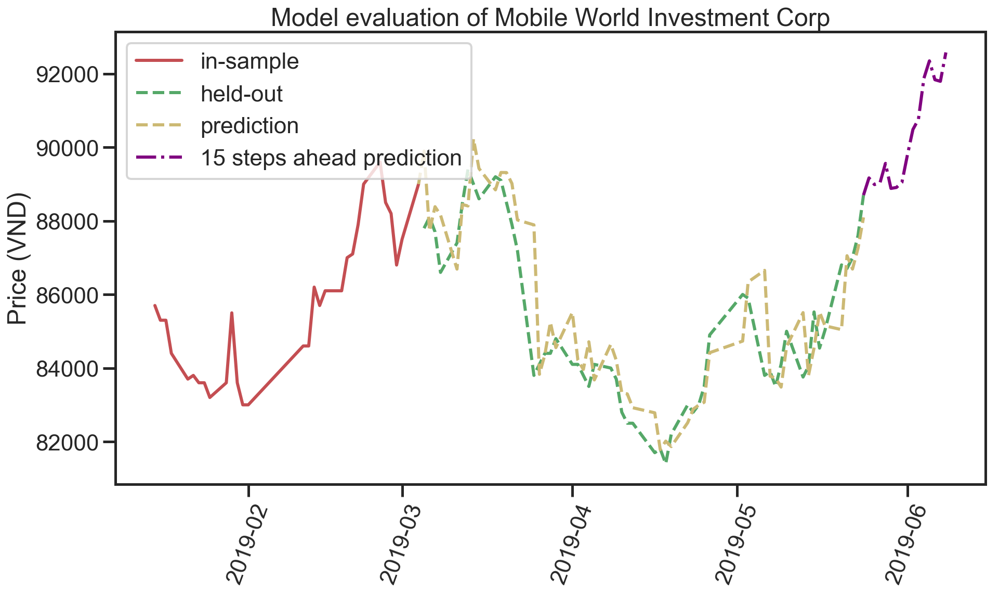

No Va Land Investment Group Corp
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 395918.8448065297, 'rmse': 629.2208235639772, 'mae': 482.54781490551613, 'mape': 0.8311673373207781}


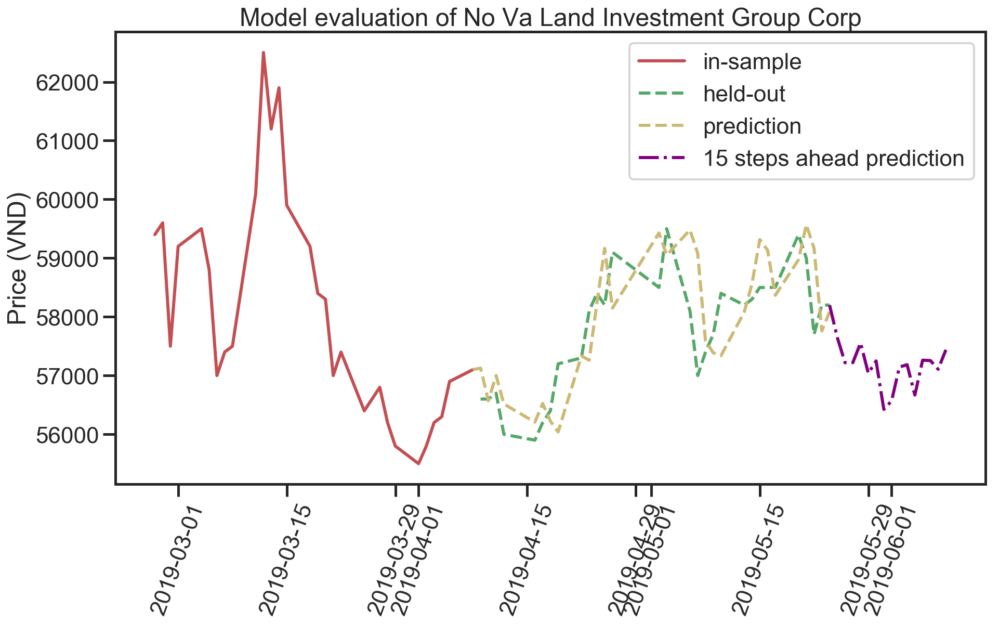

PetroVietnam Fertilizer and Chemicals Corp
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 102336.86420128755, 'rmse': 319.9013351039466, 'mae': 243.56041675971494, 'mape': 1.30665672122619}


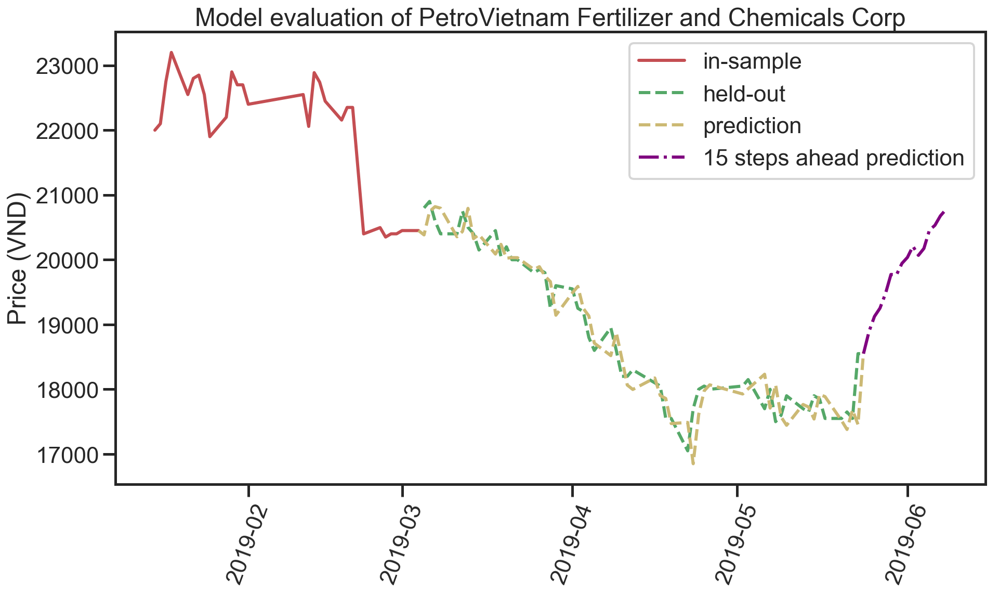

Phu Nhuan Jewelry JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 2062103.1234917121, 'rmse': 1436.0024803222702, 'mae': 1031.9929500973565, 'mape': 1.0097485274719948}


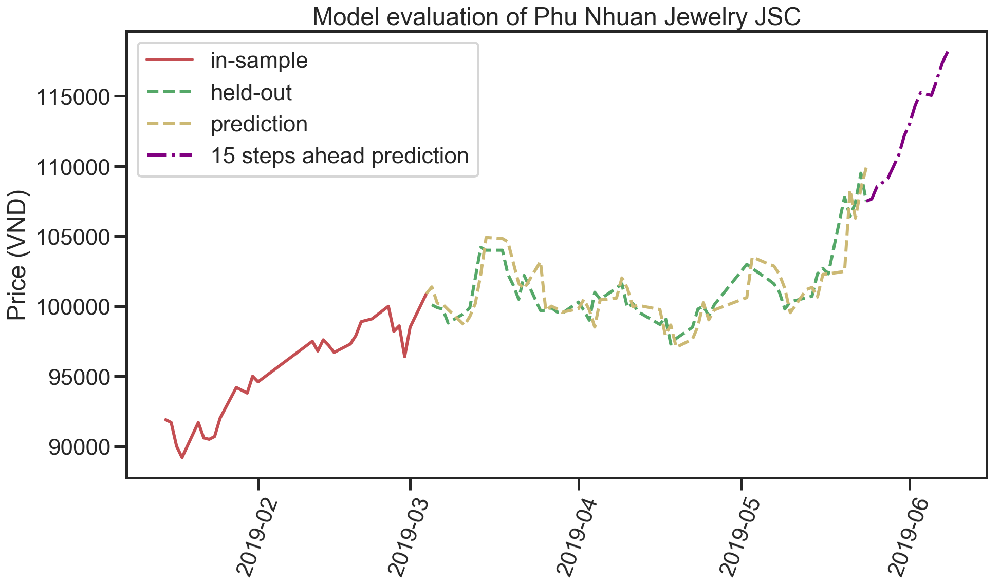

Refrigeration Electrical Engineering Corp
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 305990.1169253546, 'rmse': 553.1637342824948, 'mae': 435.330760697868, 'mape': 1.3359115370097718}


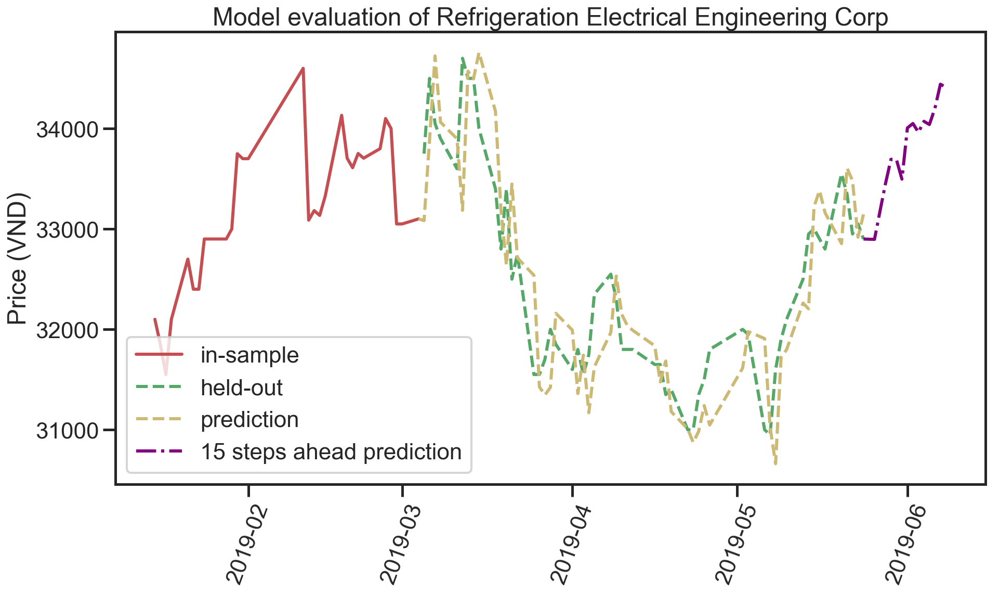

Sai Gon Thuong Tin Commercial Joint Stock Bank
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 26522.82804848854, 'rmse': 162.85830666100068, 'mae': 117.66494586645875, 'mape': 0.9623592461573056}


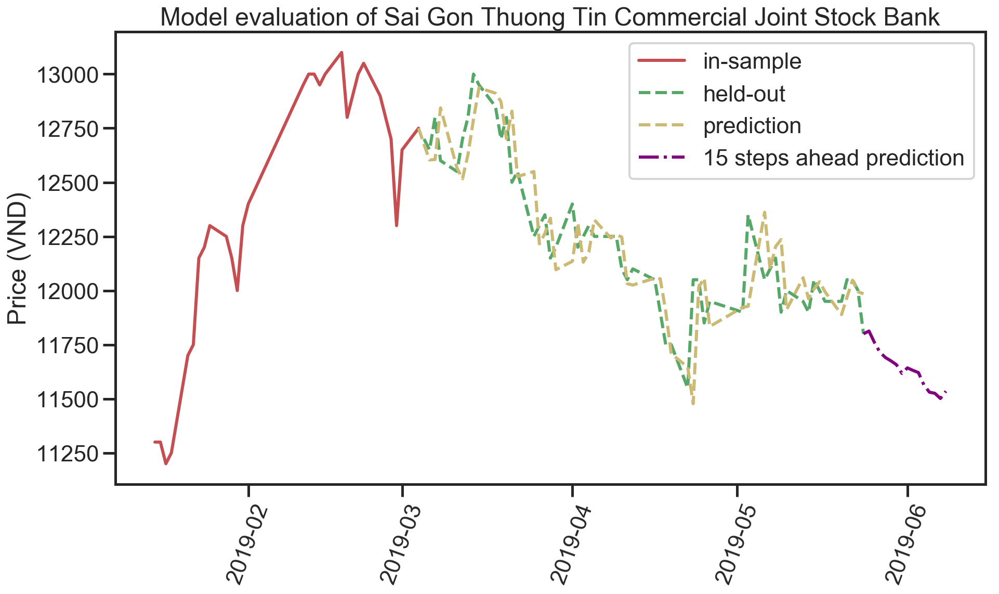

Saigon Beer Alcohol Beverage Corp
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 25657016.04588672, 'rmse': 5065.275515298918, 'mae': 3420.654988153782, 'mape': 1.3961726293385328}


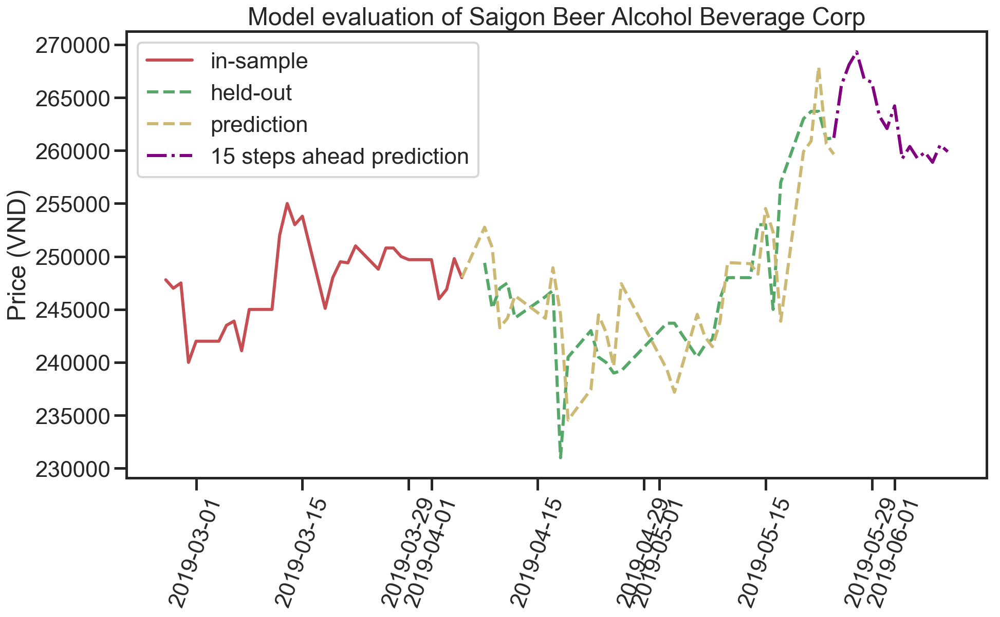

Saigon Securities Incorporation
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 149192.49151003666, 'rmse': 386.2544388224382, 'mae': 300.13770906389715, 'mape': 1.1216633383898347}


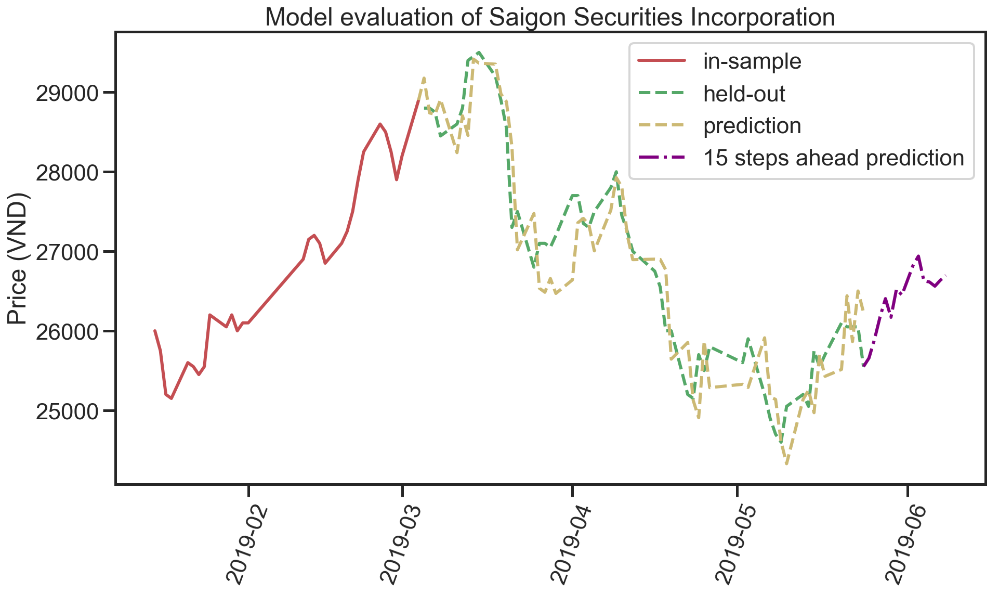

Vietnam Technological And Commercial Joint Stock Bank
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 130355.63952126456, 'rmse': 361.04797398858864, 'mae': 274.6966584702881, 'mape': 1.1721498109385775}


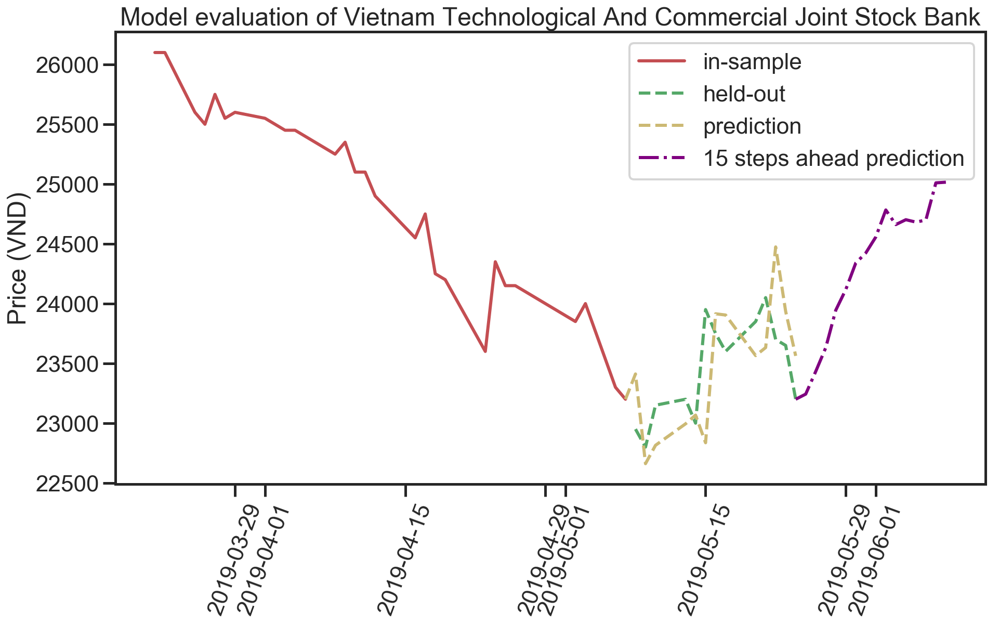

Thanh Thanh Cong Tay Ninh JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 48025.649301226425, 'rmse': 219.14755143789864, 'mae': 172.04519686008842, 'mape': 0.9330601464224884}


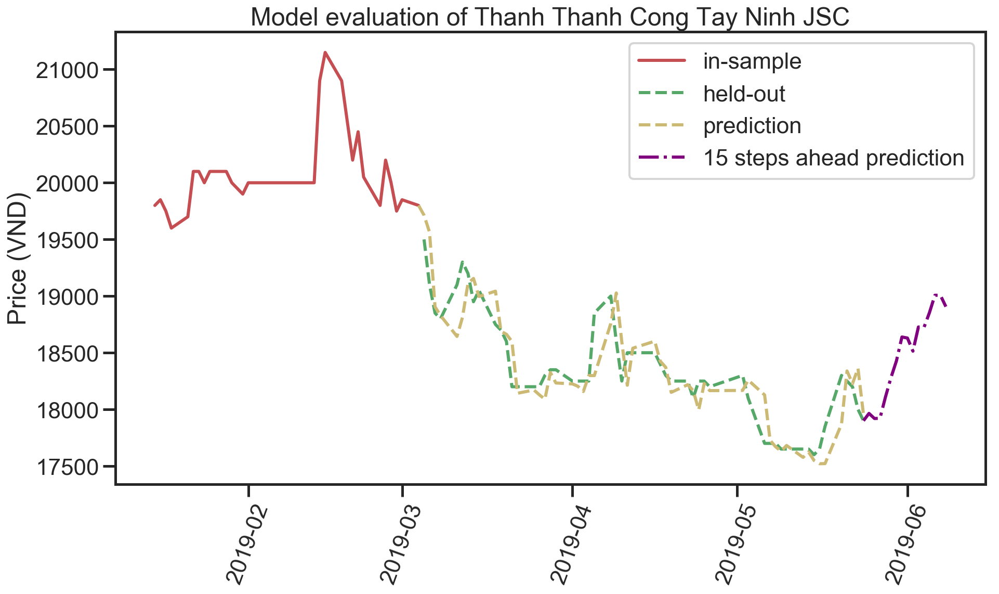

Joint Stock Commercial Bank for Foreign Trade of Vietnam
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 663757.6140380051, 'rmse': 814.7132096867002, 'mae': 617.6397496155219, 'mape': 0.9267196650612285}


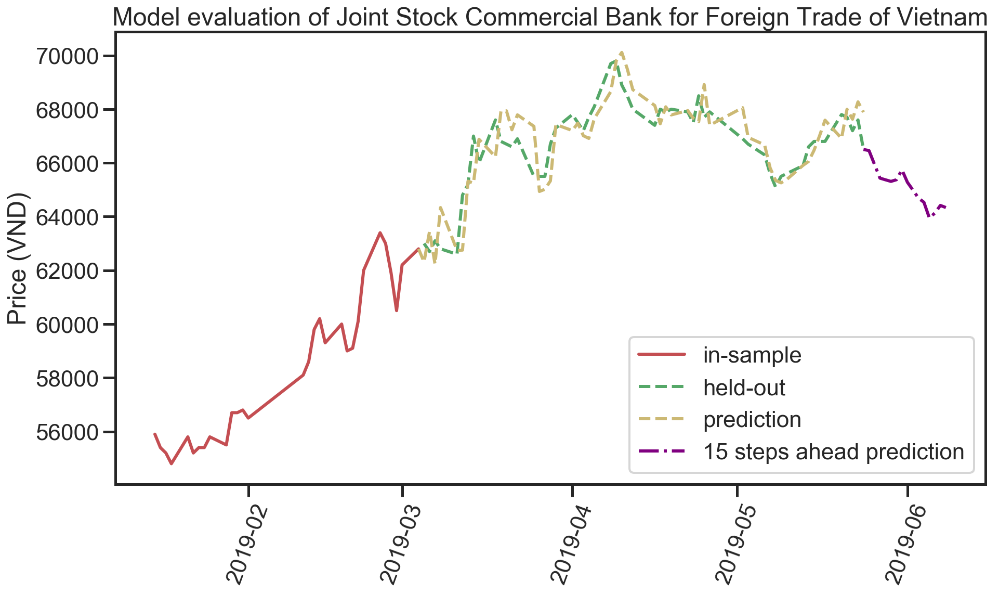

Vietjet Aviation JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 1207084.2939254136, 'rmse': 1098.6738796956145, 'mae': 806.1306267507955, 'mape': 0.6939400067677803}


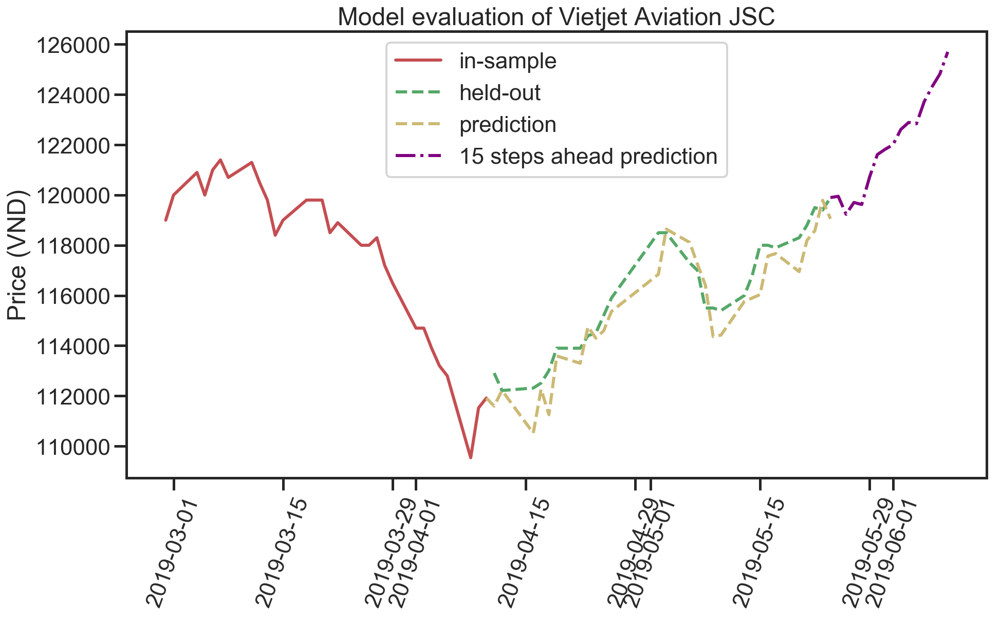

Vietnam Export Import Commercial Joint Stock Bank
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 138252.66265060162, 'rmse': 371.82342939976445, 'mae': 292.2807952836167, 'mape': 1.658946924419719}


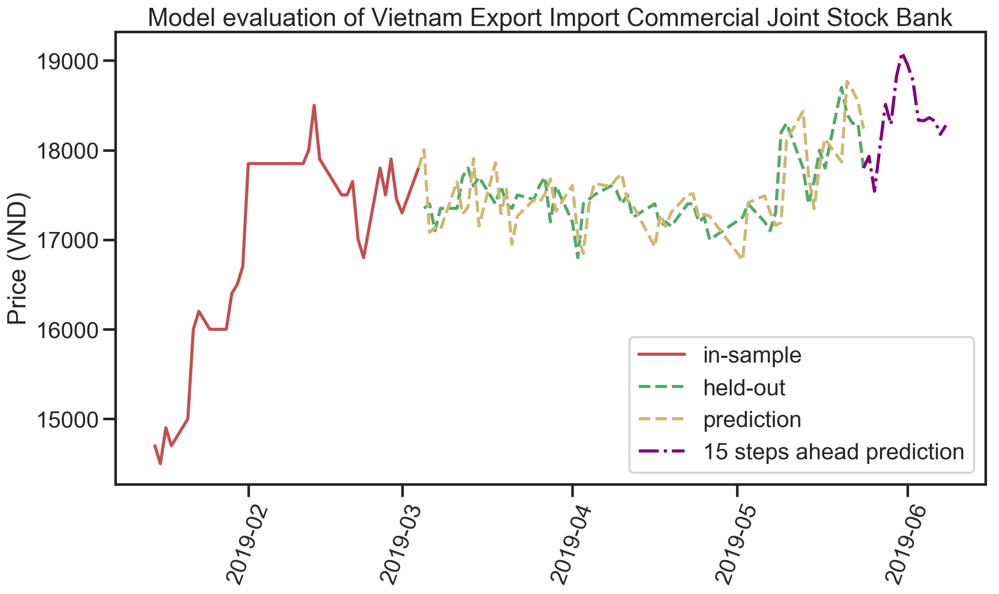

Vietnam JSCmmercial Bank for Industry and Trade
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 154276.08089053715, 'rmse': 392.7799395215305, 'mae': 302.09357702202396, 'mape': 1.3893966512478868}


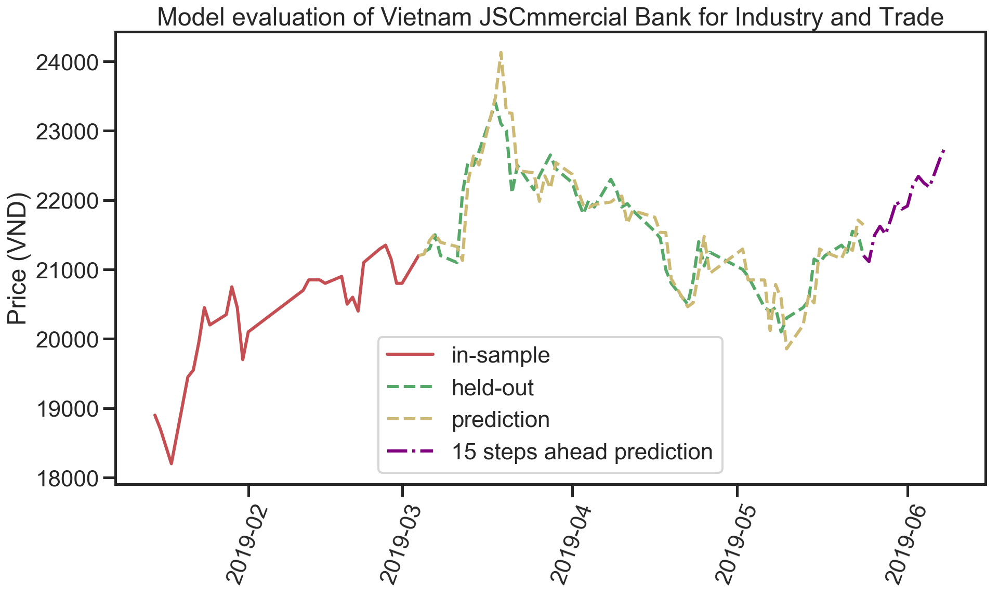

Vietnam Prosperity Joint Stock Commercial Bank
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 47097.358808371326, 'rmse': 217.01925907248722, 'mae': 169.75938166469197, 'mape': 0.9058858467350691}


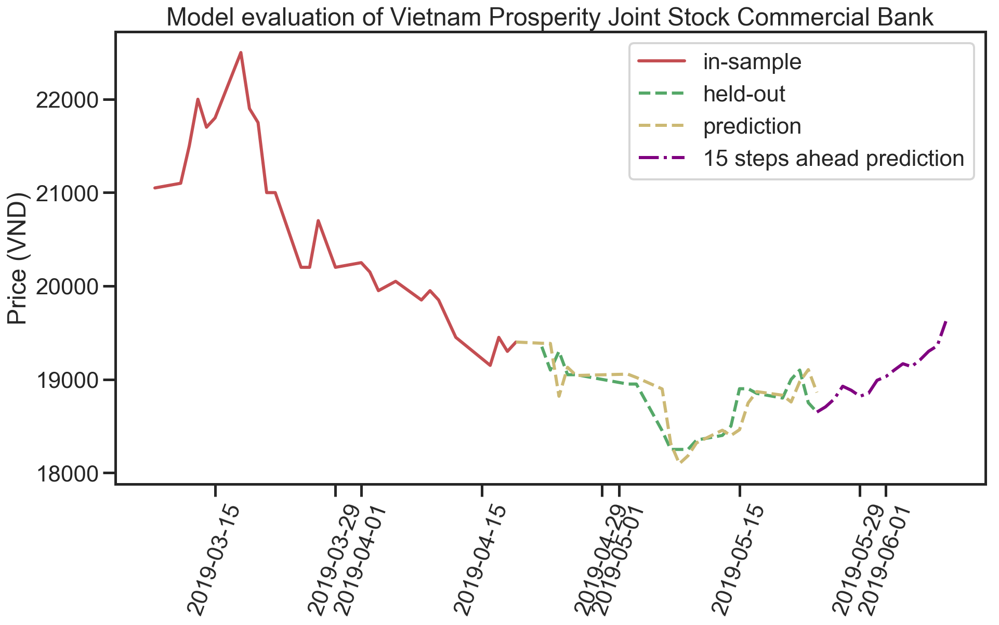

Vietnam Dairy Products JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 2660005.935510674, 'rmse': 1630.952462676541, 'mae': 1295.78650273946, 'mape': 0.9652746129323012}


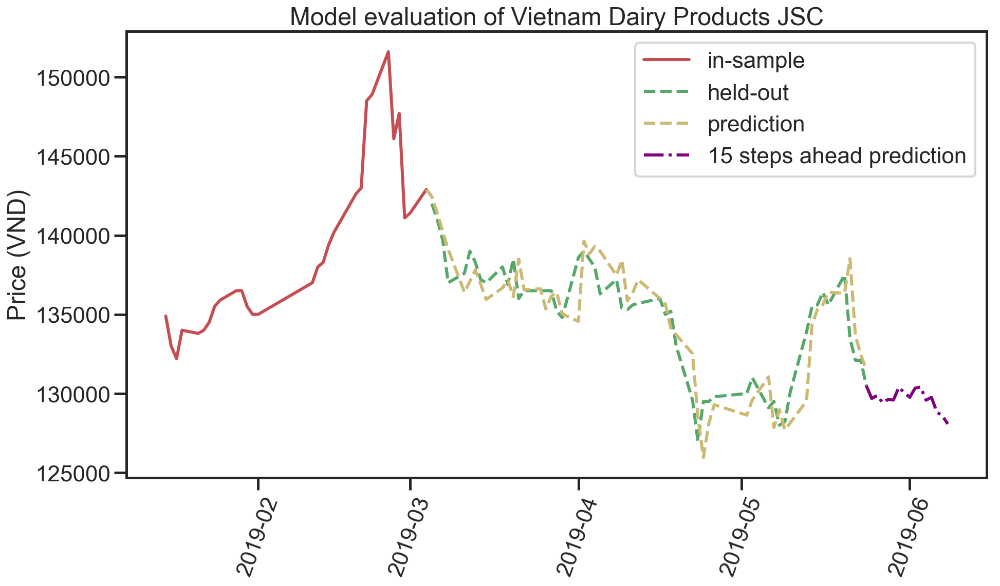

Vincom Retail JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 448996.6838997461, 'rmse': 670.072148279382, 'mae': 472.17504678823025, 'mape': 1.3474567698585211}


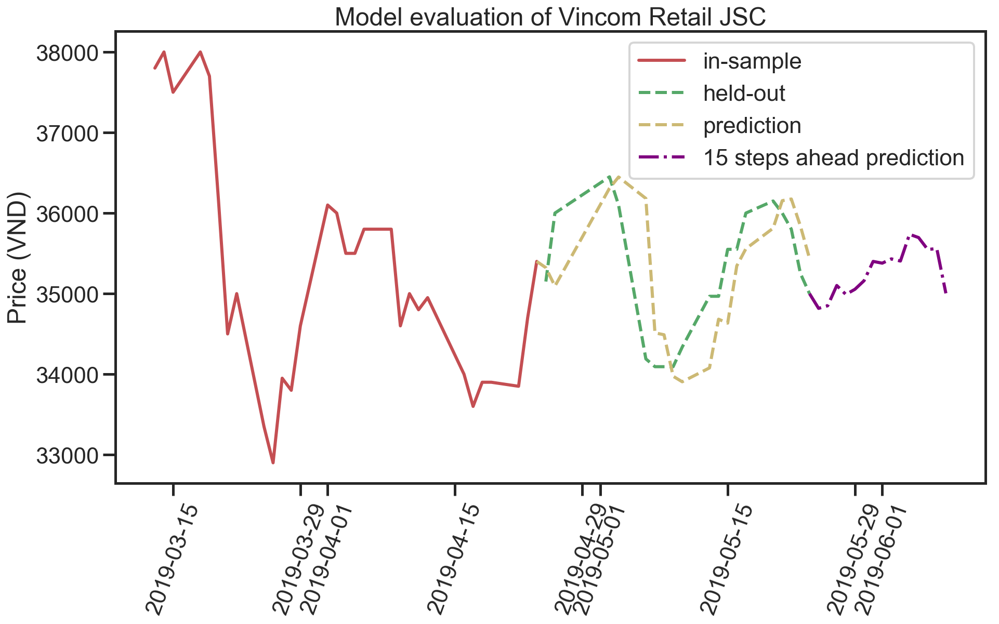

Vingroup JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 2072045.4812651519, 'rmse': 1439.4601353511503, 'mae': 1082.4069910674034, 'mape': 0.9400930795322534}


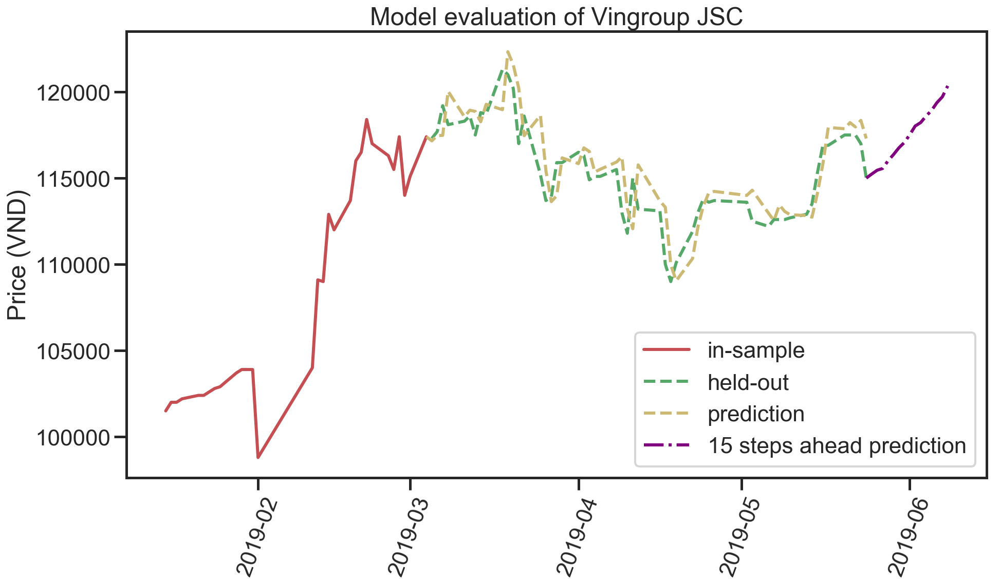

Vinhomes JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 1227431.5272285095, 'rmse': 1107.8950885478775, 'mae': 836.6024030118357, 'mape': 0.9783024518797118}


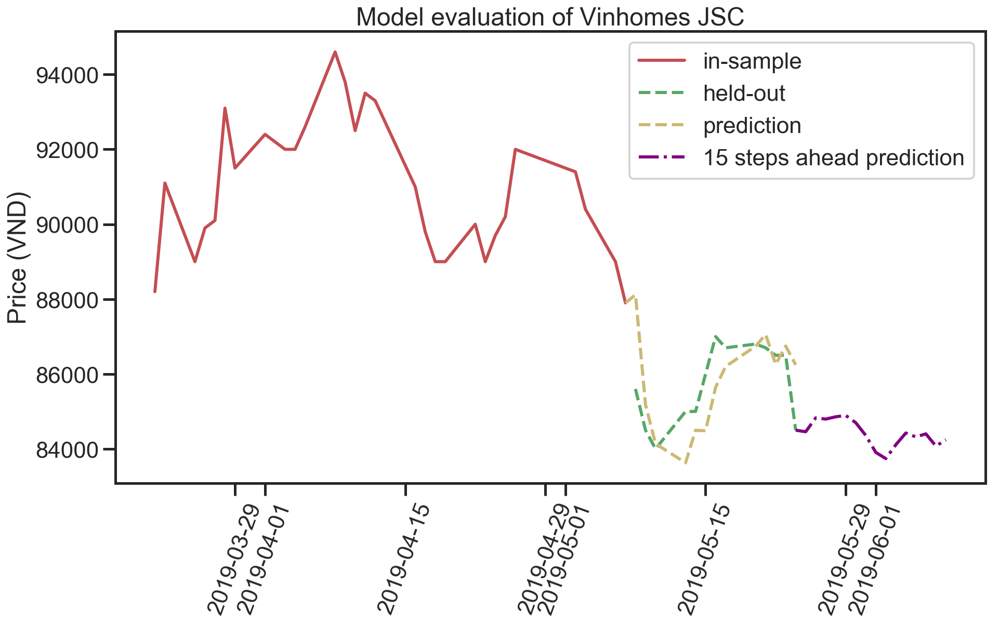

Petrovietnam Gas JSC
Run model LSTM
Training drift...
Done.
Training volatility...
Done.
Testing result: {'mse': 3613801.9940759665, 'rmse': 1901.0002614613093, 'mae': 1481.6191615323398, 'mape': 1.4016769311343031}


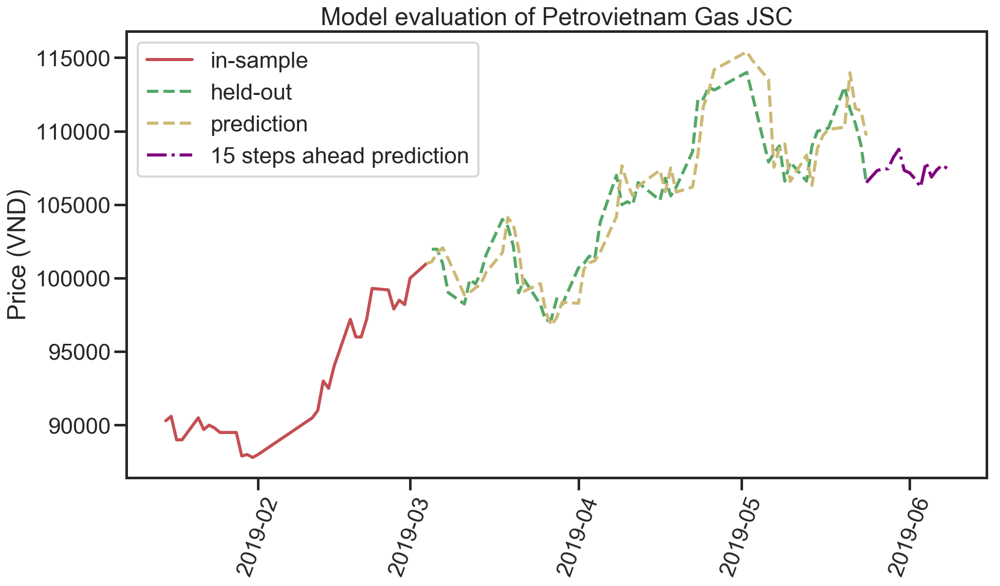

In [15]:
lst_lstm_gbm = list()
for ticket in lst_ticket:
    time_series = df[df.name == ticket]['close']
    # split data
    time_series = time_series.sort_index()
    size = len(time_series)
    train_start = int(start_train * size)
    train_end = int(end_train * size)
    train, test = time_series[train_start:train_end], time_series[train_end:]
    print(ticket)
    result = run_model_with_parameters(train, test, model_selection='LSTM_GBM', window_size=10, lag=10)
    if result['status']:
        validation = result['model'].validate(test)
        predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
        insample_prediction = result['model'].get_insample_prediction()
        time.sleep(1)
        
#         print('Training result:', result['train_evaluation'])
        print('Testing result:', result['test_evaluation'])
        
        lst_lstm_gbm.append({
        'name': ticket,
#         'order': result['order'],
#         'lags': result['lag'],
#         'hidden_layers': result['hidden_layers'],
        'result': result['test_evaluation']
    })
        
        fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
        ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
        ax1.plot(test, label='held-out', color='g', linestyle='--')
        ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
        ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
        plt.xticks(rotation=70)
        plt.ylabel('Price (VND)')
        plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
        plt.title('Model evaluation of ' + ticket)
        plt.show()
    else:
        print('None')

In [10]:
lst_hybrid = []
for ticket in lst_ticket:
    time_series = df[df.name == ticket]['close']
    
    # split data
    time_series = time_series.sort_index()
    size = len(time_series)
    train_start = int(start_train * size)
    train_end = int(end_train * size)
    train, test = time_series[train_start:train_end], time_series[train_end:]
    
    result, lst_result = run_model_without_parameters(train, test, model_selection='Hybrid', q=range(0, 4))
    print(ticket, ':', result['lag'], result['hidden_layers'], result['order'])
#     print('Training result:', result['train_evaluation'])
    print('Testing result:', result['test_evaluation'])
    lst_hybrid.append({
        'name': ticket,
        'order': result['order'],
        'lags': result['lag'],
        'hidden_layers': result['hidden_layers'],
        'result': result['test_evaluation']
    })
#     validation = result['model'].validate(test)
#     predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
#     fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
#     ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
#     ax1.plot(test, label='held-out', color='g', linestyle='--')
#     ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
#     ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
#     plt.xticks(rotation=70)
#     plt.ylabel('Price (VND)')
#     plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
#     plt.title('Model evaluation of ' + ticket)
#     plt.show()

non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Cotec Construction JSC : 2 (6, 1) (1, 0, 0)
Testing result: {'mse': 2594365.7792649195, 'rmse': 1610.7035044554038, 'mae': 1250.255716571205, 'mape': 1.0857401291899023}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


DHG Pharmaceutical JSC : 3 (3, 1) (1, 0, 0)
Testing result: {'mse': 2085306.7601250678, 'rmse': 1444.0591262566322, 'mae': 1161.3263895414568, 'mape': 1.016461672657397}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Faros Construction Corp : 2 (6, 1) (1, 0, 2)
Testing result: {'mse': 710653.4999963536, 'rmse': 843.0026690327579, 'mae': 528.3543182522885, 'mape': 1.6503027759123827}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


FPT Corp : 2 (7, 3) (1, 0, 1)
Testing result: {'mse': 275565.0359729505, 'rmse': 524.9428882963846, 'mae': 426.7789176057313, 'mape': 0.9664218262910036}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Gemadept Corp : 1 (4, 3) (2, 1, 0)
Testing result: {'mse': 107813.17413678378, 'rmse': 328.3491649704378, 'mae': 235.1895757034169, 'mape': 0.8946488462582848}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Ho Chi Minh City Infrastructure Investment JSC : 1 (3, 2) (3, 0, 0)
Testing result: {'mse': 55988.297356536146, 'rmse': 236.61846368476012, 'mae': 184.4768780257951, 'mape': 0.7928051637017234}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Ho Chi Minh City Development Joint Stock Commercial Bank : 1 (3, 1) (3, 0, 1)
Testing result: {'mse': 52639.14471381651, 'rmse': 229.43222248371416, 'mae': 167.432616374762, 'mape': 0.6237962809308775}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Hoa Phat Group JSC : 3 (3, 1) (3, 1, 2)
Testing result: {'mse': 117074.5280727777, 'rmse': 342.161552592891, 'mae': 231.4890961969901, 'mape': 0.9404329990241205}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Masan Group Corp : 2 (6, 1) (1, 1, 0)
Testing result: {'mse': 1207935.4950241589, 'rmse': 1099.0611880255617, 'mae': 830.7552614218162, 'mape': 0.9507660426790503}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Military Commercial Joint Stock Bank : 3 (7, 1) (1, 1, 2)
Testing result: {'mse': 41229.78505431611, 'rmse': 203.0511882612759, 'mae': 150.62620026423448, 'mape': 0.7101935881071844}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Mobile World Investment Corp : 3 (7, 1) (2, 1, 2)
Testing result: {'mse': 950358.1012727618, 'rmse': 974.8631192494472, 'mae': 746.0322351195933, 'mape': 0.8712856643106618}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


No Va Land Investment Group Corp : 1 (5, 1) (2, 1, 2)
Testing result: {'mse': 392490.59933079925, 'rmse': 626.4907017113655, 'mae': 425.1810414159155, 'mape': 0.7236857878668702}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


PetroVietnam Fertilizer and Chemicals Corp : 1 (7, 1) (2, 1, 3)
Testing result: {'mse': 88484.83226475057, 'rmse': 297.46400162834925, 'mae': 220.42183647444404, 'mape': 1.2394414673882914}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Phu Nhuan Jewelry JSC : 1 (4, 3) (3, 1, 0)
Testing result: {'mse': 1952683.0280561936, 'rmse': 1397.384352301182, 'mae': 1125.0699722711747, 'mape': 1.453316154437136}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Refrigeration Electrical Engineering Corp : 2 (7, 3) (3, 1, 1)
Testing result: {'mse': 132548.01497766672, 'rmse': 364.07144213418707, 'mae': 276.8673287255984, 'mape': 0.8625650109879618}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Sai Gon Thuong Tin Commercial Joint Stock Bank : 3 (3, 2) (2, 0, 2)
Testing result: {'mse': 22919.311871414375, 'rmse': 151.39125427650825, 'mae': 102.15507255436387, 'mape': 0.8556107518817703}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Saigon Beer Alcohol Beverage Corp : 3 (7, 3) (1, 0, 0)
Testing result: {'mse': 16879604.15357512, 'rmse': 4108.47954279623, 'mae': 2979.88533523328, 'mape': 1.1508040678577254}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Saigon Securities Incorporation : 3 (3, 1) (3, 0, 3)
Testing result: {'mse': 87860.18437933, 'rmse': 296.41218662418385, 'mae': 219.3231891614575, 'mape': 0.8616093288728697}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Vietnam Technological And Commercial Joint Stock Bank : 1 (3, 3) (1, 0, 0)
Testing result: {'mse': 117405.21267103813, 'rmse': 342.6444405955511, 'mae': 273.60851048560403, 'mape': 1.2576051941781057}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Thanh Thanh Cong Tay Ninh JSC : 3 (7, 1) (2, 0, 2)
Testing result: {'mse': 49757.1184665476, 'rmse': 223.06303697956685, 'mae': 135.61826752674597, 'mape': 0.7664442842024827}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Joint Stock Commercial Bank for Foreign Trade of Vietnam : 1 (6, 3) (2, 1, 2)
Testing result: {'mse': 460058.73917676596, 'rmse': 678.2763000258567, 'mae': 503.1931685331488, 'mape': 0.747926615948668}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Vietjet Aviation JSC : 3 (7, 3) (1, 0, 0)
Testing result: {'mse': 1593079.545816849, 'rmse': 1262.172549937943, 'mae': 841.0701438572357, 'mape': 0.692526781205239}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Vietnam Export Import Commercial Joint Stock Bank : 3 (3, 2) (3, 1, 1)
Testing result: {'mse': 131939.84596205177, 'rmse': 363.2352487879608, 'mae': 261.8710813260986, 'mape': 1.4505210197061333}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Vietnam JSCmmercial Bank for Industry and Trade : 1 (5, 1) (3, 0, 3)
Testing result: {'mse': 58378.33136636063, 'rmse': 241.61608259046133, 'mae': 189.71741085431765, 'mape': 0.9133072130744793}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Vietnam Prosperity Joint Stock Commercial Bank : 3 (7, 3) (1, 1, 2)
Testing result: {'mse': 32742.38375301667, 'rmse': 180.94856659563973, 'mae': 138.16345458741014, 'mape': 0.7465921733102976}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Vietnam Dairy Products JSC : 3 (3, 1) (2, 0, 3)
Testing result: {'mse': 2654217.289584714, 'rmse': 1629.1768748618776, 'mae': 1223.7984832456846, 'mape': 0.9376927189668522}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Vincom Retail JSC : 1 (6, 1) (3, 1, 3)
Testing result: {'mse': 114372.64251127192, 'rmse': 338.190246032129, 'mae': 262.7295696258792, 'mape': 0.7532119568066806}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Vingroup JSC : 1 (6, 3) (1, 0, 0)
Testing result: {'mse': 1184842.0543376238, 'rmse': 1088.504503590878, 'mae': 768.6749930328695, 'mape': 0.6745748546119009}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Vinhomes JSC : 1 (5, 3) (1, 0, 0)
Testing result: {'mse': 792117.0827642126, 'rmse': 890.0095970068035, 'mae': 588.5869956972654, 'mape': 0.7219593791949955}


non-invertible starting MA parameters found with `enforce_invertibility` set to True.
non-invertible starting MA parameters found with `enforce_invertibility` set to True.


Petrovietnam Gas JSC : 1 (5, 1) (1, 1, 1)
Testing result: {'mse': 3872026.3184699435, 'rmse': 1967.7465076757076, 'mae': 1418.8417944950272, 'mape': 1.3311374944831054}


In [11]:
df_result = pd.DataFrame(data=lst_hybrid)
df_result.to_csv('model_selection_hybrid.csv')
df_result.head(30)

,hidden_layers,lags,name,order,result
0,"(6, 1)",2,Cotec Construction JSC,"(1, 0, 0)","{'mse': 2594365.7792649195, 'rmse': 1610.70350..."
1,"(3, 1)",3,DHG Pharmaceutical JSC,"(1, 0, 0)","{'mse': 2085306.7601250678, 'rmse': 1444.05912..."
2,"(6, 1)",2,Faros Construction Corp,"(1, 0, 2)","{'mse': 710653.4999963536, 'rmse': 843.0026690..."
3,"(7, 3)",2,FPT Corp,"(1, 0, 1)","{'mse': 275565.0359729505, 'rmse': 524.9428882..."
4,"(4, 3)",1,Gemadept Corp,"(2, 1, 0)","{'mse': 107813.17413678378, 'rmse': 328.349164..."
5,"(3, 2)",1,Ho Chi Minh City Infrastructure Investment JSC,"(3, 0, 0)","{'mse': 55988.297356536146, 'rmse': 236.618463..."
6,"(3, 1)",1,Ho Chi Minh City Development Joint Stock Comme...,"(3, 0, 1)","{'mse': 52639.14471381651, 'rmse': 229.4322224..."
7,"(3, 1)",3,Hoa Phat Group JSC,"(3, 1, 2)","{'mse': 117074.5280727777, 'rmse': 342.1615525..."
8,"(6, 1)",2,Masan Group Corp,"(1, 1, 0)","{'mse': 1207935.4950241589, 'rmse': 1099.06118..."
9,"(7, 1)",3,Military Commercial Joint Stock Bank,"(1, 1, 2)","{'mse': 41229.78505431611, 'rmse': 203.0511882..."


In [17]:
df_mae = pd.DataFrame(index=lst_ticket)
df_mae['hybrid_order'] = [item['order'] for item in lst_hybrid]
df_mae['hybrid_lags'] = [item['lags'] for item in lst_hybrid]
df_mae['hybrid_hl'] = [item['hidden_layers'] for item in lst_hybrid]
df_mae['hybrid'] = [item['result']['mae'] for item in lst_hybrid]

df_mae['arima_order'] = [item['order'] for item in lst_arima]
df_mae['arima'] = [item['result']['mae'] for item in lst_arima]

df_mae['ann_lags'] = [item['lags'] for item in lst_ann]
df_mae['ann_hl'] = [item['hidden_layers'] for item in lst_ann]
df_mae['ann'] = [item['result']['mae'] for item in lst_ann]

df_mae['lstm_gbm'] = [item['result']['mae'] for item in lst_lstm_gbm]

df_mae['gbm'] = [item['result']['mae'] for item in lst_gbm]
df_mae.to_csv('mae.csv')
df_mae

,hybrid_order,hybrid_lags,hybrid_hl,hybrid,arima_order,arima,ann_lags,ann_hl,ann,lstm_gbm,gbm
Cotec Construction JSC,"(1, 0, 0)",2,"(5, 2)",1539.87592,"(1, 0, 0)",1566.10771,1,"(7, 3)",2189.91708,1993.15358,2083.47789
DHG Pharmaceutical JSC,"(1, 0, 0)",1,"(4, 2)",828.83069,"(1, 0, 0)",842.90478,1,"(6, 3)",826.61465,1247.94095,1131.67465
Faros Construction Corp,"(1, 0, 0)",2,"(3, 2)",554.81158,"(1, 0, 0)",487.39248,1,"(4, 3)",495.38750,548.41992,566.43586
FPT Corp,"(2, 1, 3)",1,"(5, 1)",372.12604,"(2, 1, 3)",374.88086,2,"(7, 3)",491.98339,495.30598,509.06203
Gemadept Corp,"(3, 0, 1)",1,"(4, 3)",257.47524,"(3, 0, 1)",213.70672,2,"(5, 1)",235.37330,255.01121,264.59097
Ho Chi Minh City Infrastructure Investment JSC,"(3, 1, 1)",2,"(6, 1)",272.13356,"(3, 1, 1)",264.89355,2,"(7, 3)",238.76999,298.99088,378.03052
Ho Chi Minh City Development Joint Stock Commercial Bank,"(3, 0, 3)",1,"(6, 1)",336.94210,"(3, 0, 3)",323.15049,1,"(6, 3)",318.13141,399.57171,448.07781
Hoa Phat Group JSC,"(2, 0, 3)",1,"(7, 1)",313.74105,"(2, 0, 3)",306.05785,2,"(5, 1)",336.75635,446.04473,369.64341
Masan Group Corp,"(1, 1, 0)",2,"(6, 1)",939.04766,"(1, 1, 0)",799.79158,1,"(6, 3)",797.28407,955.48928,1103.74238
Military Commercial Joint Stock Bank,"(1, 0, 0)",3,"(7, 1)",176.12078,"(1, 0, 0)",171.18171,1,"(7, 3)",180.78613,270.60099,225.45073


In [18]:
df_mse = pd.DataFrame(index=lst_ticket)
df_mse['hybrid_order'] = [item['order'] for item in lst_hybrid]
df_mse['hybrid_lags'] = [item['lags'] for item in lst_hybrid]
df_mse['hybrid_hl'] = [item['hidden_layers'] for item in lst_hybrid]
df_mse['hybrid'] = [item['result']['mse'] for item in lst_hybrid]

df_mse['arima_order'] = [item['order'] for item in lst_arima]
df_mse['arima'] = [item['result']['mse'] for item in lst_arima]

df_mse['ann_lags'] = [item['lags'] for item in lst_ann]
df_mse['ann_hl'] = [item['hidden_layers'] for item in lst_ann]
df_mse['ann'] = [item['result']['mse'] for item in lst_ann]

df_mse['lstm_gbm'] = [item['result']['mse'] for item in lst_lstm_gbm]

df_mse['gbm'] = [item['result']['mse'] for item in lst_gbm]

df_mse.to_csv('mse.csv')

In [19]:
df_rmse = pd.DataFrame(index=lst_ticket)
df_rmse['hybrid_order'] = [item['order'] for item in lst_hybrid]
df_rmse['hybrid_lags'] = [item['lags'] for item in lst_hybrid]
df_rmse['hybrid_hl'] = [item['hidden_layers'] for item in lst_hybrid]
df_rmse['hybrid'] = [item['result']['rmse'] for item in lst_hybrid]

df_rmse['arima_order'] = [item['order'] for item in lst_arima]
df_rmse['arima'] = [item['result']['rmse'] for item in lst_arima]

df_rmse['ann_lags'] = [item['lags'] for item in lst_ann]
df_rmse['ann_hl'] = [item['hidden_layers'] for item in lst_ann]
df_rmse['ann'] = [item['result']['rmse'] for item in lst_ann]

df_rmse['lstm_gbm'] = [item['result']['rmse'] for item in lst_lstm_gbm]

df_rmse['gbm'] = [item['result']['rmse'] for item in lst_gbm]

df_rmse.to_csv('rmse.csv')

In [20]:
df_mape = pd.DataFrame(index=lst_ticket)
df_mape['hybrid_order'] = [item['order'] for item in lst_hybrid]
df_mape['hybrid_lags'] = [item['lags'] for item in lst_hybrid]
df_mape['hybrid_hl'] = [item['hidden_layers'] for item in lst_hybrid]
df_mape['hybrid'] = [item['result']['mape'] for item in lst_hybrid]

df_mape['arima_order'] = [item['order'] for item in lst_arima]
df_mape['arima'] = [item['result']['mape'] for item in lst_arima]

df_mape['ann_lags'] = [item['lags'] for item in lst_ann]
df_mape['ann_hl'] = [item['hidden_layers'] for item in lst_ann]
df_mape['ann'] = [item['result']['mape'] for item in lst_ann]

df_mape['lstm_gbm'] = [item['result']['mape'] for item in lst_lstm_gbm]

df_mape['gbm'] = [item['result']['mape'] for item in lst_gbm]

df_mape.to_csv('mape.csv')